In [1]:
import numpy as np
import pandas as pd
from numpy import nan
import matplotlib.pyplot as plt
import seaborn as sns

%matplotlib inline

In [2]:
data_df_1 = pd.read_csv("D:/Datasets/PHME21/training_validation_1.csv")
data_df_2 = pd.read_csv("D:/Datasets/PHME21/training_validation_2.csv")
data_df = pd.concat([data_df_1, data_df_2], axis=0) # Merge data frames
data_path = "D:/Datasets/PHME21/data_analysis"

In [3]:
fields_path = 'D:/Datasets/PHME21/training_validation_2/fields.csv'
fields_df = pd.read_csv(fields_path)
fields_df.columns = ['name', 'f0', 'f1', 'f2', 'f3', 'f4', 'f5', 'f6']

fields_dict = {}

for idx in range(fields_df.shape[0]):
    name = fields_df.loc[idx, 'name']

    _fields = []

    for f in fields_df.columns[1:]:
        if not (str(fields_df.loc[idx, f]) == 'nan'):
            _fields.append(name + "_" + str(fields_df.loc[idx, f]))

    fields_dict[idx] = {'name': fields_df.loc[idx, 'name'], 'fields': _fields}

print( fields_df.shape[0], fields_df['name'].tolist())

50 ['CpuTemperature', 'DurationPickToPick', 'DurationRobotFromFeederToTestBench', 'DurationRobotFromTestBenchToFeeder', 'DurationTestBenchClosed', 'EPOSCurrent', 'EPOSPosition', 'EPOSVelocity', 'ErrorFrame', 'FeederAction1', 'FeederAction2', 'FeederAction3', 'FeederAction4', 'FeederBackgroundIlluminationIntensity', 'FuseCycleDuration', 'FuseHeatSlope', 'FuseHeatSlopeNOK', 'FuseHeatSlopeOK', 'FuseIntoFeeder', 'FuseOutsideOperationalSpace', 'FusePicked', 'FuseTestResult', 'Humidity', 'IntensityTotalImage', 'IntensityTotalThermoImage', 'LightBarrieActiveTaskDuration2', 'LightBarrierActiveTaskDuration1', 'LightBarrierActiveTaskDuration1b', 'LightBarrierPassiveTaskDuration1', 'LightBarrierPassiveTaskDuration1b', 'LightBarrierPassiveTaskDuration2', 'LightBarrierTaskDuration', 'NumberEmptyFeeder', 'NumberFuseDetected', 'NumberFuseEstimated', 'Pressure', 'ProcessCpuLoadNormalized', 'ProcessMemoryConsumption', 'SharpnessImage', 'SmartMotorPositionError', 'SmartMotorSpeed', 'Temperature', 'Tempe

In [4]:
feature_set1 = ['CpuTemperature', 'DurationPickToPick', 'DurationRobotFromFeederToTestBench', 
                'DurationRobotFromTestBenchToFeeder', 'DurationTestBenchClosed', 'EPOSCurrent', 
                'EPOSPosition', 'EPOSVelocity', 'ErrorFrame', 'FeederAction1', 
                'FeederAction2', 'FeederAction3', 'FeederAction4']

In [5]:
feature_set2 = ['FeederBackgroundIlluminationIntensity', "FuseCycleDuration", "FuseHeatSlope", "FuseHeatSlopeNOK", 
                "FuseHeatSlopeOK", "FuseIntoFeeder", "FuseOutsideOperationalSpace", "FusePicked", "FuseTestResult",
               "Humidity", "IntensityTotalImage", "IntensityTotalThermoImage",
               "LightBarrieActiveTaskDuration2", "LightBarrierActiveTaskDuration1", 
               "LightBarrierActiveTaskDuration1b", 'LightBarrierPassiveTaskDuration1', 'LightBarrierPassiveTaskDuration1b', 
                'LightBarrierPassiveTaskDuration2', 'LightBarrierTaskDuration']

In [6]:
feature_set3 = ['NumberEmptyFeeder', 
                'NumberFuseDetected', 'NumberFuseEstimated', 'Pressure', 'ProcessCpuLoadNormalized', 'ProcessMemoryConsumption', 'SharpnessImage', 
                'SmartMotorPositionError', 'SmartMotorSpeed', 'Temperature', 'TemperatureThermoCam', 
                'TotalCpuLoadNormalized', 'TotalMemoryConsumption', 'Vacuum', 'VacuumFusePicked', 
                'VacuumValveClosed', 'ValidFrame', 'ValidFrameOptrisPIIRCamera']

In [7]:
feature_set1_all = list(filter(lambda x: x.startswith(tuple(feature_set1)), data_df.columns))

In [8]:
df = data_df[["class", "run"] + feature_set1_all]
df.head()

,class,run,CpuTemperature_vMax,CpuTemperature_vMin,CpuTemperature_vStd,CpuTemperature_value,DurationPickToPick_vCnt,DurationPickToPick_vFreq,DurationPickToPick_vMax,DurationPickToPick_vMin,...,EPOSVelocity_vMin,EPOSVelocity_vStd,EPOSVelocity_vTrend,EPOSVelocity_value,ErrorFrame_vCnt,ErrorFrame_vFreq,FeederAction1_vCnt,FeederAction2_vCnt,FeederAction3_vCnt,FeederAction4_vCnt
0,0,0,56.75,44.75,3.523729,47.833333,0,0.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,0.0,0,0,0,0
1,0,0,48.75,42.25,2.395308,45.000000,2,0.198207,3.192,2.807,...,-1193.0,249.585923,1.578674,24.157895,0.0,0.0,0,1,0,0
2,0,0,47.50,42.00,2.085815,43.825000,3,0.296778,3.230,3.106,...,-1185.0,391.256574,2.089132,-15.368421,0.0,0.0,0,0,0,0
3,0,0,48.25,42.25,1.853375,45.200000,3,0.298541,3.307,3.103,...,-1359.0,452.439066,-1.427218,-39.750000,0.0,0.0,0,0,0,0
4,0,0,50.00,42.50,2.661766,45.700000,3,0.298554,3.242,3.153,...,-1344.0,456.054556,-2.290581,28.710526,0.0,0.0,0,0,0,0


In [9]:
def get_nan_info_table(data, fields):
    
    class_ = data["class"].iloc[0]
    run_ = data["run"].iloc[0]
    field_df = data[fields]
    # print(field_df.isnull().sum())
    
    return field_df.isnull().sum().T

In [10]:
nan_info1_table = df.groupby(["class", "run"]).apply(get_nan_info_table, feature_set1_all)
# nan_info1_table

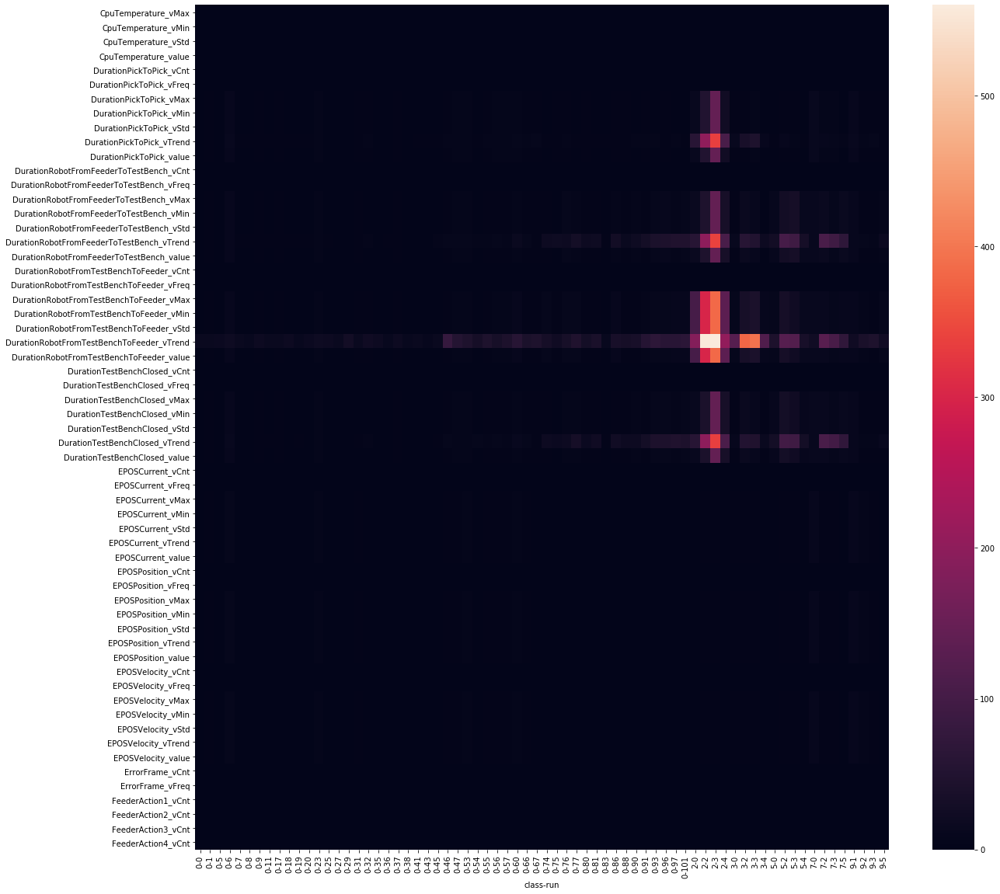

In [11]:
# nan_info1_table = nan_info1_table.reset_index(["run"]).reset_index(drop=True).set_index("run")
# nan_info1_table

plt.figure (figsize=(20, 20))
sns.heatmap(nan_info1_table.T, annot=False)

In [12]:
nan_info1_table.style.background_gradient(cmap='Blues')

In [13]:
df_ori = df.copy(deep=True)

In [14]:
df_ori.shape

(39611, 61)

In [15]:
df = df_ori.copy()
df = df.dropna(thresh=int(df.shape[0] * 0.7), axis=1)  # Drop column if it does not have at least x values that are **not** NaN
print("col: ", df.shape)

col:  (39611, 61)


In [16]:
removed_features_1 = list(set(df_ori.columns).difference(df.columns))
print(removed_features_1)

[]


In [17]:
df_remain = df.copy(deep=True)

In [18]:
for column in df.columns:
    if column not in ["class", "run"]:
        if (len(df[column].unique()) == 1) or (df[column].isnull().all()):
            df.drop(column, inplace=True, axis=1)
            # print(column, "droped-unique")

        else:
            zero_rows = df.loc[df[column] == float(0)]
            if zero_rows.shape[0] >= df.shape[0] * 50:
                df.drop(column, inplace=True, axis=1)
                # print(column, "droped-zero")

In [21]:
removed_features_2 = list(set(df_remain.columns).difference(df.columns))
print(removed_features_2)

[]


In [22]:
remain_features_set1 = list(set(feature_set1_all).difference(removed_features_1 + removed_features_2))
remain_base_features_set1 = list(set([col.split('_')[0] for col in remain_features_set1]))

len(remain_base_features_set1), len(remain_features_set1), np.array(remain_base_features_set1), 

(13, 59, array(['FeederAction3', 'FeederAction2',
        'DurationRobotFromFeederToTestBench', 'FeederAction1',
        'DurationRobotFromTestBenchToFeeder', 'ErrorFrame', 'EPOSVelocity',
        'EPOSPosition', 'EPOSCurrent', 'DurationPickToPick',
        'DurationTestBenchClosed', 'CpuTemperature', 'FeederAction4'],
       dtype='<U34'))

In [23]:
df

,class,run,CpuTemperature_vMax,CpuTemperature_vMin,CpuTemperature_vStd,CpuTemperature_value,DurationPickToPick_vCnt,DurationPickToPick_vFreq,DurationPickToPick_vMax,DurationPickToPick_vMin,...,EPOSVelocity_vMin,EPOSVelocity_vStd,EPOSVelocity_vTrend,EPOSVelocity_value,ErrorFrame_vCnt,ErrorFrame_vFreq,FeederAction1_vCnt,FeederAction2_vCnt,FeederAction3_vCnt,FeederAction4_vCnt
0,0,0,56.75,44.75,3.523729,47.833333,0,0.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,0.0,0,0,0,0
1,0,0,48.75,42.25,2.395308,45.000000,2,0.198207,3.192,2.807,...,-1193.0,249.585923,1.578674,24.157895,0.0,0.0,0,1,0,0
2,0,0,47.50,42.00,2.085815,43.825000,3,0.296778,3.230,3.106,...,-1185.0,391.256574,2.089132,-15.368421,0.0,0.0,0,0,0,0
3,0,0,48.25,42.25,1.853375,45.200000,3,0.298541,3.307,3.103,...,-1359.0,452.439066,-1.427218,-39.750000,0.0,0.0,0,0,0,0
4,0,0,50.00,42.50,2.661766,45.700000,3,0.298554,3.242,3.153,...,-1344.0,456.054556,-2.290581,28.710526,0.0,0.0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17971,9,5,63.50,55.75,2.209214,58.475000,3,0.297559,3.257,2.949,...,-1433.0,433.629887,2.924324,13.693333,0.0,0.0,0,0,0,0
17972,9,5,66.00,55.00,3.314740,58.750000,3,0.298891,4.280,3.183,...,-1238.0,398.249137,1.332714,-28.578947,0.0,0.0,0,0,1,0
17973,9,5,61.25,55.00,1.786232,58.375000,2,0.198411,4.259,2.745,...,-1109.0,292.944848,-3.341498,-7.666667,0.0,0.0,0,1,0,0
17974,9,5,60.75,56.00,1.555032,58.725000,0,0.000000,NaN,NaN,...,NaN,NaN,NaN,NaN,0.0,0.0,0,0,0,0


In [24]:
import random
selected_class_zero_runs = random.sample(set(df.loc[df["class"] == 0, "run"]), 5)
selected_class_zero_runs

[27, 25, 46, 90, 23]

In [25]:
def data_visualization(data, name, fields):

    # https://stackoverflow.com/questions/46063379/pandas-secondary-axis
    
    # fileds = set(fields).difference(remain_features_set2)
    # fileds = list(set(fields).intersection(set(remain_features_set2)))

    class_ = data["class"].iloc[0]
    run_ = data["run"].iloc[0]
    field_df = data[fields]
    
    if (class_ == 0) and (run_ not in selected_class_zero_runs):
        return
    
    print("class_{}_run_{}".format(class_, run_))

    
    print(field_df.isnull().sum())
    plt.figure (figsize=(18, 5))
            
    if name + "_vStd" in fields:
        fields_ = fields.copy()
        fields_.remove(name + "_vStd")

        ax = field_df[[name + "_vStd"]].reset_index(drop=True).plot(color='yellow', figsize=(18,5))
        field_df[fields_].reset_index(drop=True).plot(ax=ax, secondary_y=True,  figsize=(18, 5))

    else:
        field_df.reset_index(drop=True).plot()

    plt.xlabel("Cycles")
    plt.ylabel(name)
    plt.title("{} Class_{} Run_{}".format(name, class_, run_))
    plt.show()
    plt.clf()

class_0_run_23
FeederAction3_vCnt    0
dtype: int64


<Figure size 1296x360 with 0 Axes>

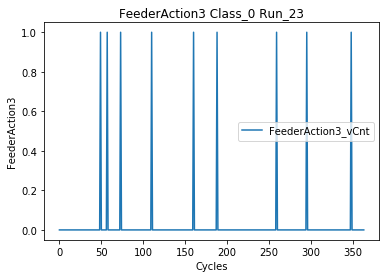

class_0_run_25
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

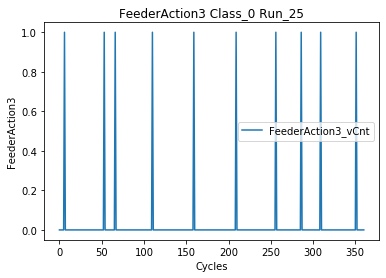

class_0_run_27
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

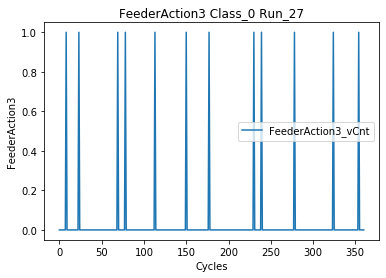

class_0_run_46
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

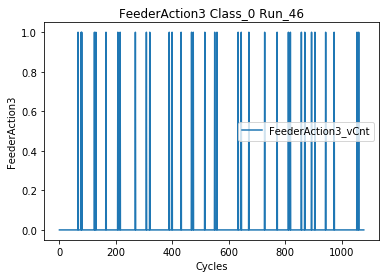

class_0_run_90
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

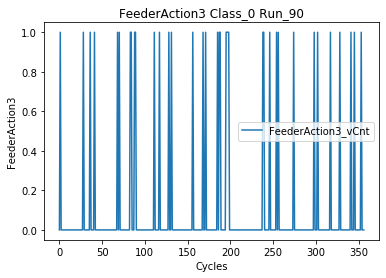

class_2_run_0
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

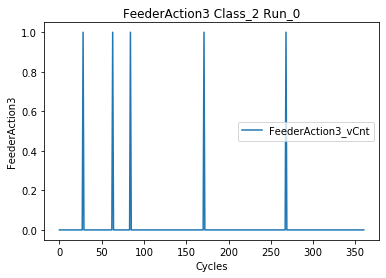

class_2_run_2
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

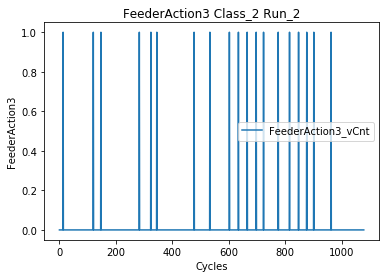

class_2_run_3
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

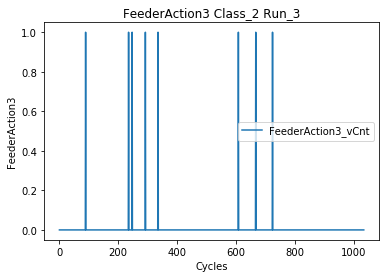

class_2_run_4
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

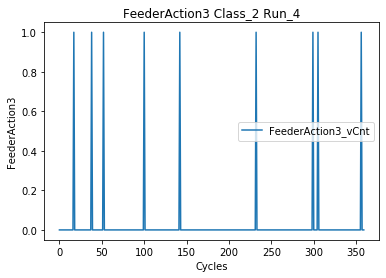

class_3_run_0
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

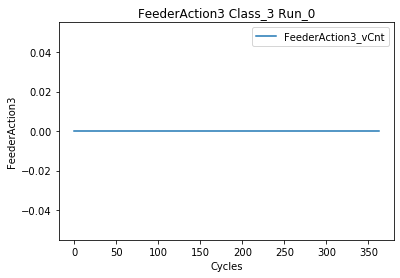

class_3_run_2
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

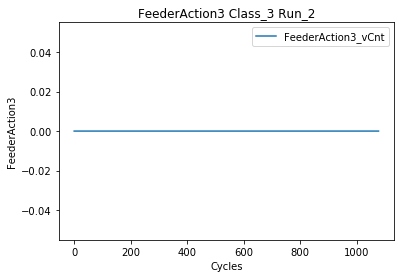

class_3_run_3
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

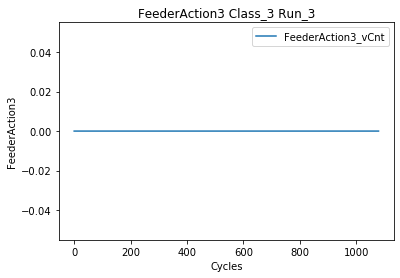

class_3_run_4
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

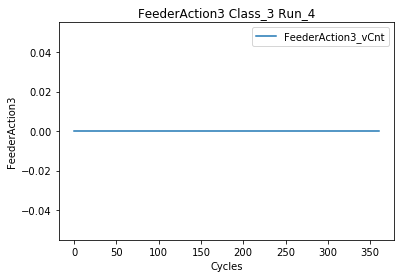

class_5_run_0
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

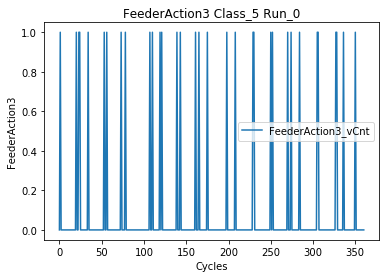

class_5_run_2
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

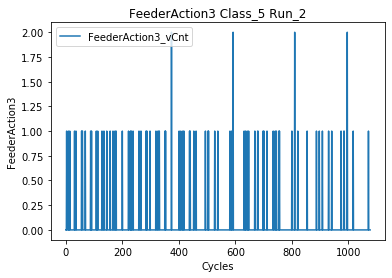

class_5_run_3
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

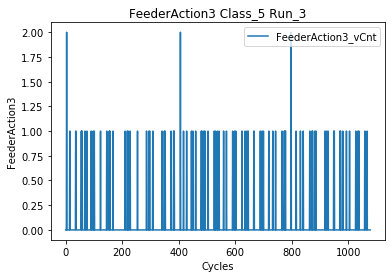

class_5_run_4
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

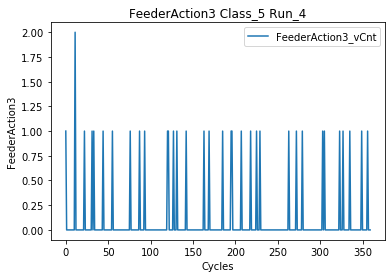

class_7_run_0
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

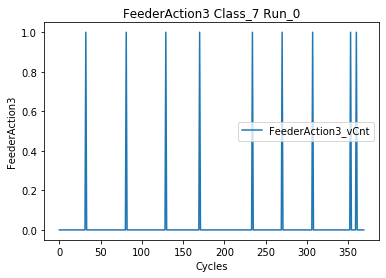

class_7_run_2
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

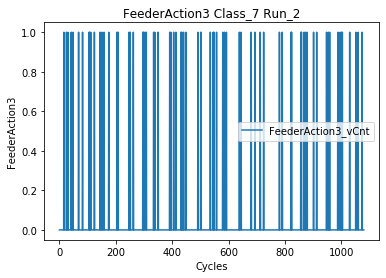

class_7_run_3
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

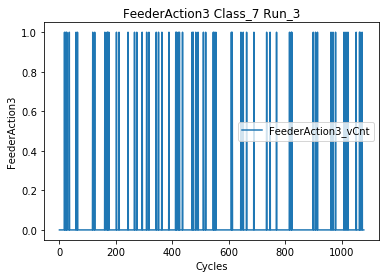

class_7_run_5
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

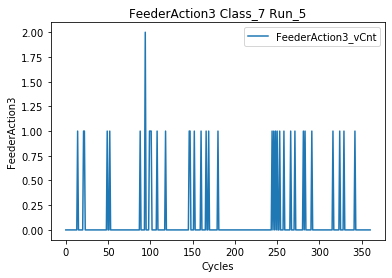

class_9_run_1
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

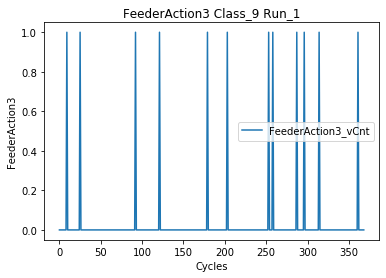

class_9_run_2
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

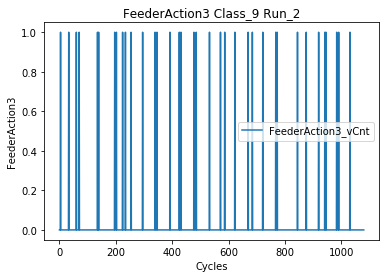

class_9_run_3
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

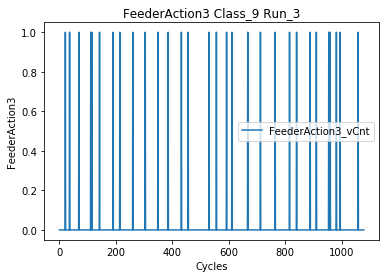

class_9_run_5
FeederAction3_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

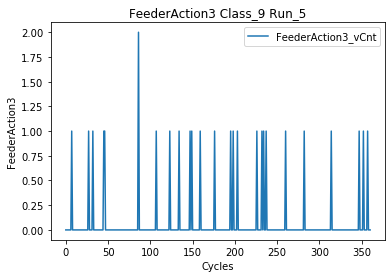

<Figure size 432x288 with 0 Axes>

In [26]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[0]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
FeederAction2_vCnt    0
dtype: int64


<Figure size 1296x360 with 0 Axes>

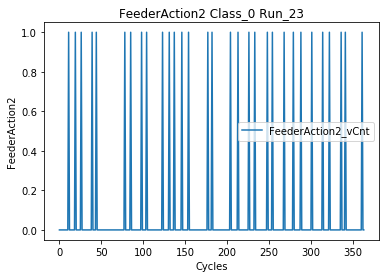

class_0_run_25
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

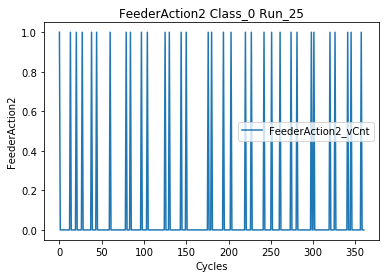

class_0_run_27
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

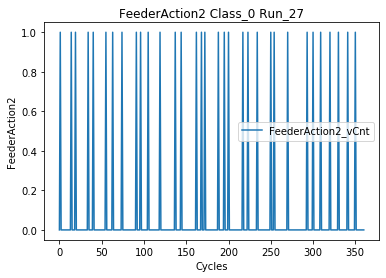

class_0_run_46
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

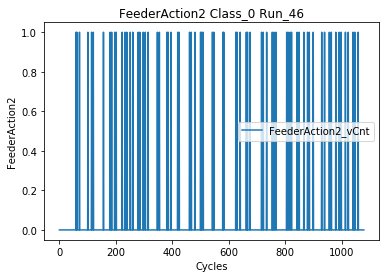

class_0_run_90
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

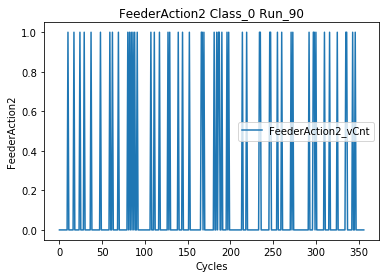

class_2_run_0
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

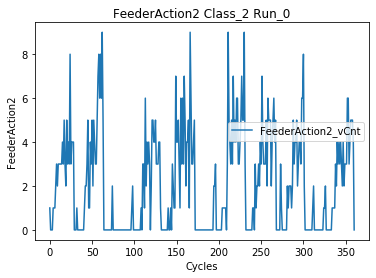

class_2_run_2
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

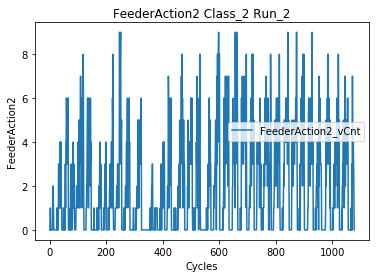

class_2_run_3
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

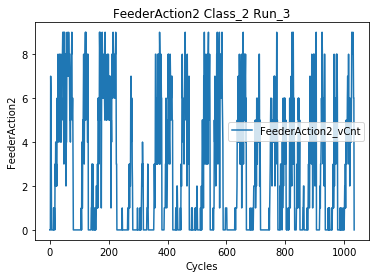

class_2_run_4
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

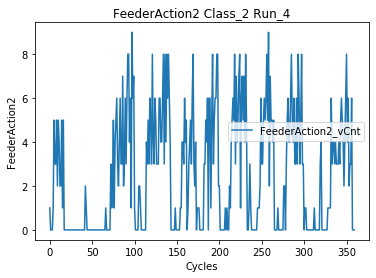

class_3_run_0
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

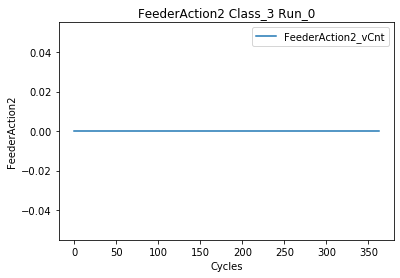

class_3_run_2
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

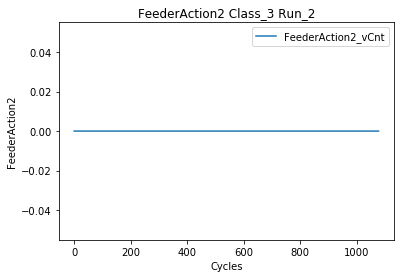

class_3_run_3
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

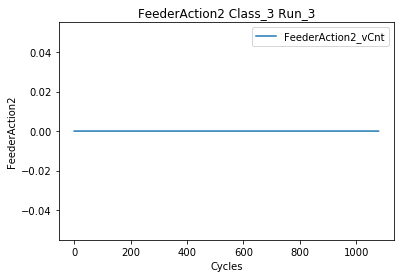

class_3_run_4
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

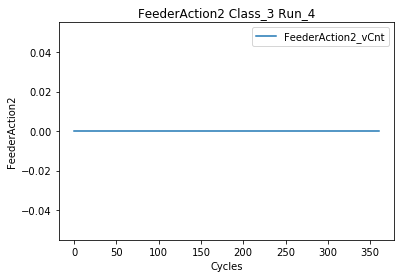

class_5_run_0
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

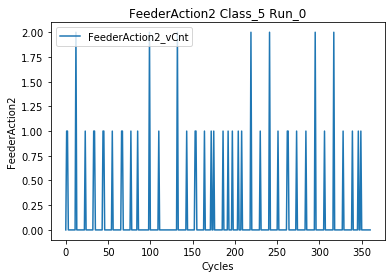

class_5_run_2
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

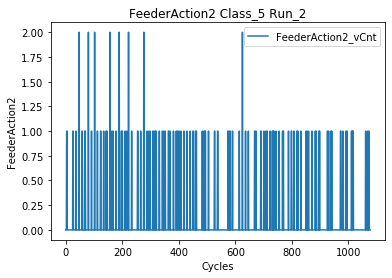

class_5_run_3
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

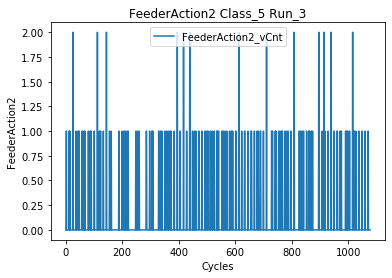

class_5_run_4
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

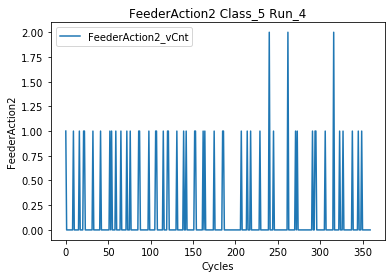

class_7_run_0
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

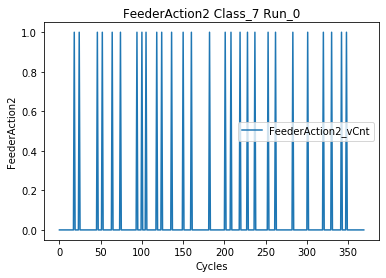

class_7_run_2
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

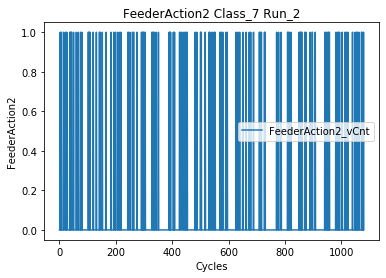

class_7_run_3
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

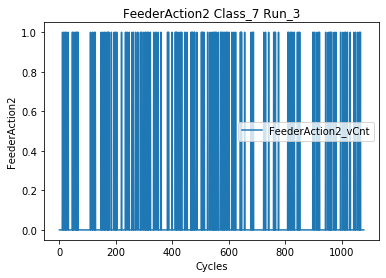

class_7_run_5
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

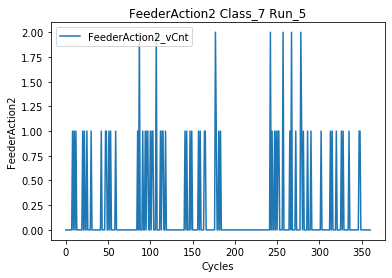

class_9_run_1
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

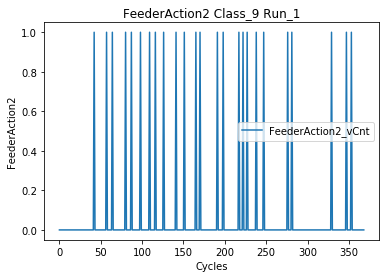

class_9_run_2
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

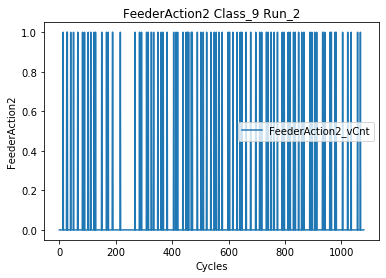

class_9_run_3
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

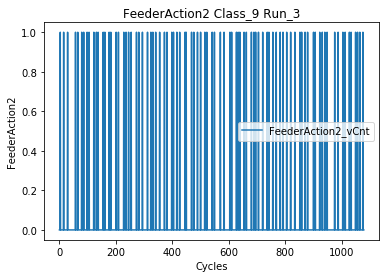

class_9_run_5
FeederAction2_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

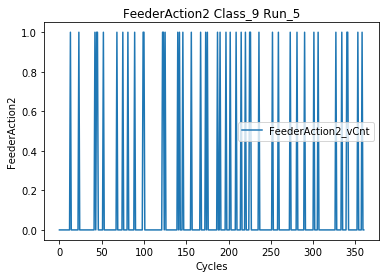

<Figure size 432x288 with 0 Axes>

In [27]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[1]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
DurationRobotFromFeederToTestBench_vFreq     0
DurationRobotFromFeederToTestBench_vStd      5
DurationRobotFromFeederToTestBench_vTrend    5
DurationRobotFromFeederToTestBench_vMax      5
DurationRobotFromFeederToTestBench_vCnt      0
DurationRobotFromFeederToTestBench_vMin      5
DurationRobotFromFeederToTestBench_value     5
dtype: int64


<Figure size 1296x360 with 0 Axes>

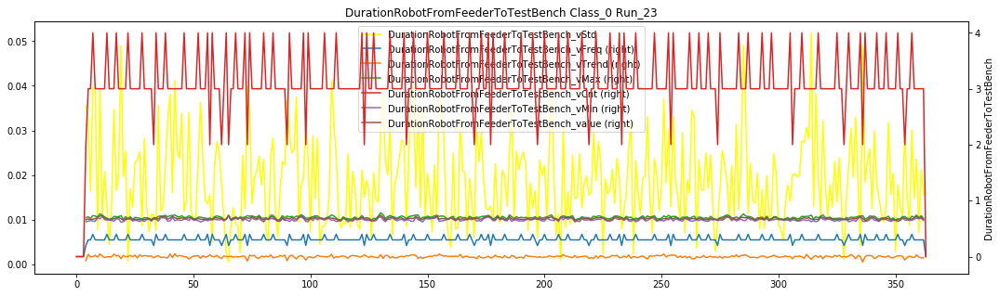

class_0_run_25
DurationRobotFromFeederToTestBench_vFreq     0
DurationRobotFromFeederToTestBench_vStd      2
DurationRobotFromFeederToTestBench_vTrend    3
DurationRobotFromFeederToTestBench_vMax      2
DurationRobotFromFeederToTestBench_vCnt      0
DurationRobotFromFeederToTestBench_vMin      2
DurationRobotFromFeederToTestBench_value     2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

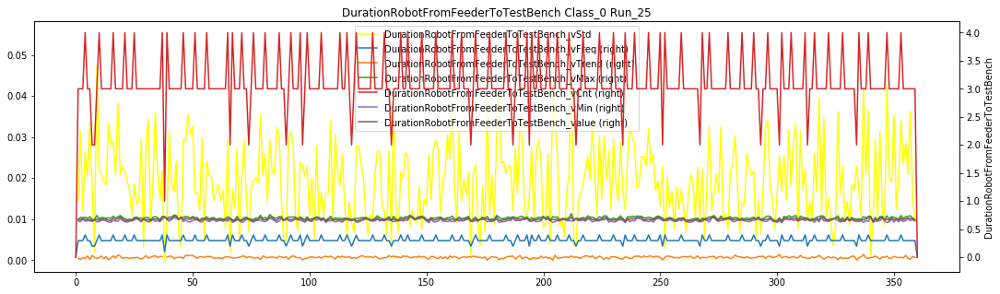

class_0_run_27
DurationRobotFromFeederToTestBench_vFreq     0
DurationRobotFromFeederToTestBench_vStd      2
DurationRobotFromFeederToTestBench_vTrend    2
DurationRobotFromFeederToTestBench_vMax      2
DurationRobotFromFeederToTestBench_vCnt      0
DurationRobotFromFeederToTestBench_vMin      2
DurationRobotFromFeederToTestBench_value     2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

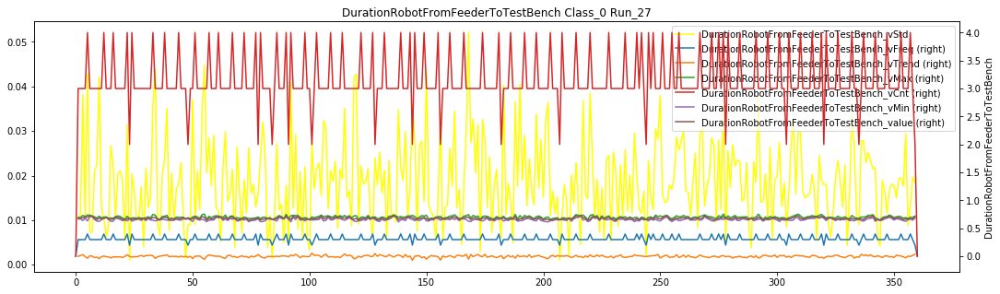

class_0_run_46
DurationRobotFromFeederToTestBench_vFreq     0
DurationRobotFromFeederToTestBench_vStd      3
DurationRobotFromFeederToTestBench_vTrend    8
DurationRobotFromFeederToTestBench_vMax      3
DurationRobotFromFeederToTestBench_vCnt      0
DurationRobotFromFeederToTestBench_vMin      3
DurationRobotFromFeederToTestBench_value     3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

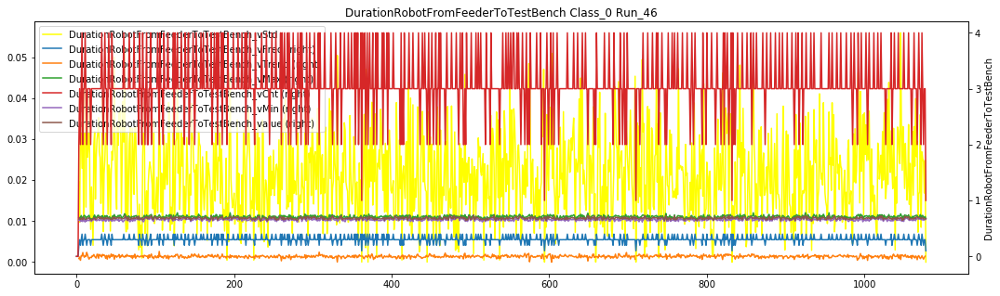

class_0_run_90
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       5
DurationRobotFromFeederToTestBench_vTrend    21
DurationRobotFromFeederToTestBench_vMax       5
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       5
DurationRobotFromFeederToTestBench_value      5
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

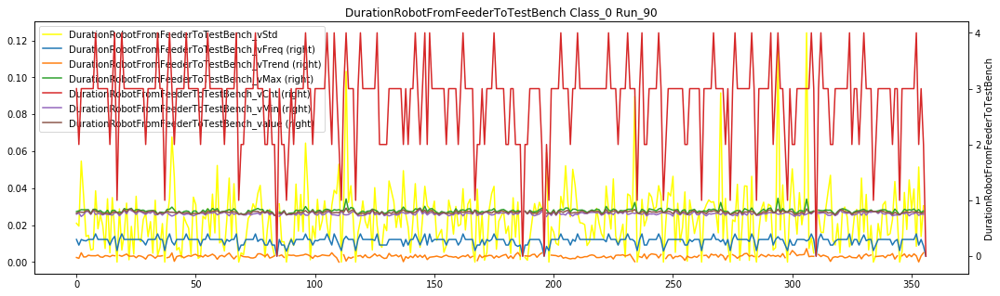

class_2_run_0
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      14
DurationRobotFromFeederToTestBench_vTrend    59
DurationRobotFromFeederToTestBench_vMax      14
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      14
DurationRobotFromFeederToTestBench_value     14
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

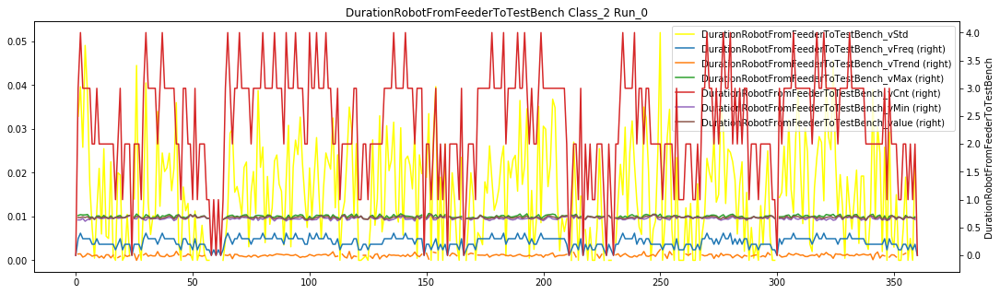

class_2_run_2
DurationRobotFromFeederToTestBench_vFreq       0
DurationRobotFromFeederToTestBench_vStd       44
DurationRobotFromFeederToTestBench_vTrend    201
DurationRobotFromFeederToTestBench_vMax       44
DurationRobotFromFeederToTestBench_vCnt        0
DurationRobotFromFeederToTestBench_vMin       44
DurationRobotFromFeederToTestBench_value      44
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

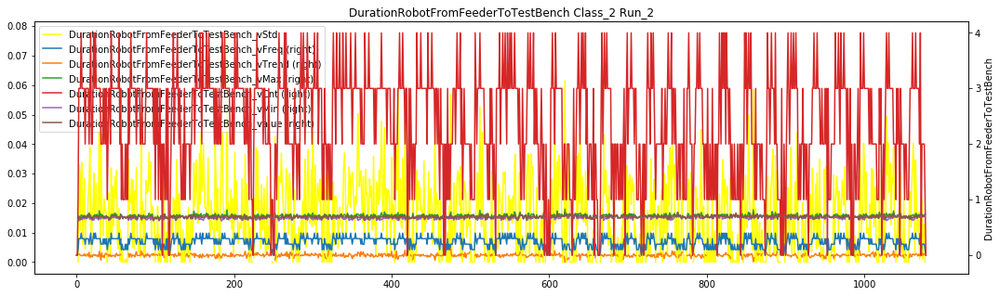

class_2_run_3
DurationRobotFromFeederToTestBench_vFreq       0
DurationRobotFromFeederToTestBench_vStd      144
DurationRobotFromFeederToTestBench_vTrend    340
DurationRobotFromFeederToTestBench_vMax      144
DurationRobotFromFeederToTestBench_vCnt        0
DurationRobotFromFeederToTestBench_vMin      144
DurationRobotFromFeederToTestBench_value     144
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

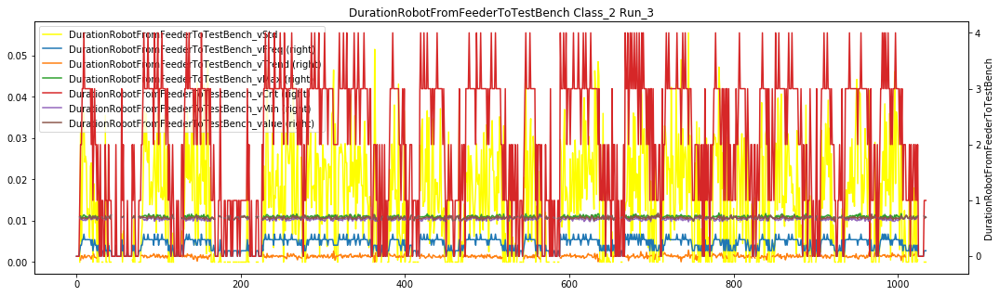

class_2_run_4
DurationRobotFromFeederToTestBench_vFreq       0
DurationRobotFromFeederToTestBench_vStd       33
DurationRobotFromFeederToTestBench_vTrend    109
DurationRobotFromFeederToTestBench_vMax       33
DurationRobotFromFeederToTestBench_vCnt        0
DurationRobotFromFeederToTestBench_vMin       33
DurationRobotFromFeederToTestBench_value      33
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

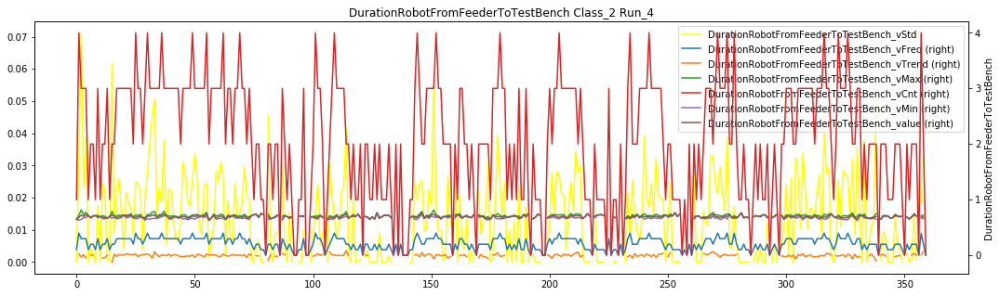

class_3_run_0
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       3
DurationRobotFromFeederToTestBench_vTrend    13
DurationRobotFromFeederToTestBench_vMax       3
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       3
DurationRobotFromFeederToTestBench_value      3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

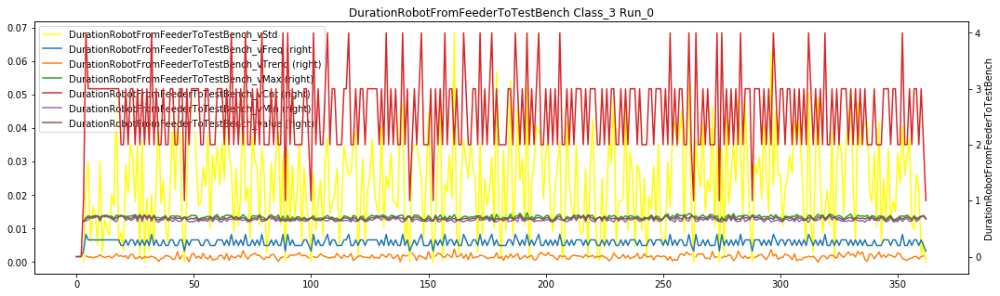

class_3_run_2
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      15
DurationRobotFromFeederToTestBench_vTrend    58
DurationRobotFromFeederToTestBench_vMax      15
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      15
DurationRobotFromFeederToTestBench_value     15
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

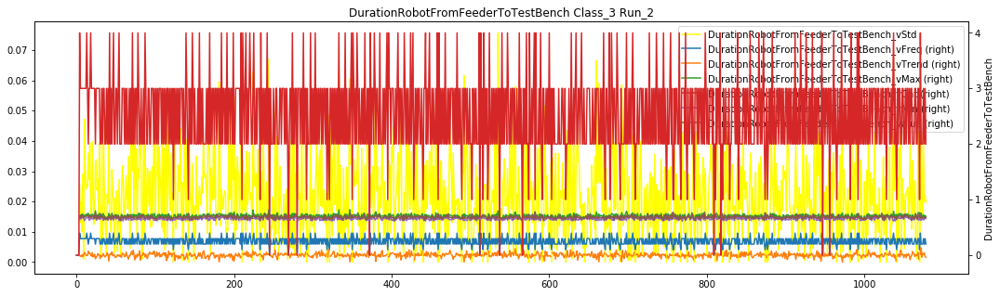

class_3_run_3
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       9
DurationRobotFromFeederToTestBench_vTrend    49
DurationRobotFromFeederToTestBench_vMax       9
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       9
DurationRobotFromFeederToTestBench_value      9
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

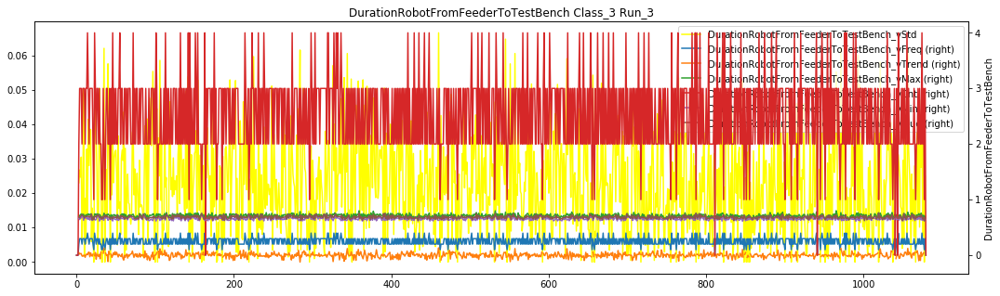

class_3_run_4
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       2
DurationRobotFromFeederToTestBench_vTrend    19
DurationRobotFromFeederToTestBench_vMax       2
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       2
DurationRobotFromFeederToTestBench_value      2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

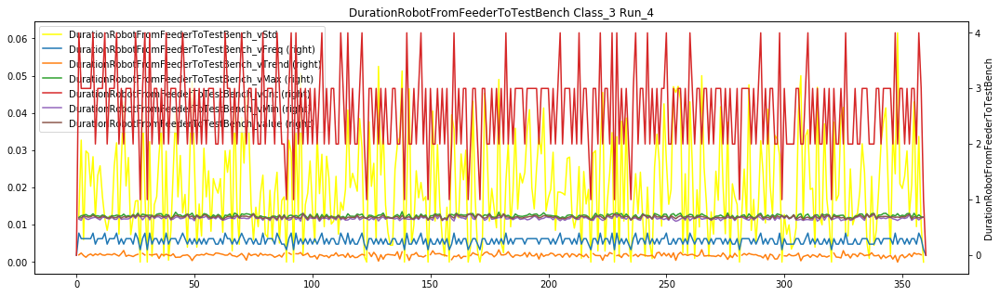

class_5_run_0
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      10
DurationRobotFromFeederToTestBench_vTrend    27
DurationRobotFromFeederToTestBench_vMax      10
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      10
DurationRobotFromFeederToTestBench_value     10
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

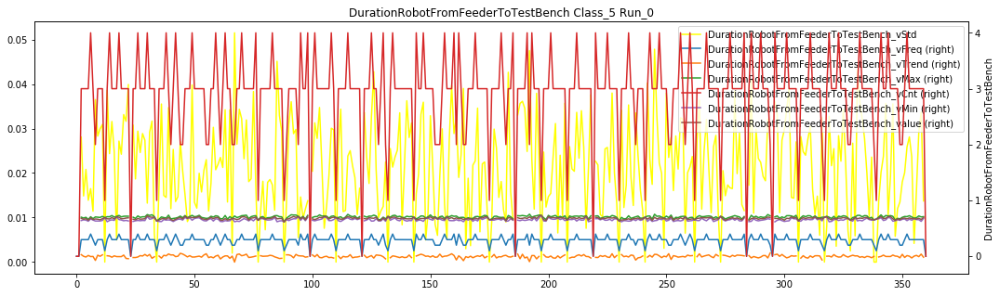

class_5_run_2
DurationRobotFromFeederToTestBench_vFreq       0
DurationRobotFromFeederToTestBench_vStd       27
DurationRobotFromFeederToTestBench_vTrend    103
DurationRobotFromFeederToTestBench_vMax       27
DurationRobotFromFeederToTestBench_vCnt        0
DurationRobotFromFeederToTestBench_vMin       27
DurationRobotFromFeederToTestBench_value      27
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

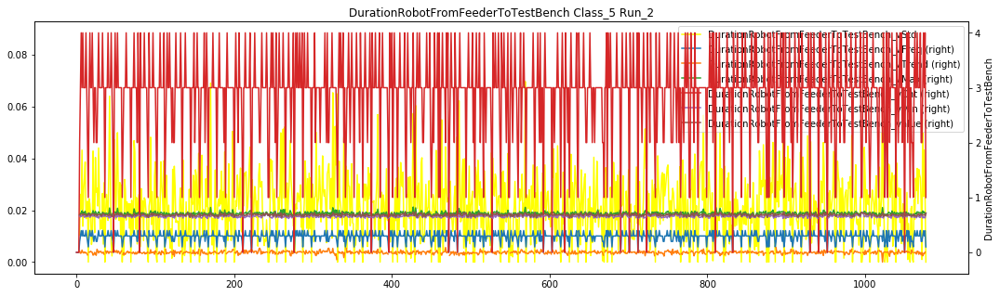

class_5_run_3
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      32
DurationRobotFromFeederToTestBench_vTrend    94
DurationRobotFromFeederToTestBench_vMax      32
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      32
DurationRobotFromFeederToTestBench_value     32
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

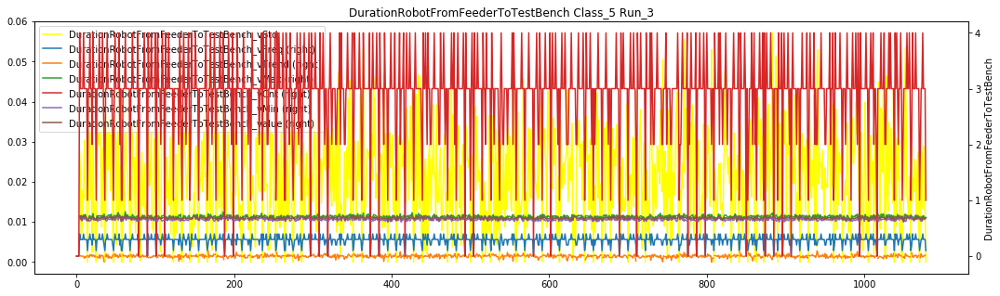

class_5_run_4
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      11
DurationRobotFromFeederToTestBench_vTrend    31
DurationRobotFromFeederToTestBench_vMax      11
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      11
DurationRobotFromFeederToTestBench_value     11
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

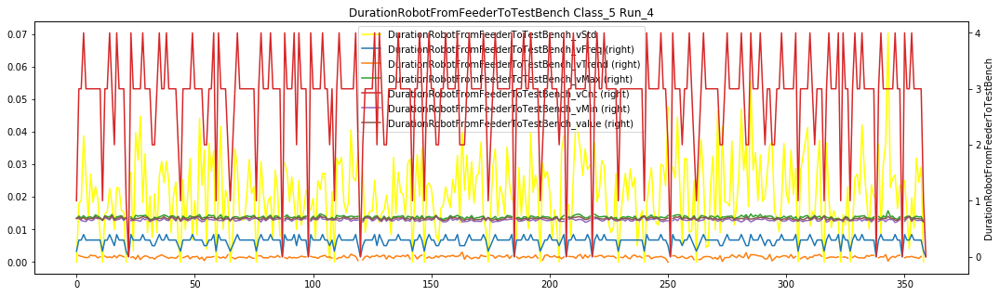

class_7_run_0
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      11
DurationRobotFromFeederToTestBench_vTrend    12
DurationRobotFromFeederToTestBench_vMax      11
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      11
DurationRobotFromFeederToTestBench_value     11
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

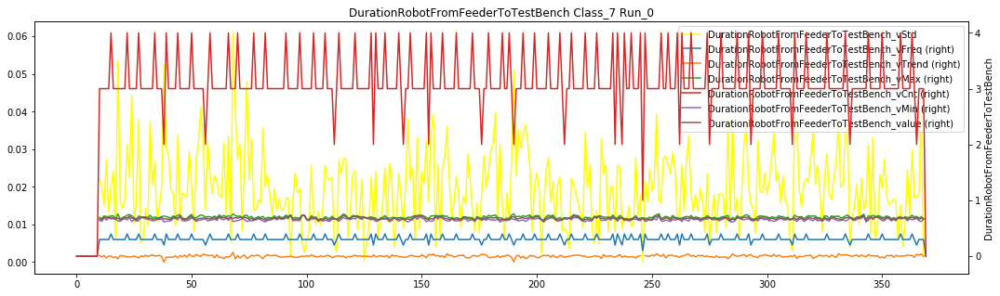

class_7_run_2
DurationRobotFromFeederToTestBench_vFreq       0
DurationRobotFromFeederToTestBench_vStd       14
DurationRobotFromFeederToTestBench_vTrend    109
DurationRobotFromFeederToTestBench_vMax       14
DurationRobotFromFeederToTestBench_vCnt        0
DurationRobotFromFeederToTestBench_vMin       14
DurationRobotFromFeederToTestBench_value      14
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

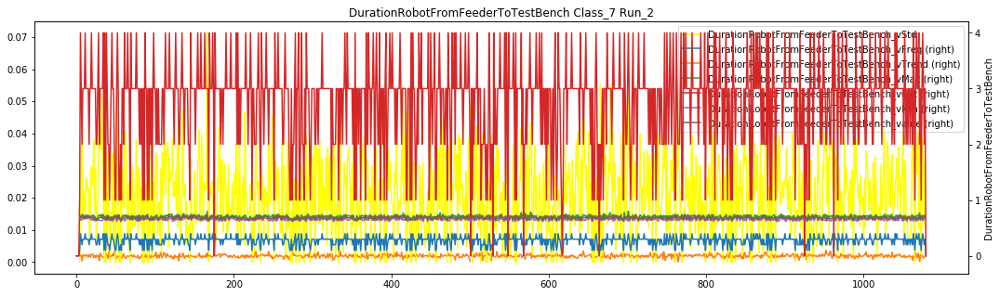

class_7_run_3
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       7
DurationRobotFromFeederToTestBench_vTrend    94
DurationRobotFromFeederToTestBench_vMax       7
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       7
DurationRobotFromFeederToTestBench_value      7
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

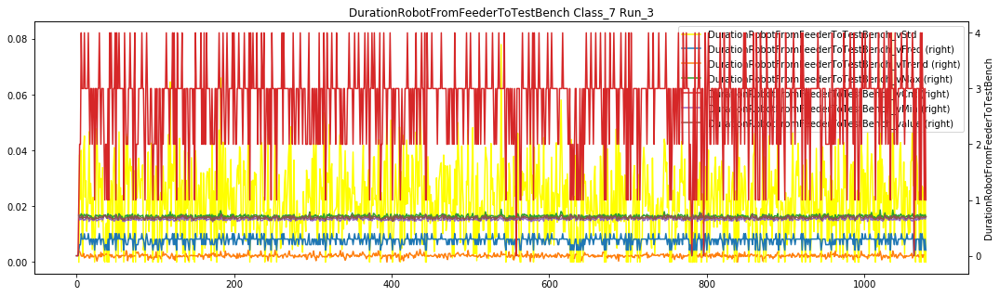

class_7_run_5
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd      15
DurationRobotFromFeederToTestBench_vTrend    69
DurationRobotFromFeederToTestBench_vMax      15
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin      15
DurationRobotFromFeederToTestBench_value     15
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

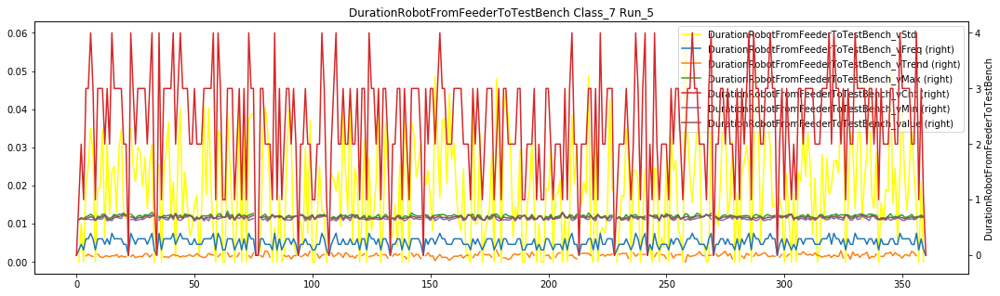

class_9_run_1
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       9
DurationRobotFromFeederToTestBench_vTrend    10
DurationRobotFromFeederToTestBench_vMax       9
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       9
DurationRobotFromFeederToTestBench_value      9
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

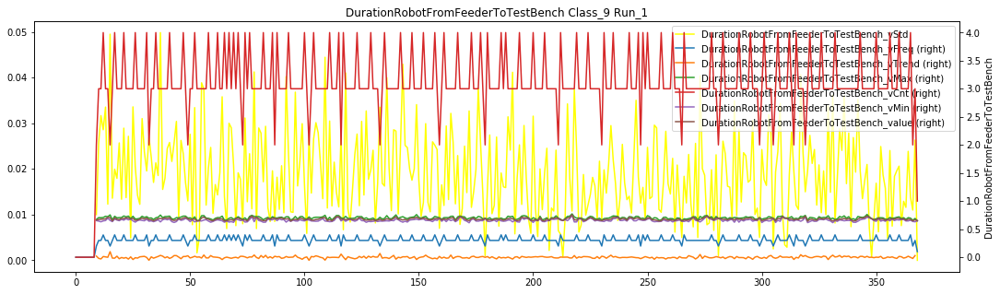

class_9_run_2
DurationRobotFromFeederToTestBench_vFreq     0
DurationRobotFromFeederToTestBench_vStd      4
DurationRobotFromFeederToTestBench_vTrend    7
DurationRobotFromFeederToTestBench_vMax      4
DurationRobotFromFeederToTestBench_vCnt      0
DurationRobotFromFeederToTestBench_vMin      4
DurationRobotFromFeederToTestBench_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

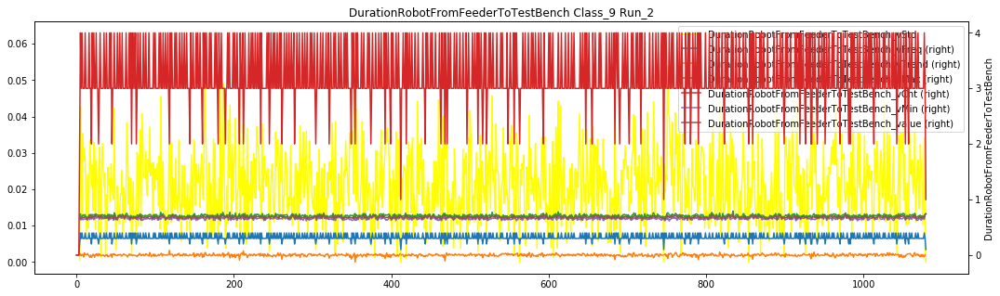

class_9_run_3
DurationRobotFromFeederToTestBench_vFreq     0
DurationRobotFromFeederToTestBench_vStd      4
DurationRobotFromFeederToTestBench_vTrend    6
DurationRobotFromFeederToTestBench_vMax      4
DurationRobotFromFeederToTestBench_vCnt      0
DurationRobotFromFeederToTestBench_vMin      4
DurationRobotFromFeederToTestBench_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

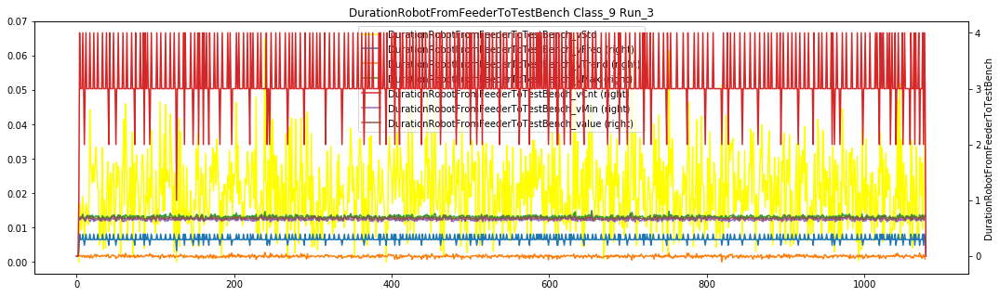

class_9_run_5
DurationRobotFromFeederToTestBench_vFreq      0
DurationRobotFromFeederToTestBench_vStd       5
DurationRobotFromFeederToTestBench_vTrend    16
DurationRobotFromFeederToTestBench_vMax       5
DurationRobotFromFeederToTestBench_vCnt       0
DurationRobotFromFeederToTestBench_vMin       5
DurationRobotFromFeederToTestBench_value      5
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

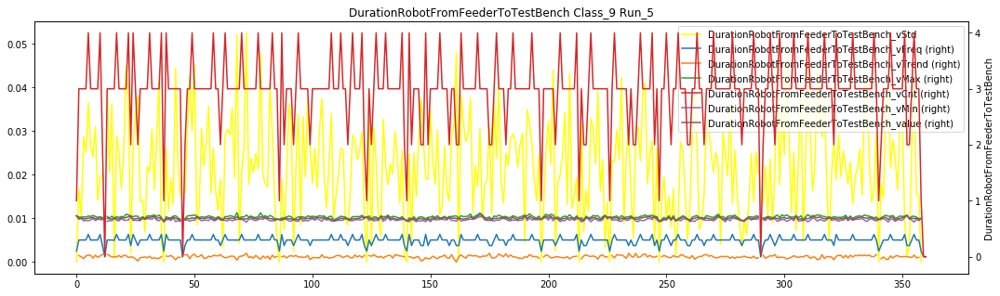

<Figure size 432x288 with 0 Axes>

In [28]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[2]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
FeederAction1_vCnt    0
dtype: int64


<Figure size 1296x360 with 0 Axes>

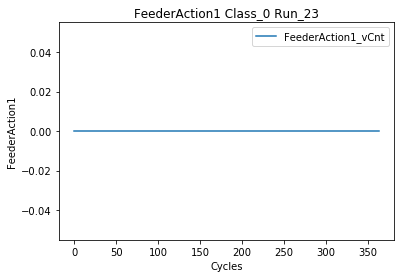

class_0_run_25
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

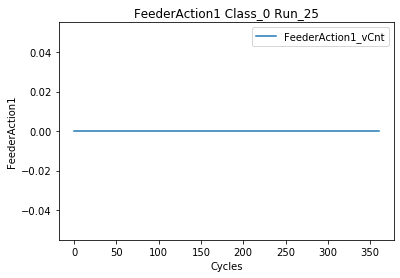

class_0_run_27
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

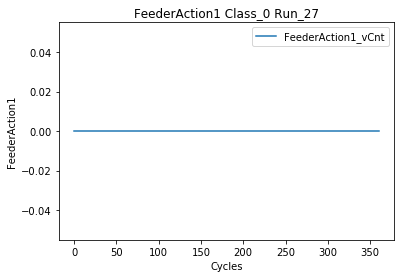

class_0_run_46
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

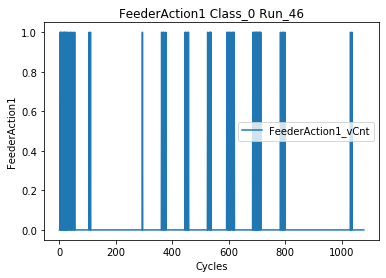

class_0_run_90
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

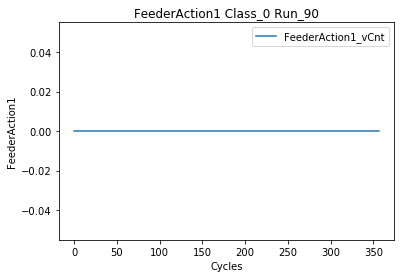

class_2_run_0
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

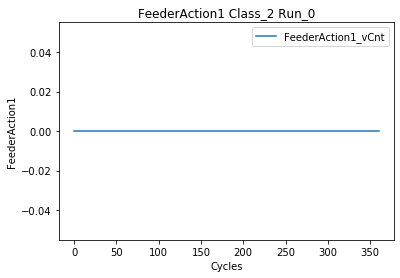

class_2_run_2
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

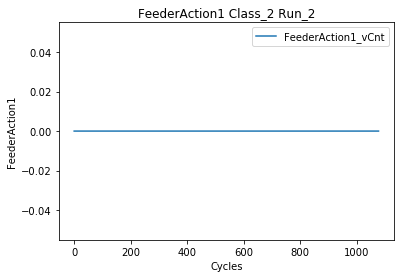

class_2_run_3
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

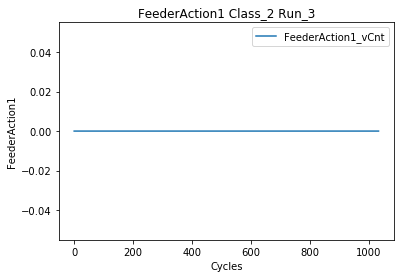

class_2_run_4
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

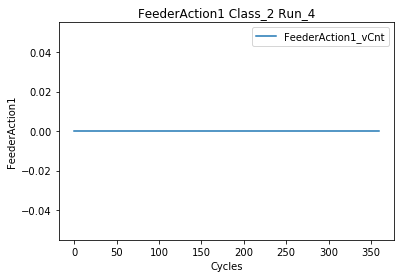

class_3_run_0
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

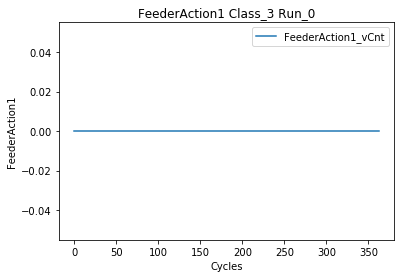

class_3_run_2
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

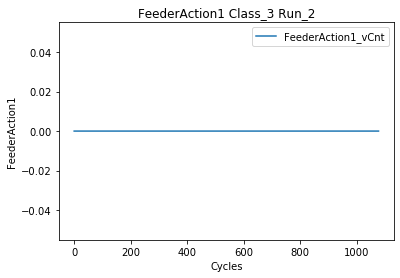

class_3_run_3
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

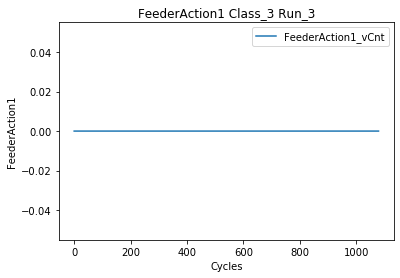

class_3_run_4
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

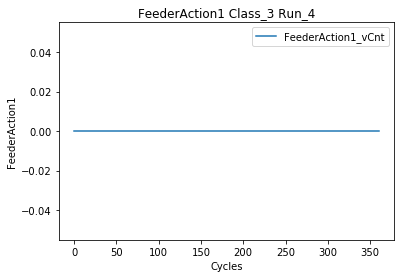

class_5_run_0
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

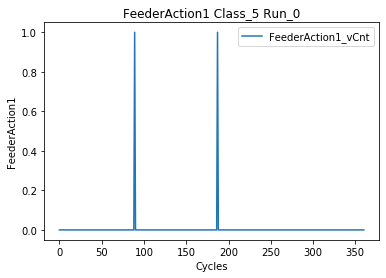

class_5_run_2
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

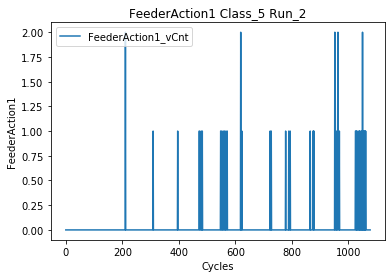

class_5_run_3
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

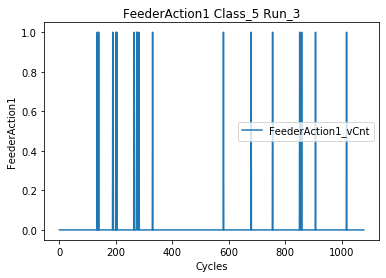

class_5_run_4
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

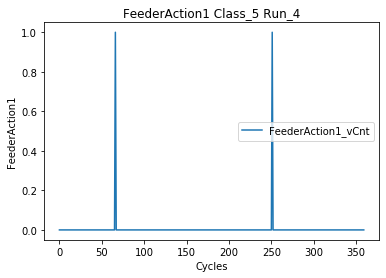

class_7_run_0
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

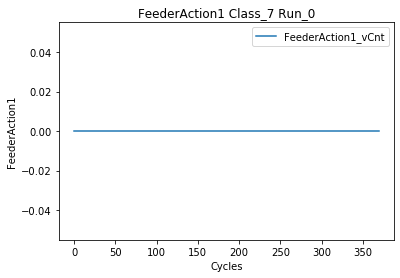

class_7_run_2
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

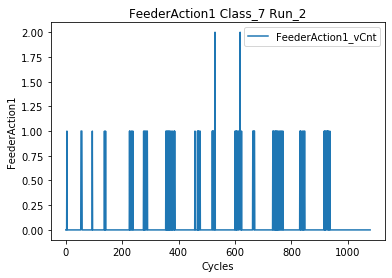

class_7_run_3
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

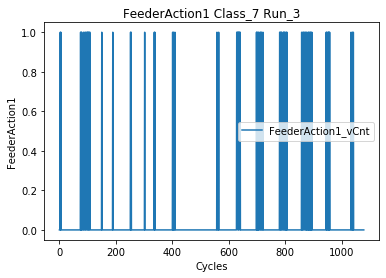

class_7_run_5
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

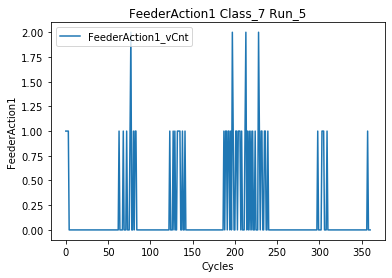

class_9_run_1
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

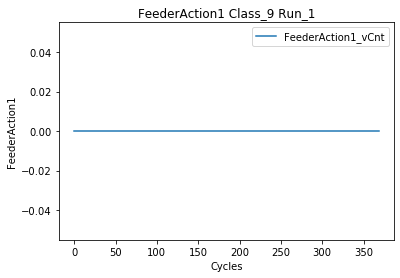

class_9_run_2
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

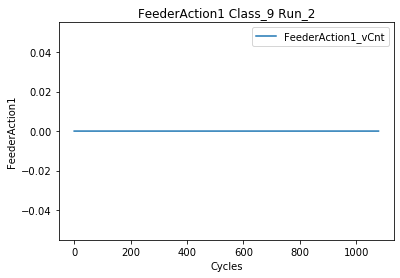

class_9_run_3
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

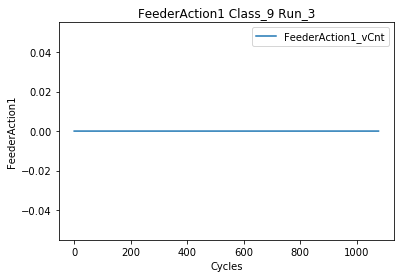

class_9_run_5
FeederAction1_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

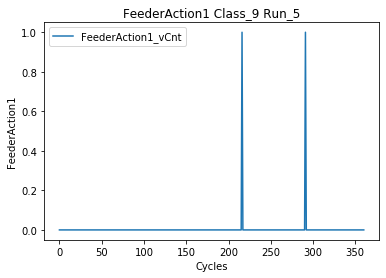

<Figure size 432x288 with 0 Axes>

In [29]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[3]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
DurationRobotFromTestBenchToFeeder_vMax       5
DurationRobotFromTestBenchToFeeder_value      5
DurationRobotFromTestBenchToFeeder_vTrend    21
DurationRobotFromTestBenchToFeeder_vStd       5
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       5
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 1296x360 with 0 Axes>

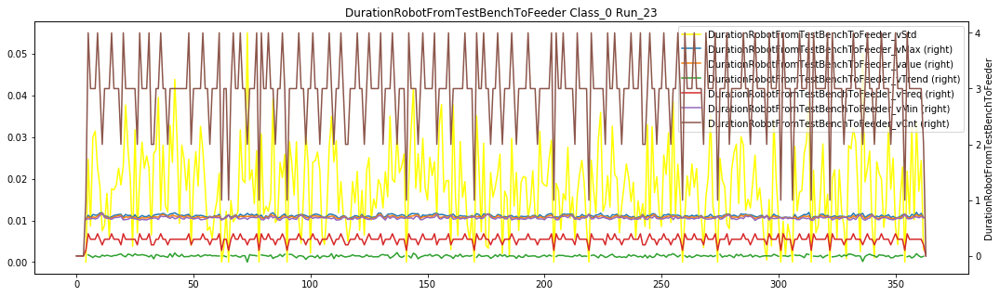

class_0_run_25
DurationRobotFromTestBenchToFeeder_vMax       2
DurationRobotFromTestBenchToFeeder_value      2
DurationRobotFromTestBenchToFeeder_vTrend    18
DurationRobotFromTestBenchToFeeder_vStd       2
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       2
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

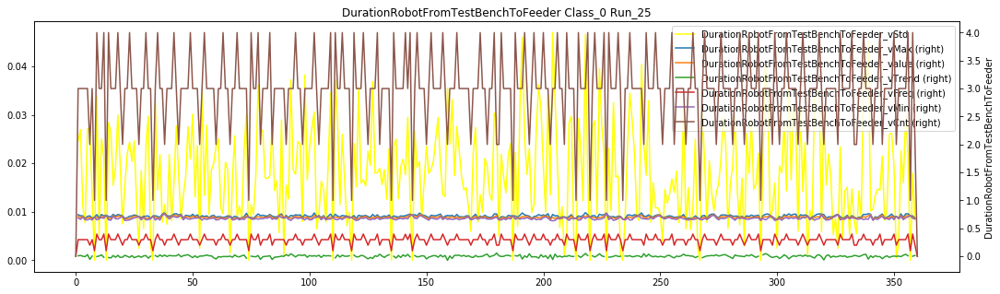

class_0_run_27
DurationRobotFromTestBenchToFeeder_vMax       2
DurationRobotFromTestBenchToFeeder_value      2
DurationRobotFromTestBenchToFeeder_vTrend    14
DurationRobotFromTestBenchToFeeder_vStd       2
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       2
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

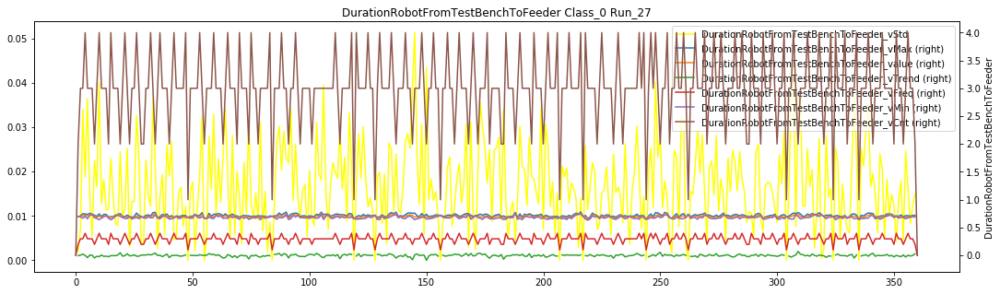

class_0_run_46
DurationRobotFromTestBenchToFeeder_vMax       4
DurationRobotFromTestBenchToFeeder_value      4
DurationRobotFromTestBenchToFeeder_vTrend    79
DurationRobotFromTestBenchToFeeder_vStd       4
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       4
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

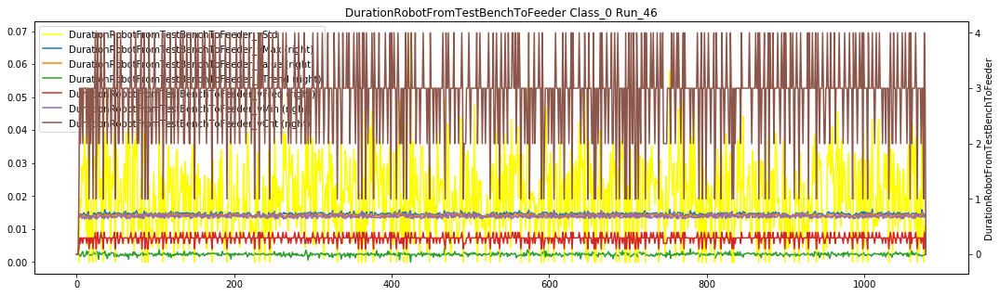

class_0_run_90
DurationRobotFromTestBenchToFeeder_vMax       4
DurationRobotFromTestBenchToFeeder_value      4
DurationRobotFromTestBenchToFeeder_vTrend    36
DurationRobotFromTestBenchToFeeder_vStd       4
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       4
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

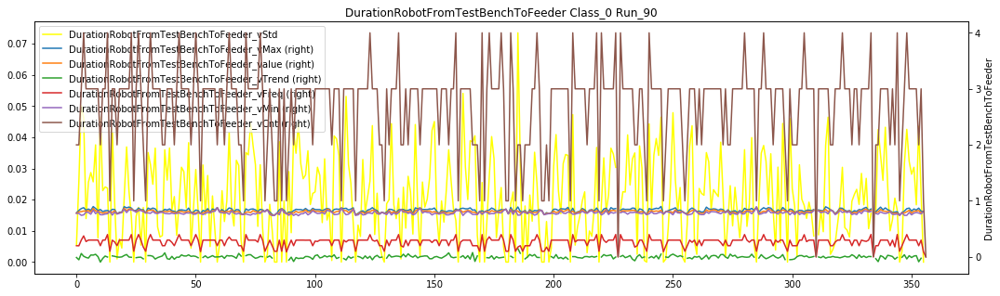

class_2_run_0
DurationRobotFromTestBenchToFeeder_vMax      103
DurationRobotFromTestBenchToFeeder_value     103
DurationRobotFromTestBenchToFeeder_vTrend    187
DurationRobotFromTestBenchToFeeder_vStd      103
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin      103
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

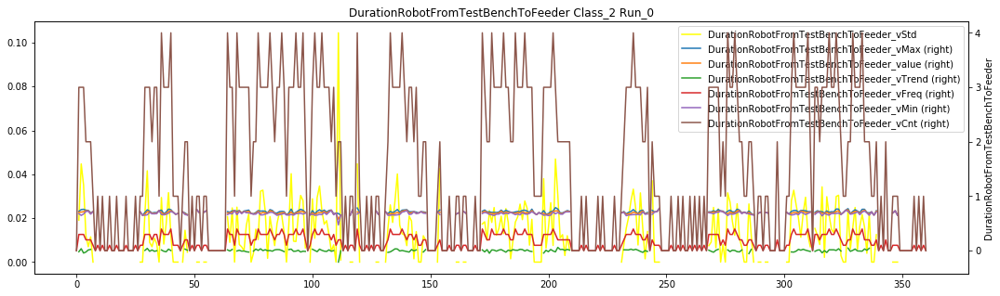

class_2_run_2
DurationRobotFromTestBenchToFeeder_vMax      300
DurationRobotFromTestBenchToFeeder_value     300
DurationRobotFromTestBenchToFeeder_vTrend    557
DurationRobotFromTestBenchToFeeder_vStd      300
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin      300
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

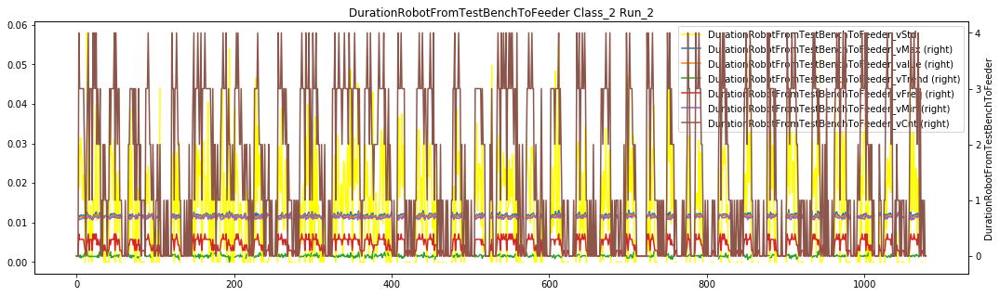

class_2_run_3
DurationRobotFromTestBenchToFeeder_vMax      384
DurationRobotFromTestBenchToFeeder_value     384
DurationRobotFromTestBenchToFeeder_vTrend    560
DurationRobotFromTestBenchToFeeder_vStd      384
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin      384
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

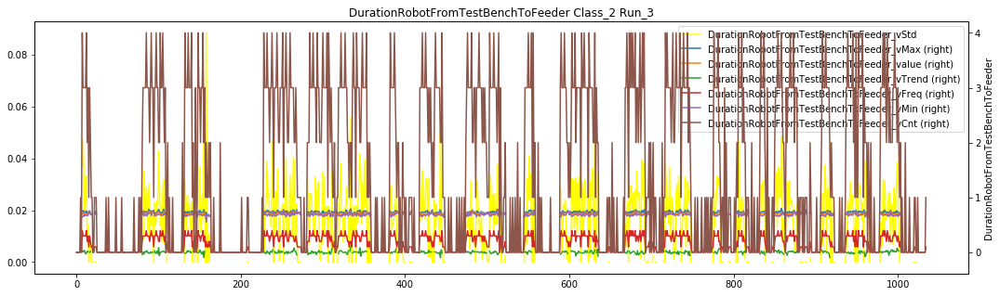

class_2_run_4
DurationRobotFromTestBenchToFeeder_vMax      135
DurationRobotFromTestBenchToFeeder_value     135
DurationRobotFromTestBenchToFeeder_vTrend    205
DurationRobotFromTestBenchToFeeder_vStd      135
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin      135
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

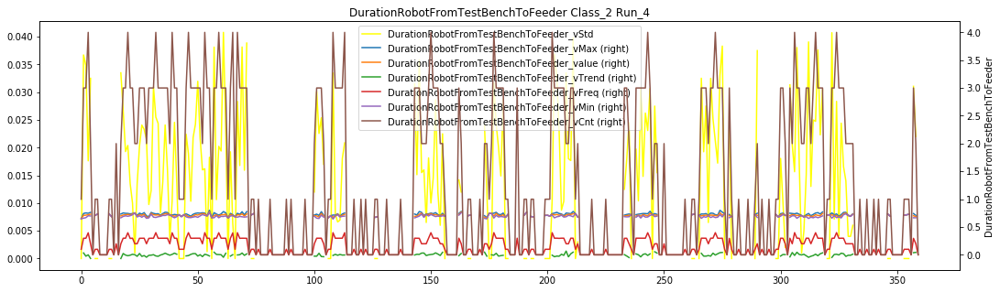

class_3_run_0
DurationRobotFromTestBenchToFeeder_vMax        8
DurationRobotFromTestBenchToFeeder_value       8
DurationRobotFromTestBenchToFeeder_vTrend    125
DurationRobotFromTestBenchToFeeder_vStd        8
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin        8
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

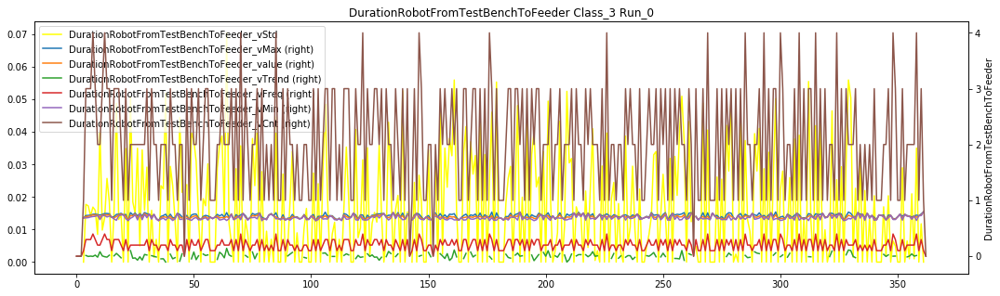

class_3_run_2
DurationRobotFromTestBenchToFeeder_vMax       34
DurationRobotFromTestBenchToFeeder_value      34
DurationRobotFromTestBenchToFeeder_vTrend    379
DurationRobotFromTestBenchToFeeder_vStd       34
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin       34
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

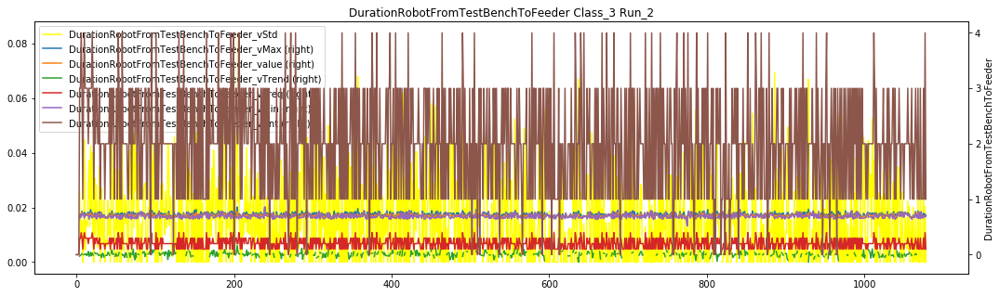

class_3_run_3
DurationRobotFromTestBenchToFeeder_vMax       41
DurationRobotFromTestBenchToFeeder_value      41
DurationRobotFromTestBenchToFeeder_vTrend    395
DurationRobotFromTestBenchToFeeder_vStd       41
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin       41
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

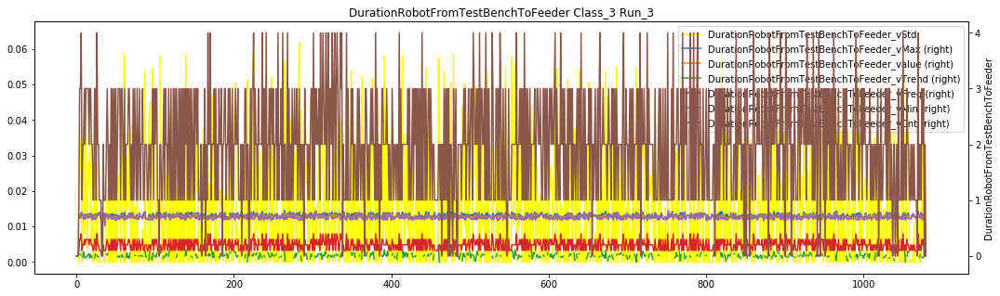

class_3_run_4
DurationRobotFromTestBenchToFeeder_vMax       10
DurationRobotFromTestBenchToFeeder_value      10
DurationRobotFromTestBenchToFeeder_vTrend    118
DurationRobotFromTestBenchToFeeder_vStd       10
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin       10
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

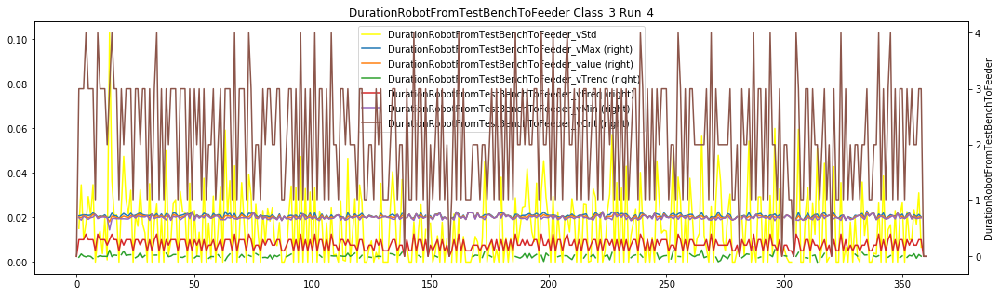

class_5_run_0
DurationRobotFromTestBenchToFeeder_vMax       8
DurationRobotFromTestBenchToFeeder_value      8
DurationRobotFromTestBenchToFeeder_vTrend    42
DurationRobotFromTestBenchToFeeder_vStd       8
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       8
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

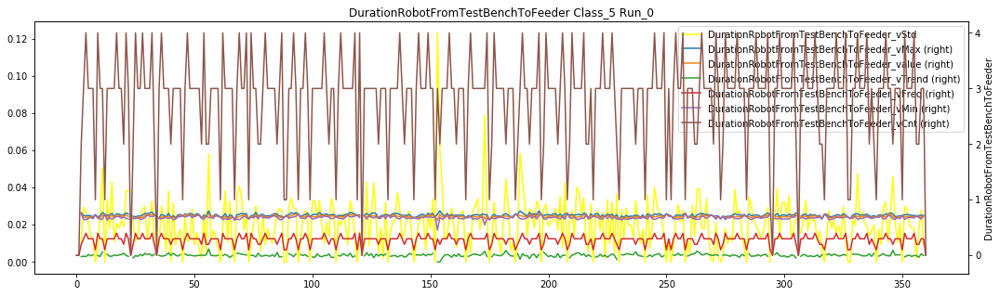

class_5_run_2
DurationRobotFromTestBenchToFeeder_vMax       31
DurationRobotFromTestBenchToFeeder_value      31
DurationRobotFromTestBenchToFeeder_vTrend    125
DurationRobotFromTestBenchToFeeder_vStd       31
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin       31
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

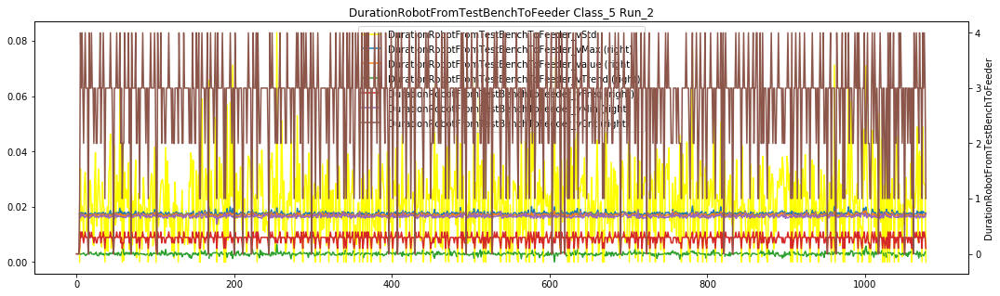

class_5_run_3
DurationRobotFromTestBenchToFeeder_vMax       22
DurationRobotFromTestBenchToFeeder_value      22
DurationRobotFromTestBenchToFeeder_vTrend    122
DurationRobotFromTestBenchToFeeder_vStd       22
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin       22
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

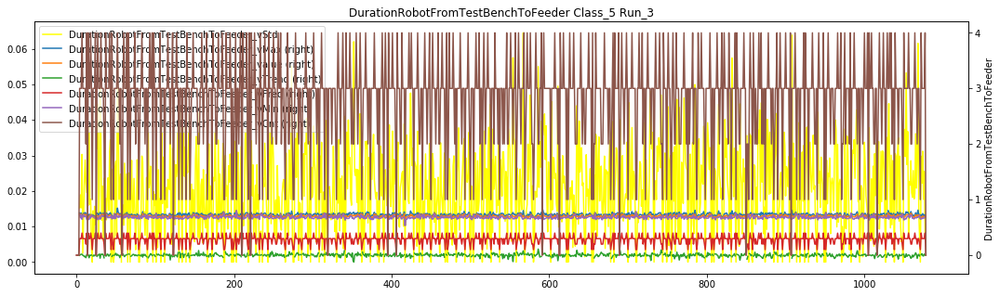

class_5_run_4
DurationRobotFromTestBenchToFeeder_vMax      13
DurationRobotFromTestBenchToFeeder_value     13
DurationRobotFromTestBenchToFeeder_vTrend    36
DurationRobotFromTestBenchToFeeder_vStd      13
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin      13
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

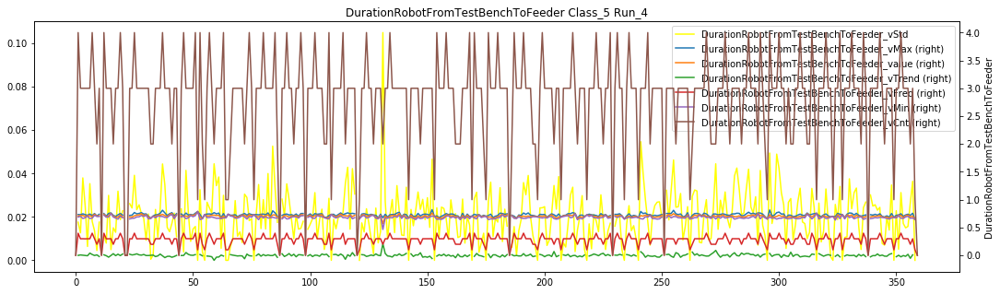

class_7_run_0
DurationRobotFromTestBenchToFeeder_vMax      11
DurationRobotFromTestBenchToFeeder_value     11
DurationRobotFromTestBenchToFeeder_vTrend    26
DurationRobotFromTestBenchToFeeder_vStd      11
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin      11
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

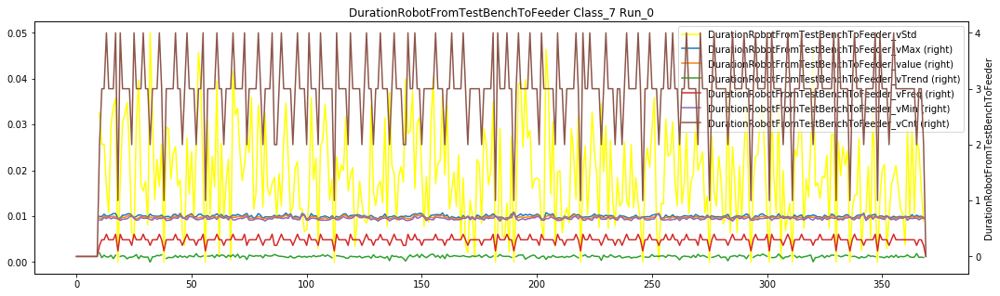

class_7_run_2
DurationRobotFromTestBenchToFeeder_vMax       11
DurationRobotFromTestBenchToFeeder_value      11
DurationRobotFromTestBenchToFeeder_vTrend    128
DurationRobotFromTestBenchToFeeder_vStd       11
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin       11
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

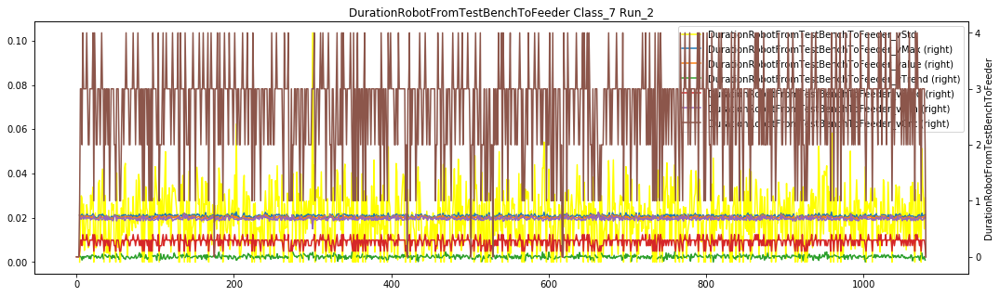

class_7_run_3
DurationRobotFromTestBenchToFeeder_vMax        8
DurationRobotFromTestBenchToFeeder_value       8
DurationRobotFromTestBenchToFeeder_vTrend    105
DurationRobotFromTestBenchToFeeder_vStd        8
DurationRobotFromTestBenchToFeeder_vFreq       0
DurationRobotFromTestBenchToFeeder_vMin        8
DurationRobotFromTestBenchToFeeder_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

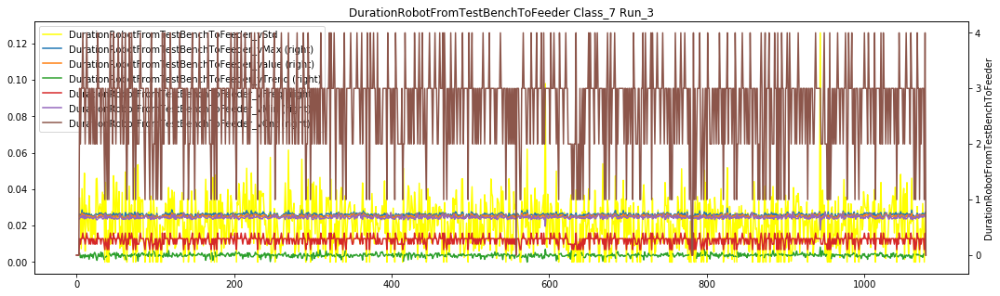

class_7_run_5
DurationRobotFromTestBenchToFeeder_vMax       9
DurationRobotFromTestBenchToFeeder_value      9
DurationRobotFromTestBenchToFeeder_vTrend    71
DurationRobotFromTestBenchToFeeder_vStd       9
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       9
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

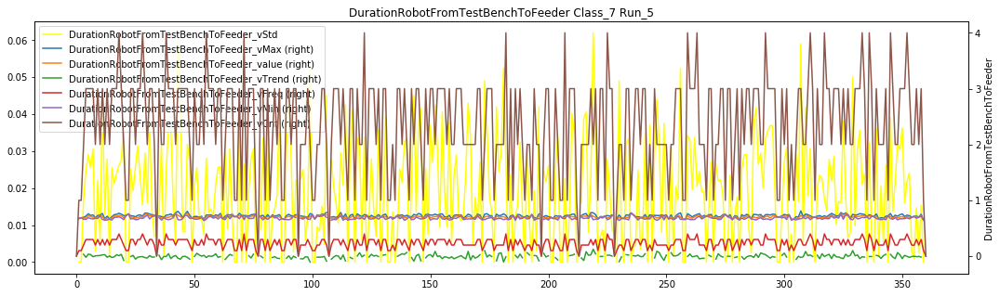

class_9_run_1
DurationRobotFromTestBenchToFeeder_vMax       9
DurationRobotFromTestBenchToFeeder_value      9
DurationRobotFromTestBenchToFeeder_vTrend    22
DurationRobotFromTestBenchToFeeder_vStd       9
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       9
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

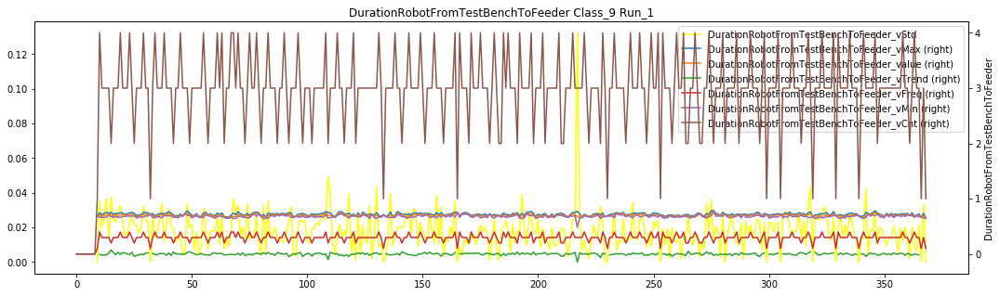

class_9_run_2
DurationRobotFromTestBenchToFeeder_vMax       6
DurationRobotFromTestBenchToFeeder_value      6
DurationRobotFromTestBenchToFeeder_vTrend    38
DurationRobotFromTestBenchToFeeder_vStd       6
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       6
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

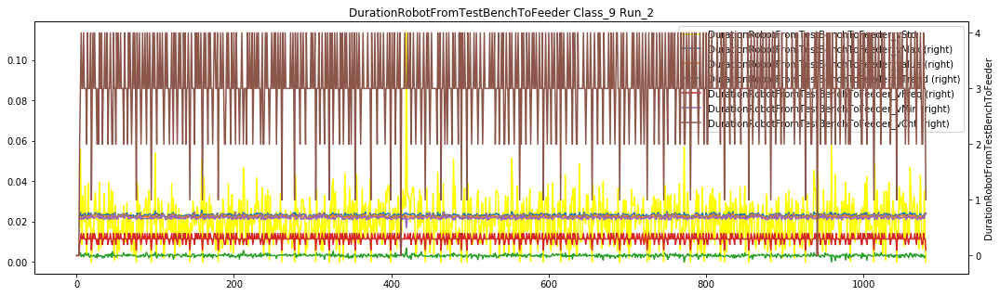

class_9_run_3
DurationRobotFromTestBenchToFeeder_vMax       4
DurationRobotFromTestBenchToFeeder_value      4
DurationRobotFromTestBenchToFeeder_vTrend    45
DurationRobotFromTestBenchToFeeder_vStd       4
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       4
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

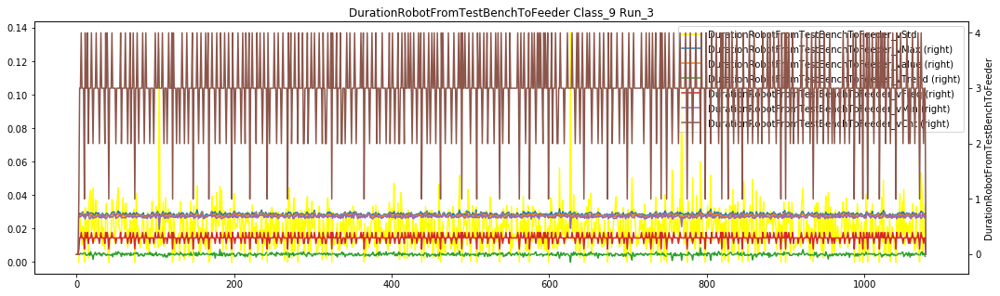

class_9_run_5
DurationRobotFromTestBenchToFeeder_vMax       7
DurationRobotFromTestBenchToFeeder_value      7
DurationRobotFromTestBenchToFeeder_vTrend    26
DurationRobotFromTestBenchToFeeder_vStd       7
DurationRobotFromTestBenchToFeeder_vFreq      0
DurationRobotFromTestBenchToFeeder_vMin       7
DurationRobotFromTestBenchToFeeder_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

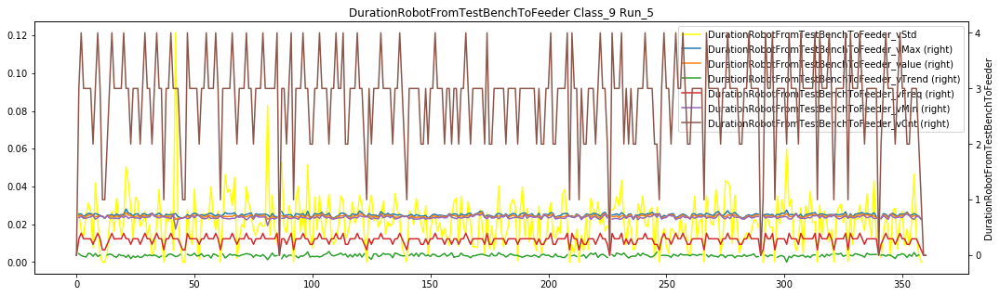

<Figure size 432x288 with 0 Axes>

In [30]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[4]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 1296x360 with 0 Axes>

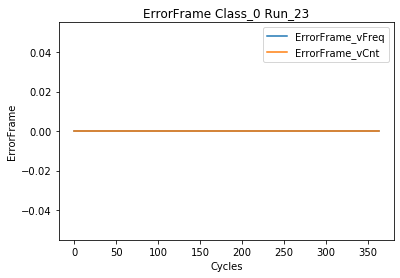

class_0_run_25
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

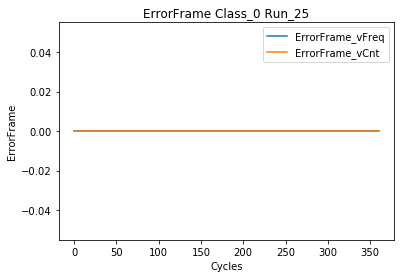

class_0_run_27
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

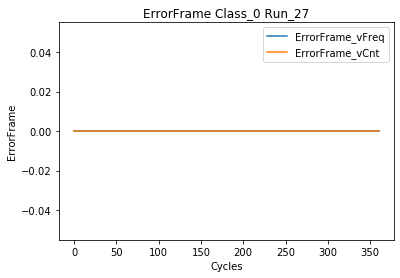

class_0_run_46
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

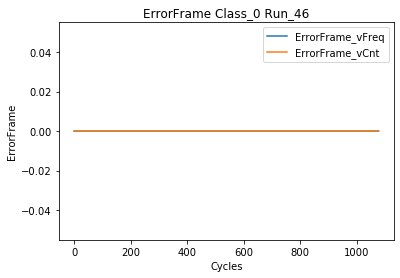

class_0_run_90
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

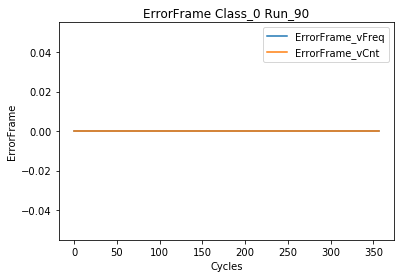

class_2_run_0
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

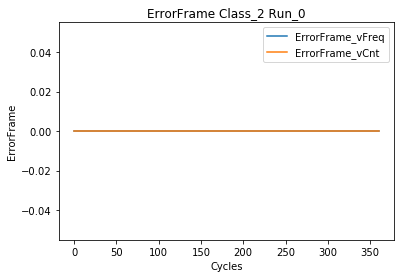

class_2_run_2
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

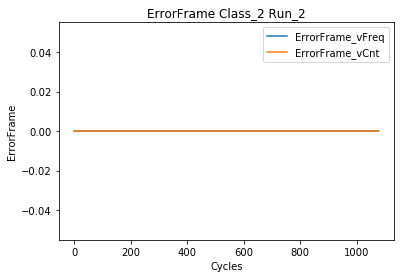

class_2_run_3
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

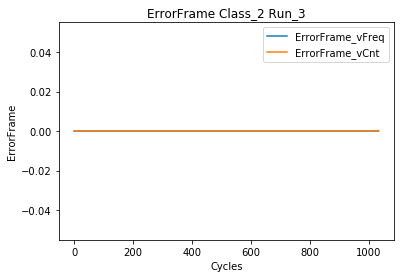

class_2_run_4
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

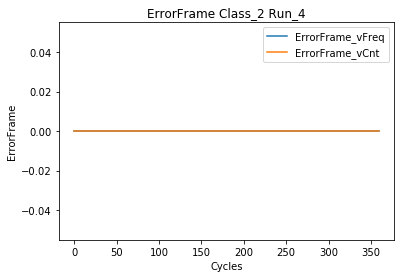

class_3_run_0
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

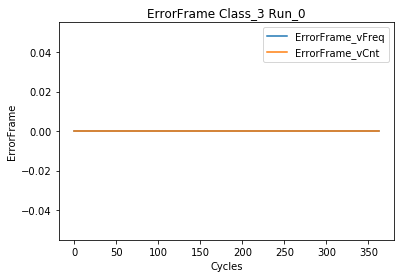

class_3_run_2
ErrorFrame_vFreq    1
ErrorFrame_vCnt     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

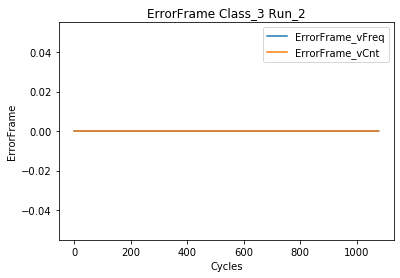

class_3_run_3
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

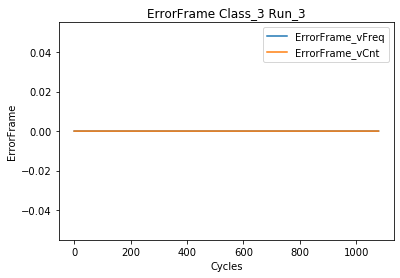

class_3_run_4
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

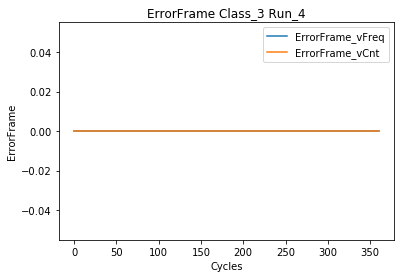

class_5_run_0
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

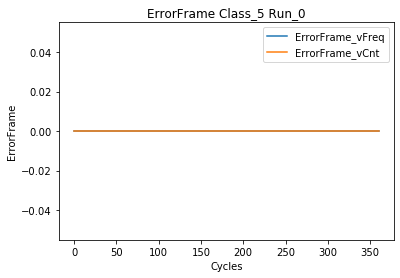

class_5_run_2
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

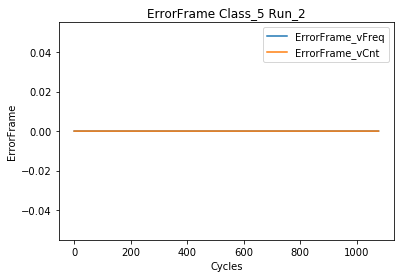

class_5_run_3
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

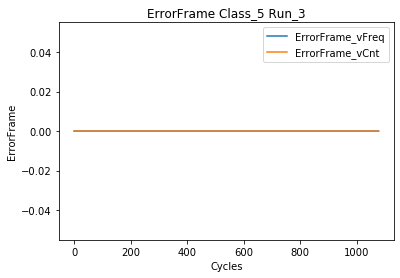

class_5_run_4
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

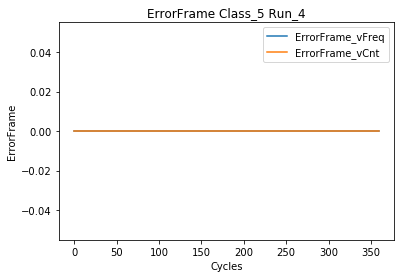

class_7_run_0
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

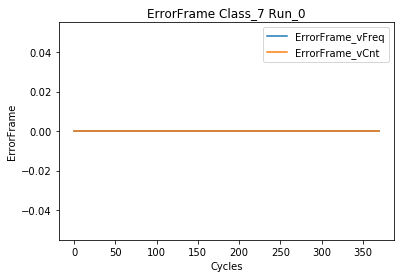

class_7_run_2
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

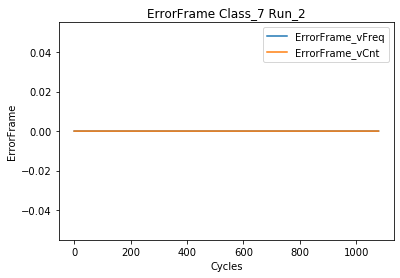

class_7_run_3
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

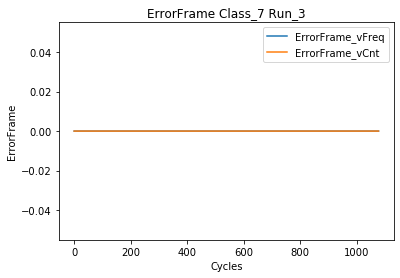

class_7_run_5
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

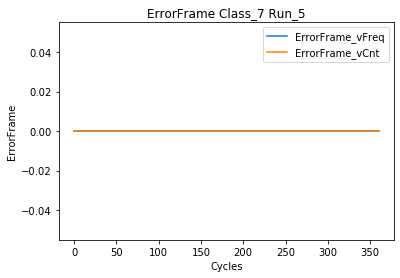

class_9_run_1
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

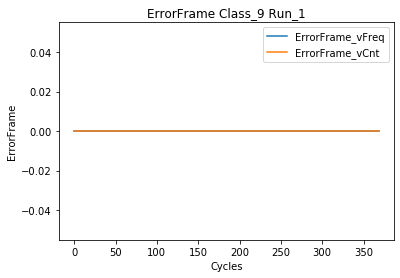

class_9_run_2
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

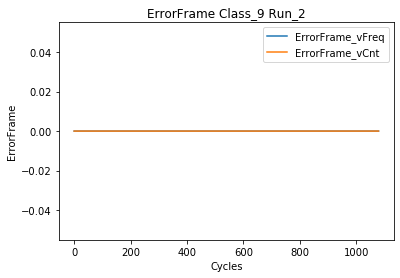

class_9_run_3
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

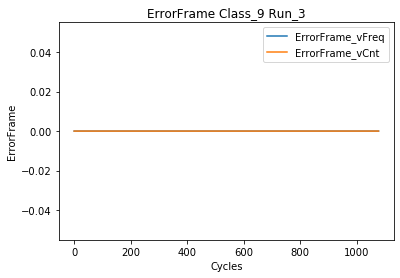

class_9_run_5
ErrorFrame_vFreq    0
ErrorFrame_vCnt     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

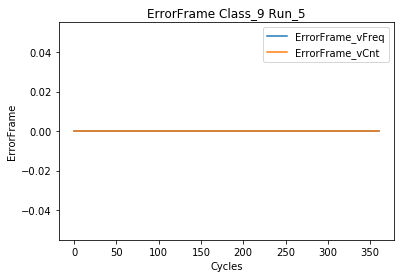

<Figure size 432x288 with 0 Axes>

In [31]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[5]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
EPOSVelocity_vMin      5
EPOSVelocity_value     5
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      5
EPOSVelocity_vStd      5
EPOSVelocity_vTrend    5
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 1296x360 with 0 Axes>

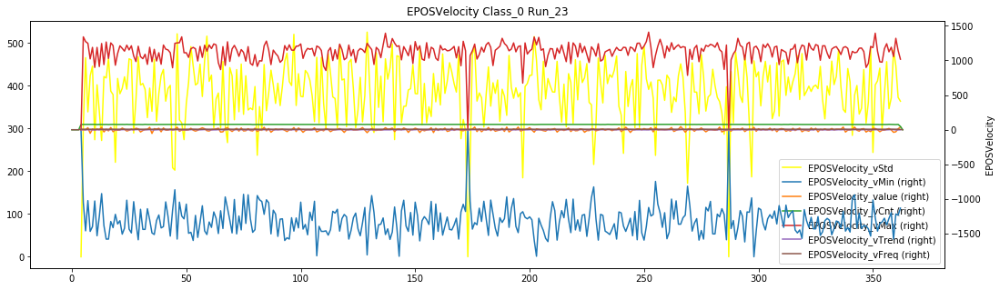

class_0_run_25
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

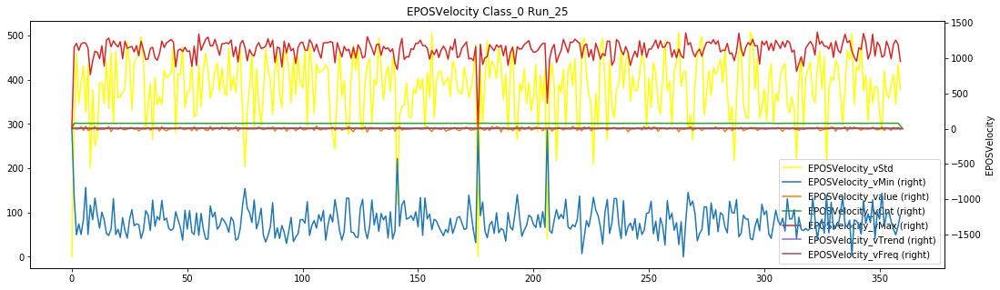

class_0_run_27
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

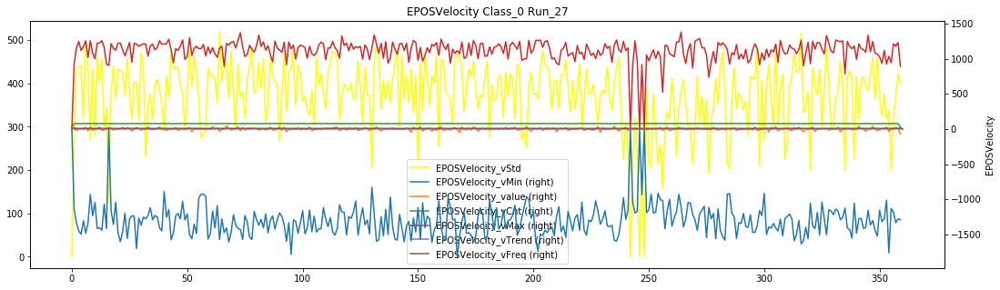

class_0_run_46
EPOSVelocity_vMin      4
EPOSVelocity_value     4
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      4
EPOSVelocity_vStd      4
EPOSVelocity_vTrend    4
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

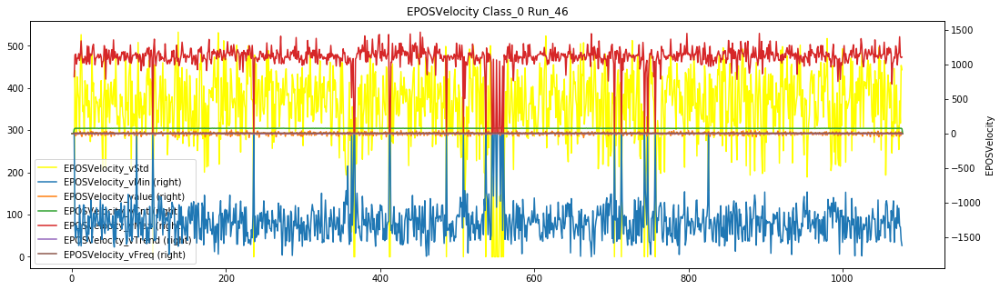

class_0_run_90
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

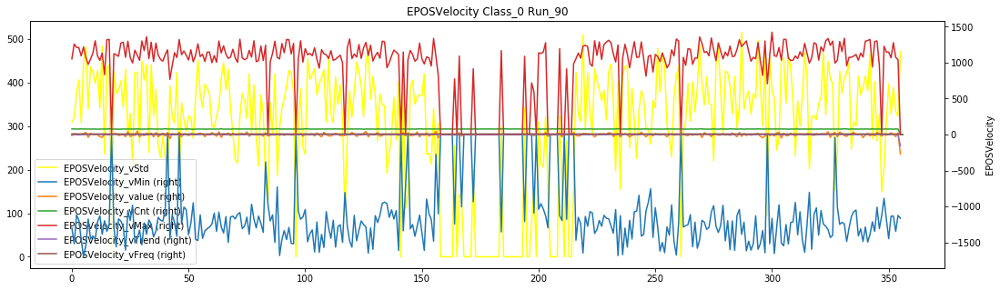

class_2_run_0
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

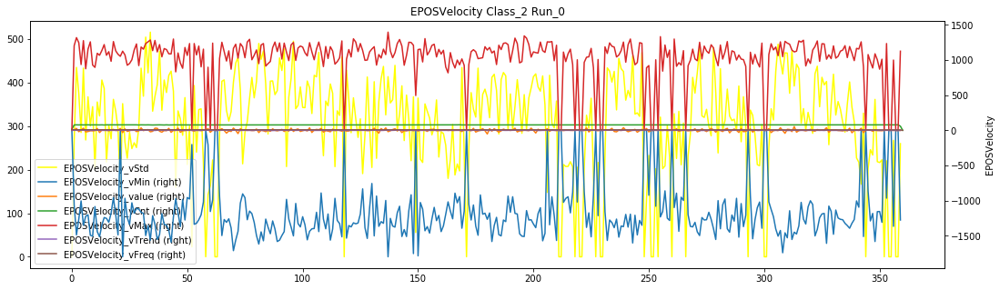

class_2_run_2
EPOSVelocity_vMin      3
EPOSVelocity_value     3
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      3
EPOSVelocity_vStd      3
EPOSVelocity_vTrend    3
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

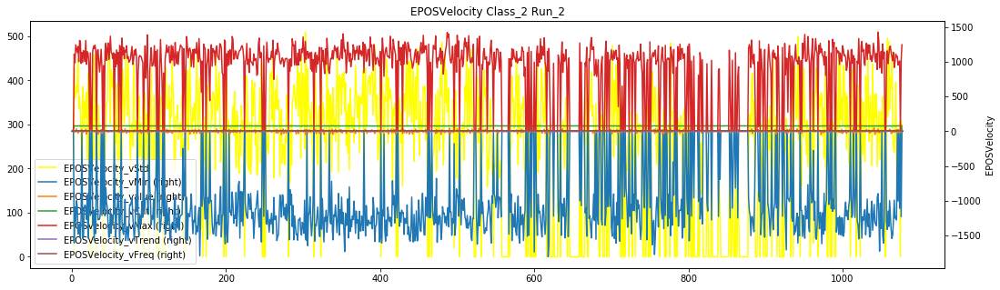

class_2_run_3
EPOSVelocity_vMin      3
EPOSVelocity_value     3
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      3
EPOSVelocity_vStd      3
EPOSVelocity_vTrend    3
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

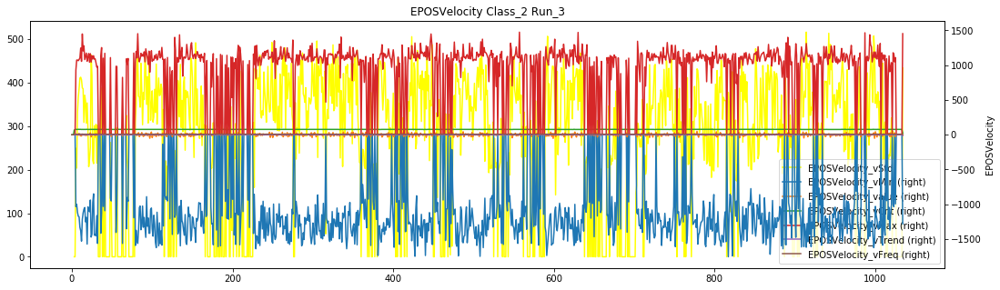

class_2_run_4
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

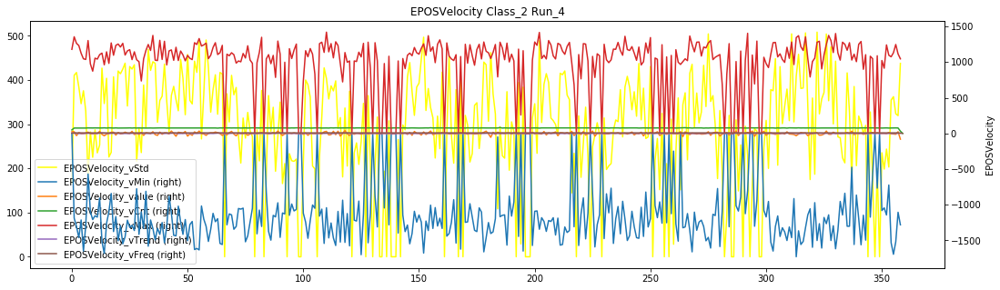

class_3_run_0
EPOSVelocity_vMin      4
EPOSVelocity_value     4
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      4
EPOSVelocity_vStd      4
EPOSVelocity_vTrend    4
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

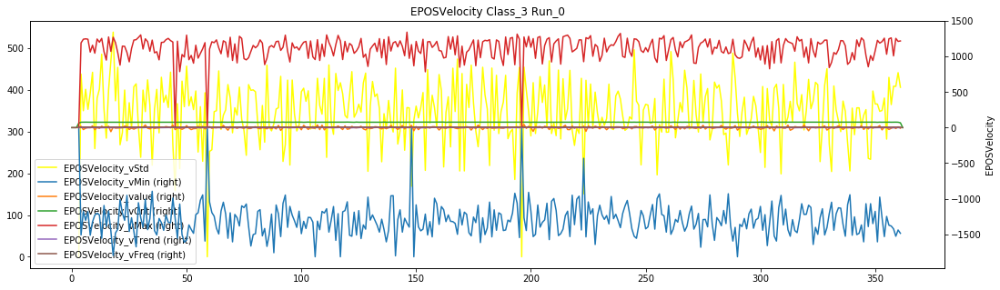

class_3_run_2
EPOSVelocity_vMin      3
EPOSVelocity_value     3
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      3
EPOSVelocity_vStd      3
EPOSVelocity_vTrend    3
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

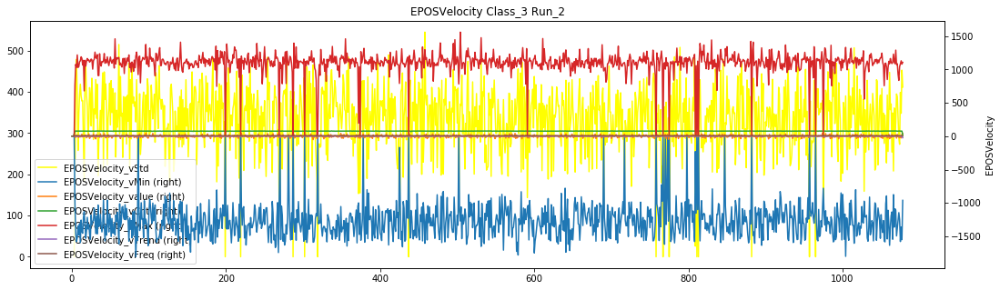

class_3_run_3
EPOSVelocity_vMin      4
EPOSVelocity_value     4
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      4
EPOSVelocity_vStd      4
EPOSVelocity_vTrend    4
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

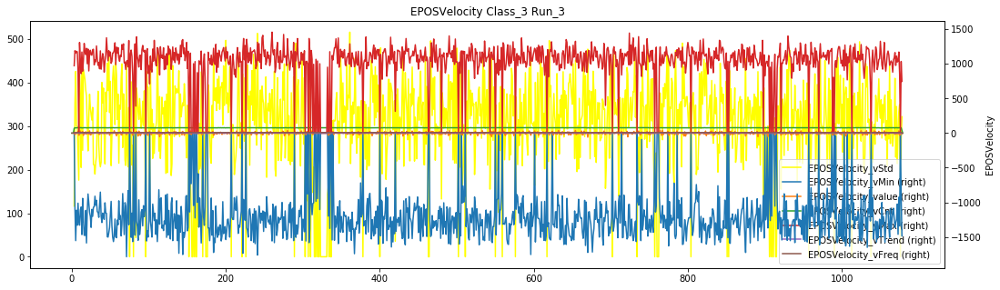

class_3_run_4
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

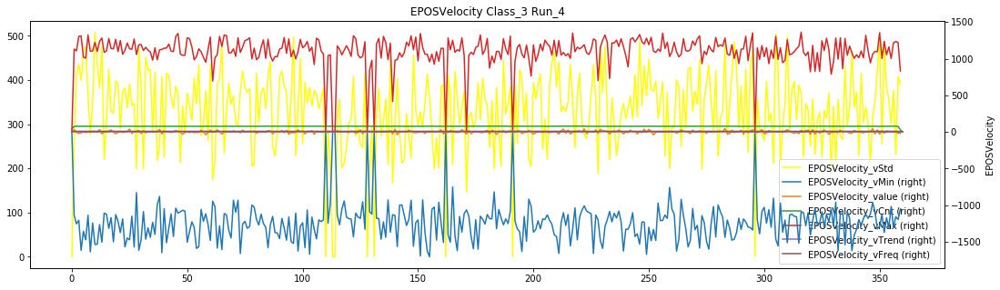

class_5_run_0
EPOSVelocity_vMin      2
EPOSVelocity_value     2
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      2
EPOSVelocity_vStd      2
EPOSVelocity_vTrend    2
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

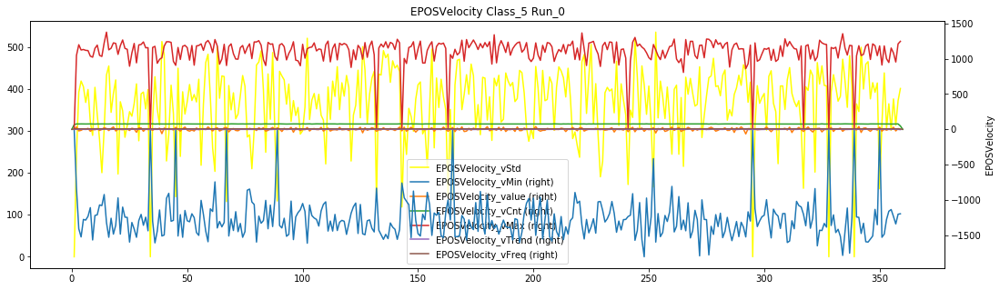

class_5_run_2
EPOSVelocity_vMin      3
EPOSVelocity_value     3
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      3
EPOSVelocity_vStd      3
EPOSVelocity_vTrend    3
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

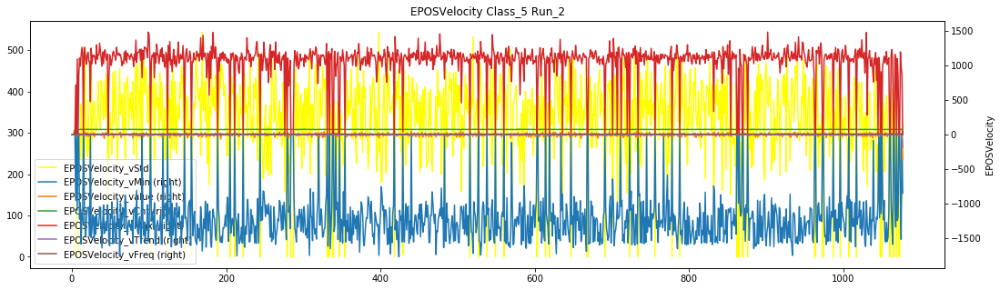

class_5_run_3
EPOSVelocity_vMin      3
EPOSVelocity_value     3
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      3
EPOSVelocity_vStd      3
EPOSVelocity_vTrend    3
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

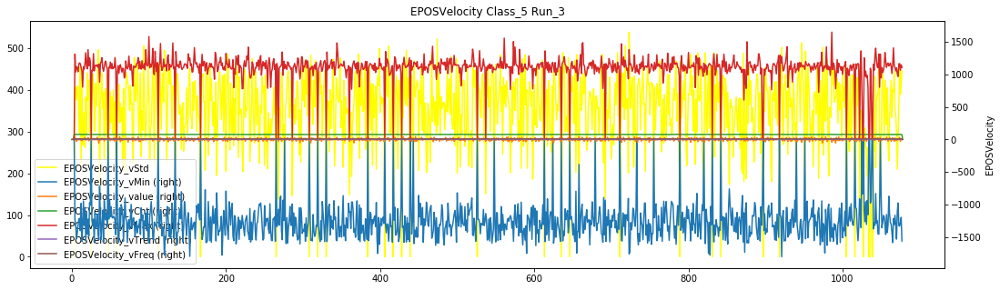

class_5_run_4
EPOSVelocity_vMin      2
EPOSVelocity_value     2
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      2
EPOSVelocity_vStd      2
EPOSVelocity_vTrend    2
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

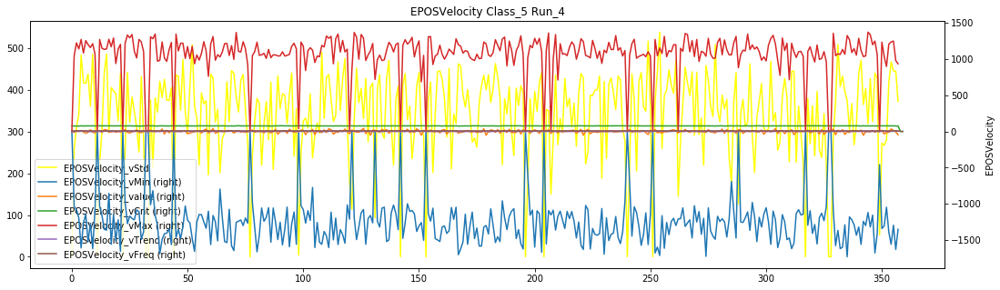

class_7_run_0
EPOSVelocity_vMin      10
EPOSVelocity_value     10
EPOSVelocity_vCnt       0
EPOSVelocity_vMax      10
EPOSVelocity_vStd      10
EPOSVelocity_vTrend    10
EPOSVelocity_vFreq      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

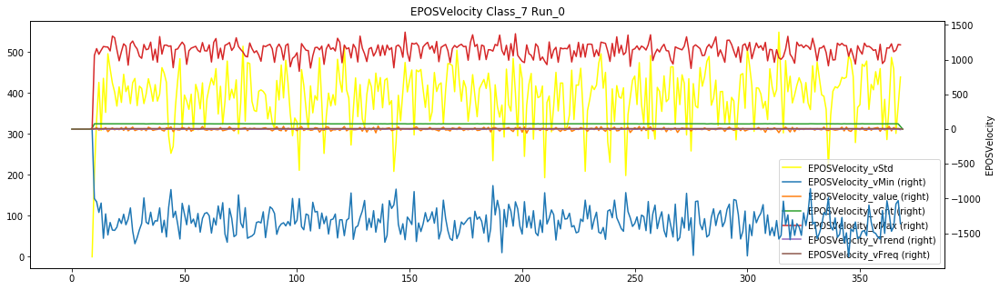

class_7_run_2
EPOSVelocity_vMin      4
EPOSVelocity_value     4
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      4
EPOSVelocity_vStd      4
EPOSVelocity_vTrend    4
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

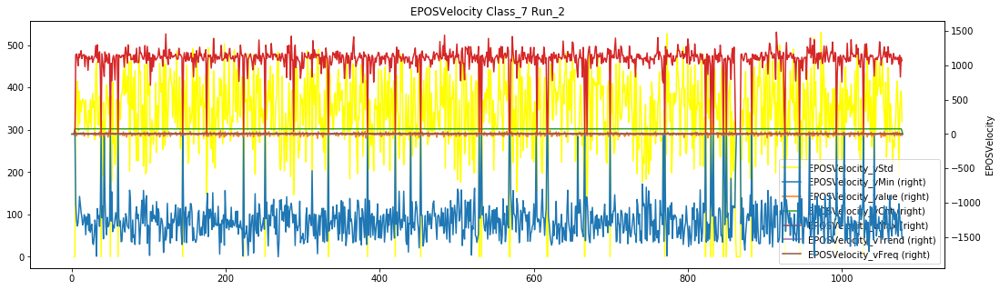

class_7_run_3
EPOSVelocity_vMin      4
EPOSVelocity_value     4
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      4
EPOSVelocity_vStd      4
EPOSVelocity_vTrend    4
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

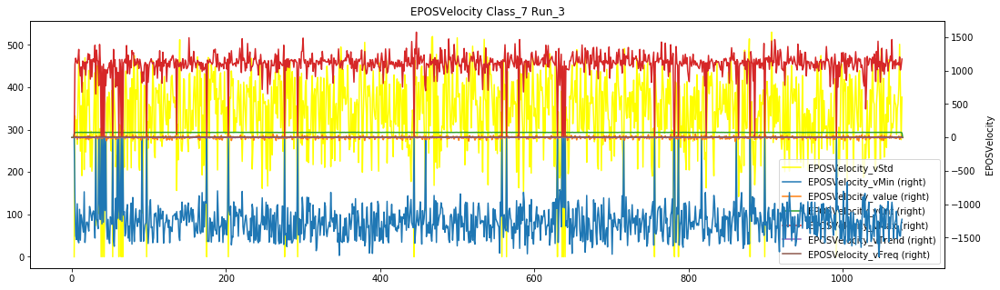

class_7_run_5
EPOSVelocity_vMin      1
EPOSVelocity_value     1
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      1
EPOSVelocity_vStd      1
EPOSVelocity_vTrend    1
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

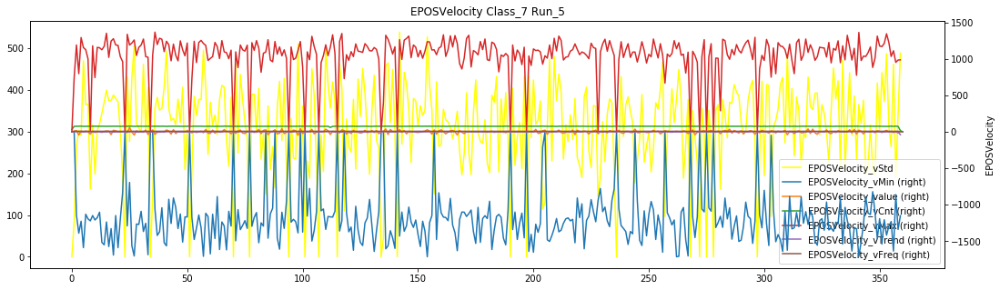

class_9_run_1
EPOSVelocity_vMin      10
EPOSVelocity_value     10
EPOSVelocity_vCnt       0
EPOSVelocity_vMax      10
EPOSVelocity_vStd      10
EPOSVelocity_vTrend    10
EPOSVelocity_vFreq      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

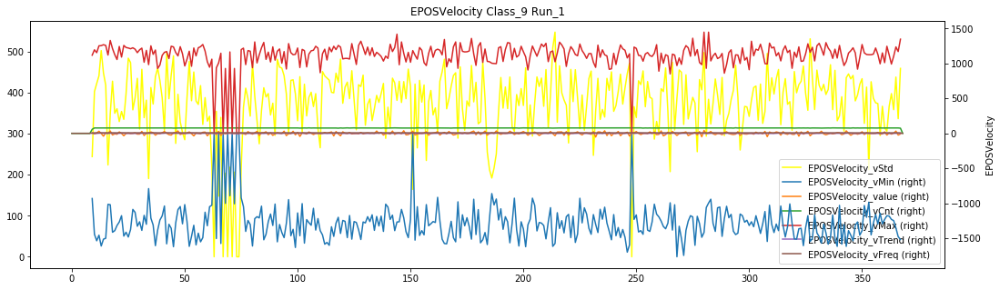

class_9_run_2
EPOSVelocity_vMin      5
EPOSVelocity_value     5
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      5
EPOSVelocity_vStd      5
EPOSVelocity_vTrend    5
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

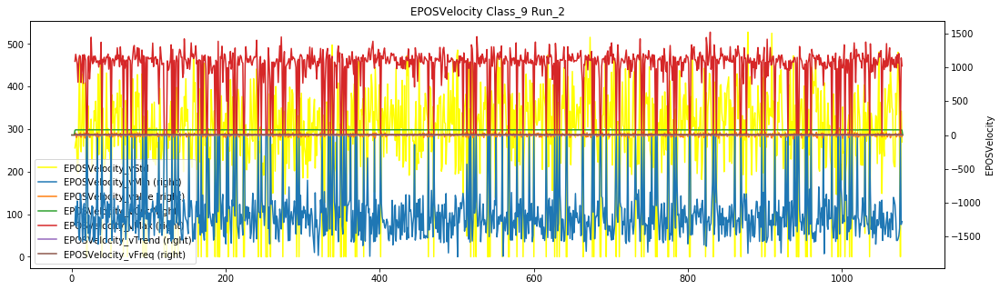

class_9_run_3
EPOSVelocity_vMin      4
EPOSVelocity_value     4
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      4
EPOSVelocity_vStd      4
EPOSVelocity_vTrend    4
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

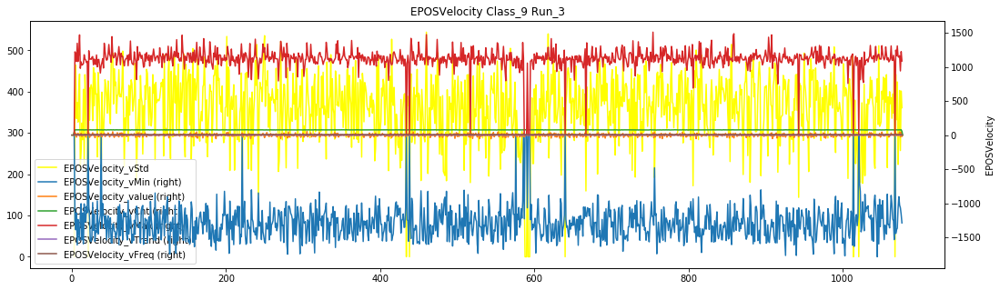

class_9_run_5
EPOSVelocity_vMin      2
EPOSVelocity_value     2
EPOSVelocity_vCnt      0
EPOSVelocity_vMax      2
EPOSVelocity_vStd      2
EPOSVelocity_vTrend    2
EPOSVelocity_vFreq     0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

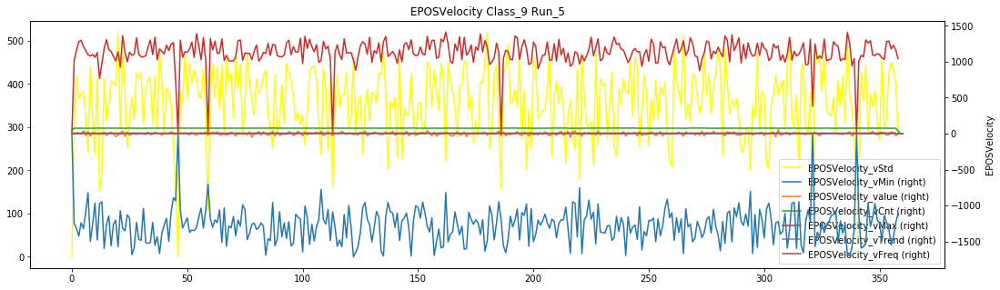

<Figure size 432x288 with 0 Axes>

In [32]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[6]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
EPOSPosition_vMin      5
EPOSPosition_vTrend    5
EPOSPosition_vStd      5
EPOSPosition_value     5
EPOSPosition_vFreq     0
EPOSPosition_vMax      5
EPOSPosition_vCnt      0
dtype: int64


<Figure size 1296x360 with 0 Axes>

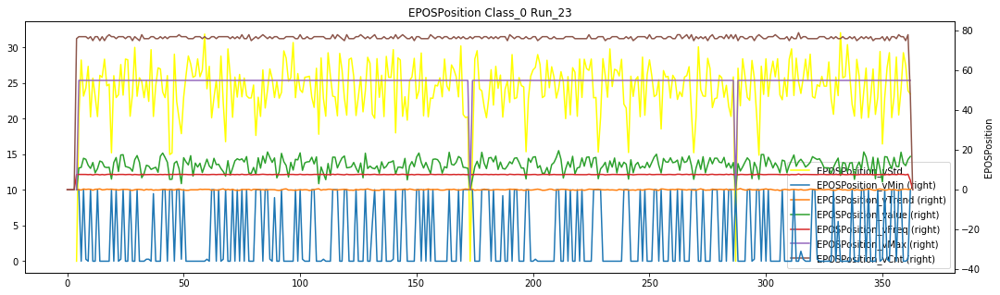

class_0_run_25
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

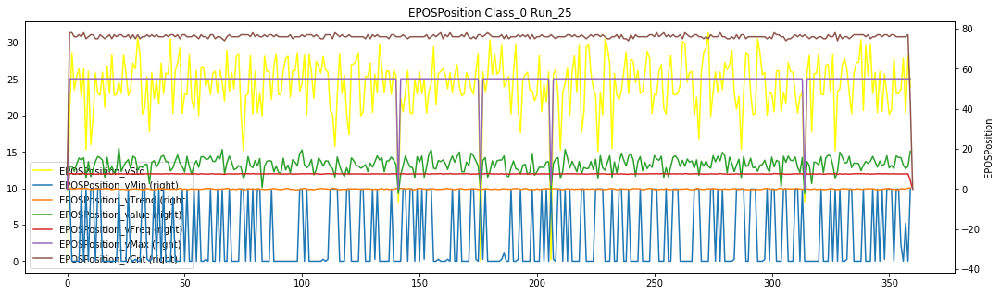

class_0_run_27
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

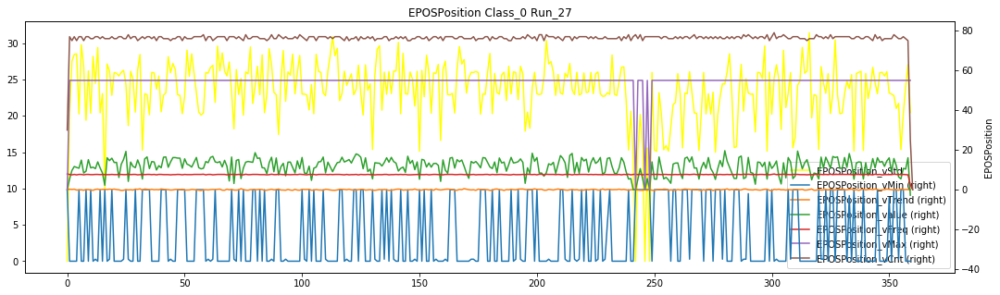

class_0_run_46
EPOSPosition_vMin      4
EPOSPosition_vTrend    4
EPOSPosition_vStd      4
EPOSPosition_value     4
EPOSPosition_vFreq     0
EPOSPosition_vMax      4
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

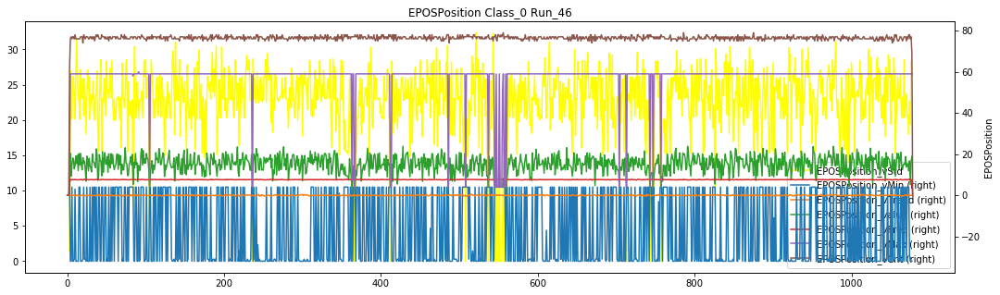

class_0_run_90
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

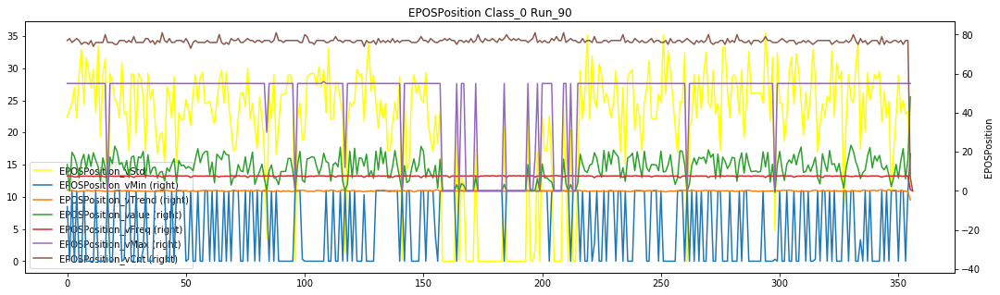

class_2_run_0
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

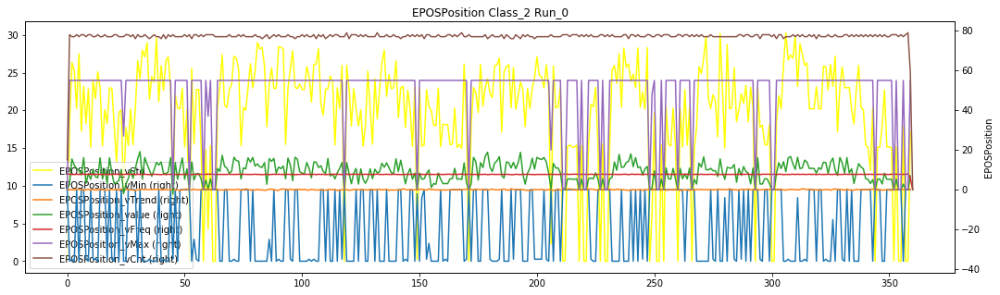

class_2_run_2
EPOSPosition_vMin      3
EPOSPosition_vTrend    3
EPOSPosition_vStd      3
EPOSPosition_value     3
EPOSPosition_vFreq     0
EPOSPosition_vMax      3
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

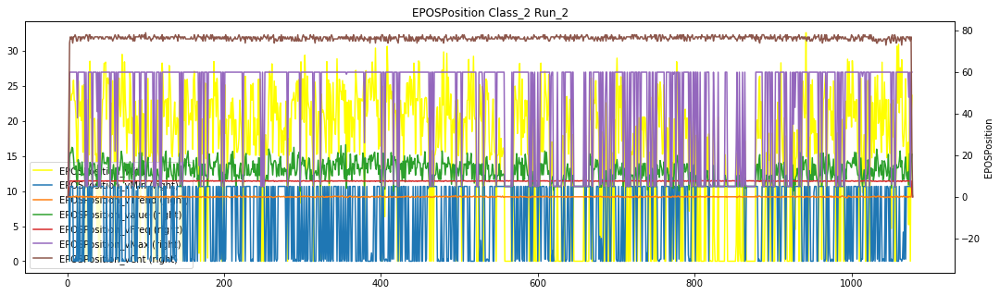

class_2_run_3
EPOSPosition_vMin      3
EPOSPosition_vTrend    3
EPOSPosition_vStd      3
EPOSPosition_value     3
EPOSPosition_vFreq     0
EPOSPosition_vMax      3
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

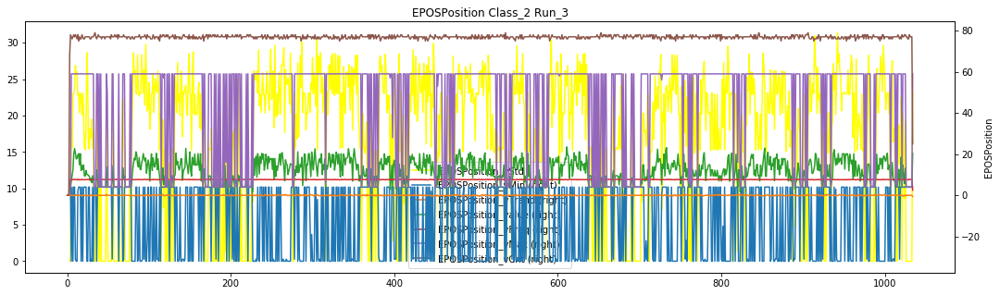

class_2_run_4
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

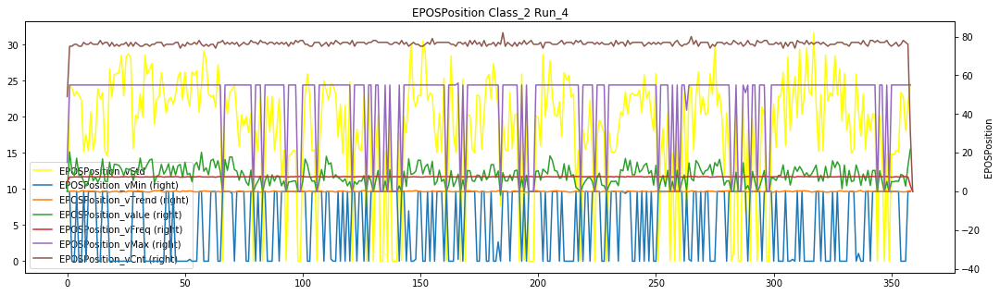

class_3_run_0
EPOSPosition_vMin      4
EPOSPosition_vTrend    4
EPOSPosition_vStd      4
EPOSPosition_value     4
EPOSPosition_vFreq     0
EPOSPosition_vMax      4
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

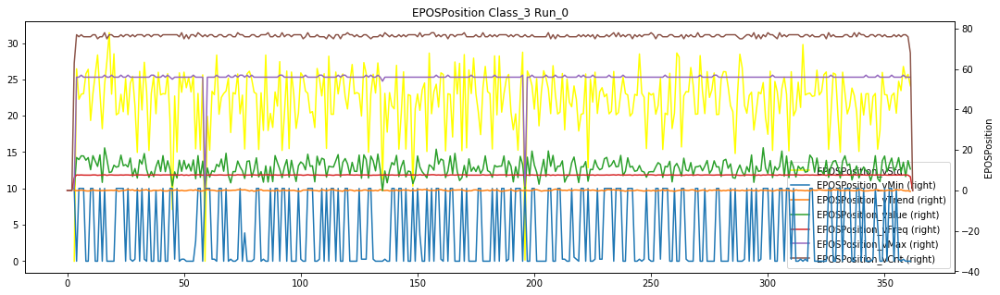

class_3_run_2
EPOSPosition_vMin      3
EPOSPosition_vTrend    3
EPOSPosition_vStd      3
EPOSPosition_value     3
EPOSPosition_vFreq     0
EPOSPosition_vMax      3
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

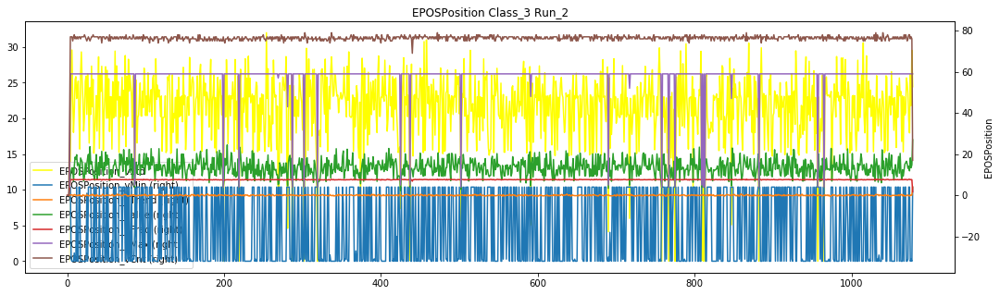

class_3_run_3
EPOSPosition_vMin      4
EPOSPosition_vTrend    4
EPOSPosition_vStd      4
EPOSPosition_value     4
EPOSPosition_vFreq     0
EPOSPosition_vMax      4
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

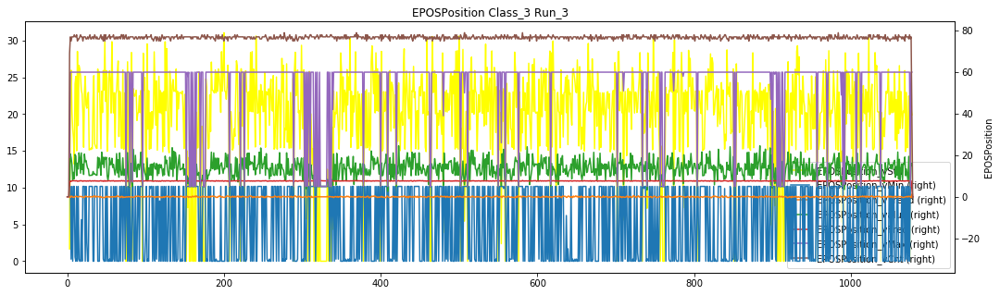

class_3_run_4
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

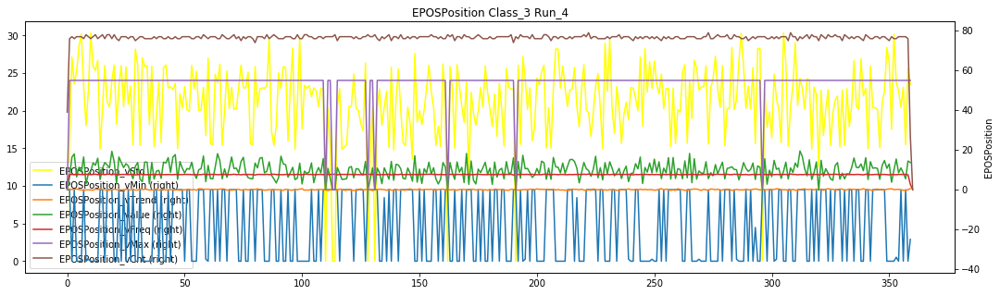

class_5_run_0
EPOSPosition_vMin      2
EPOSPosition_vTrend    2
EPOSPosition_vStd      2
EPOSPosition_value     2
EPOSPosition_vFreq     0
EPOSPosition_vMax      2
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

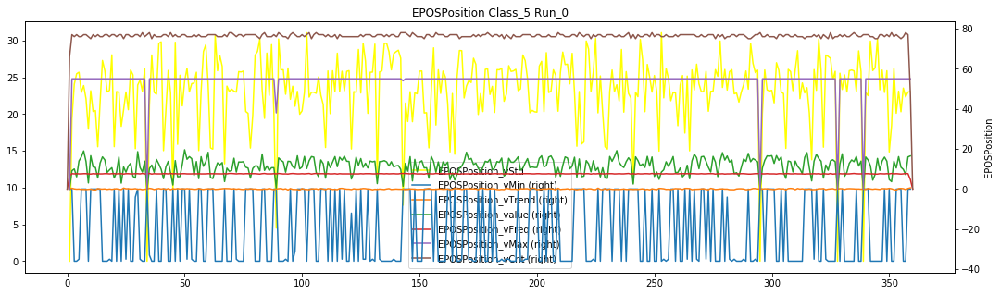

class_5_run_2
EPOSPosition_vMin      3
EPOSPosition_vTrend    3
EPOSPosition_vStd      3
EPOSPosition_value     3
EPOSPosition_vFreq     0
EPOSPosition_vMax      3
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

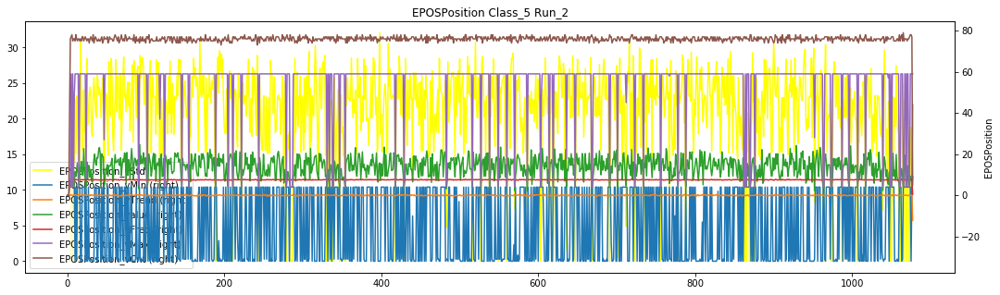

class_5_run_3
EPOSPosition_vMin      3
EPOSPosition_vTrend    3
EPOSPosition_vStd      3
EPOSPosition_value     3
EPOSPosition_vFreq     0
EPOSPosition_vMax      3
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

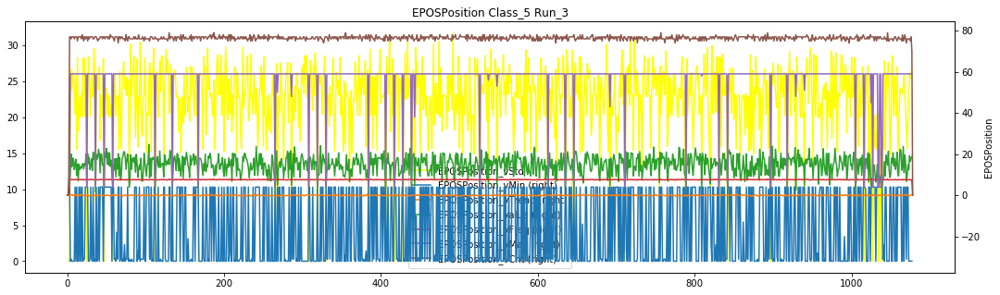

class_5_run_4
EPOSPosition_vMin      2
EPOSPosition_vTrend    2
EPOSPosition_vStd      2
EPOSPosition_value     2
EPOSPosition_vFreq     0
EPOSPosition_vMax      2
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

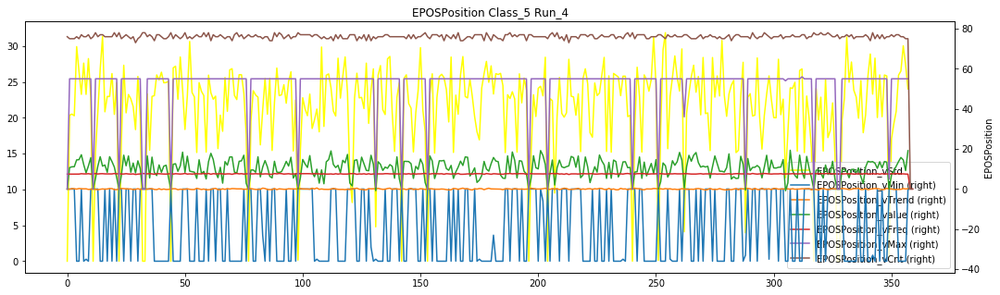

class_7_run_0
EPOSPosition_vMin      10
EPOSPosition_vTrend    10
EPOSPosition_vStd      10
EPOSPosition_value     10
EPOSPosition_vFreq      0
EPOSPosition_vMax      10
EPOSPosition_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

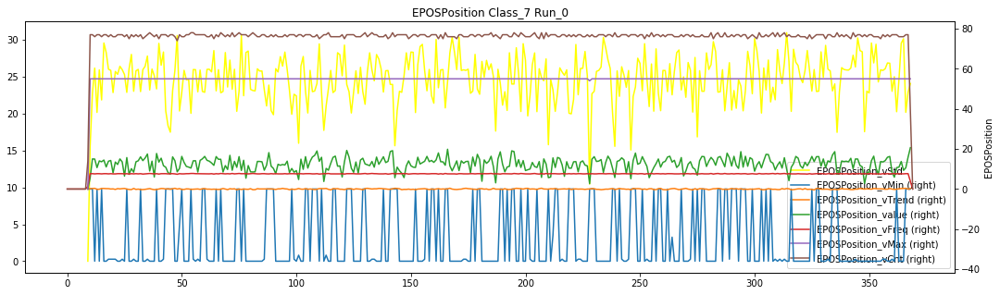

class_7_run_2
EPOSPosition_vMin      4
EPOSPosition_vTrend    4
EPOSPosition_vStd      4
EPOSPosition_value     4
EPOSPosition_vFreq     0
EPOSPosition_vMax      4
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

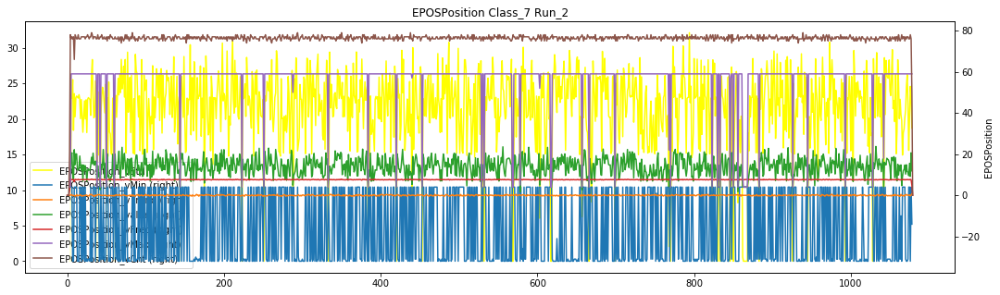

class_7_run_3
EPOSPosition_vMin      4
EPOSPosition_vTrend    4
EPOSPosition_vStd      4
EPOSPosition_value     4
EPOSPosition_vFreq     0
EPOSPosition_vMax      4
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

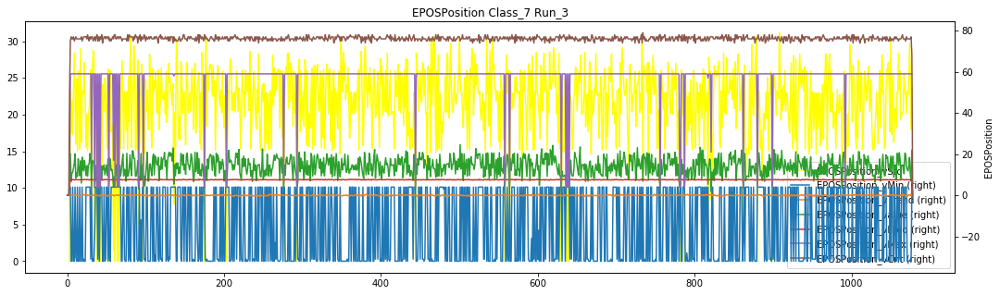

class_7_run_5
EPOSPosition_vMin      1
EPOSPosition_vTrend    1
EPOSPosition_vStd      1
EPOSPosition_value     1
EPOSPosition_vFreq     0
EPOSPosition_vMax      1
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

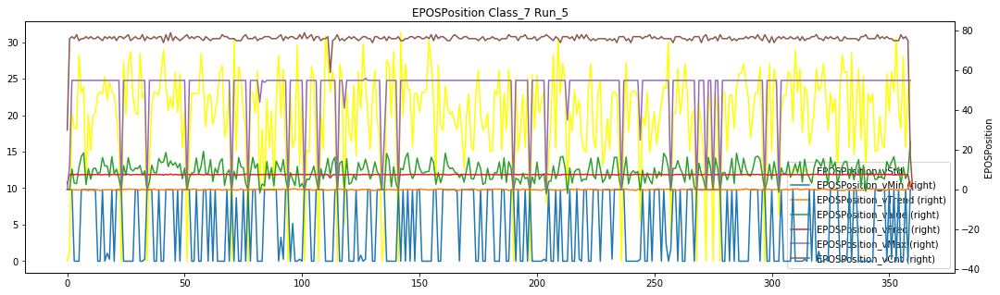

class_9_run_1
EPOSPosition_vMin      10
EPOSPosition_vTrend    10
EPOSPosition_vStd      10
EPOSPosition_value     10
EPOSPosition_vFreq      0
EPOSPosition_vMax      10
EPOSPosition_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

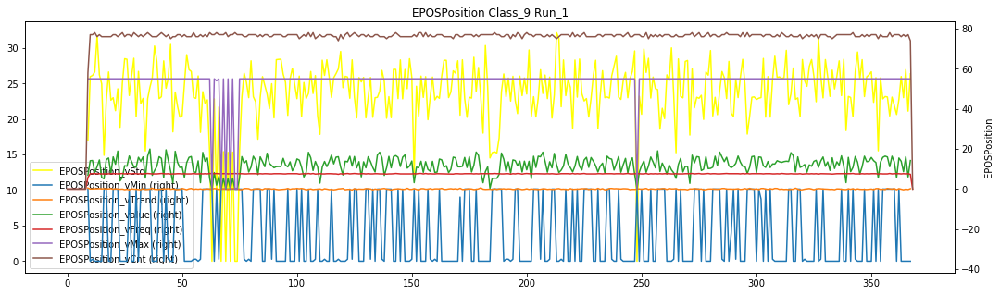

class_9_run_2
EPOSPosition_vMin      5
EPOSPosition_vTrend    5
EPOSPosition_vStd      5
EPOSPosition_value     5
EPOSPosition_vFreq     0
EPOSPosition_vMax      5
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

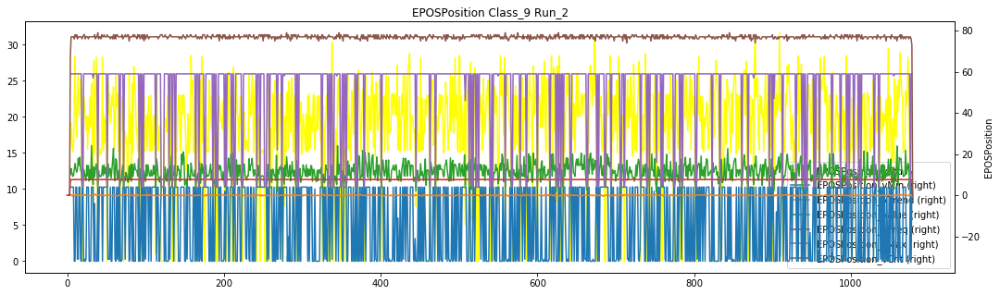

class_9_run_3
EPOSPosition_vMin      4
EPOSPosition_vTrend    4
EPOSPosition_vStd      4
EPOSPosition_value     4
EPOSPosition_vFreq     0
EPOSPosition_vMax      4
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

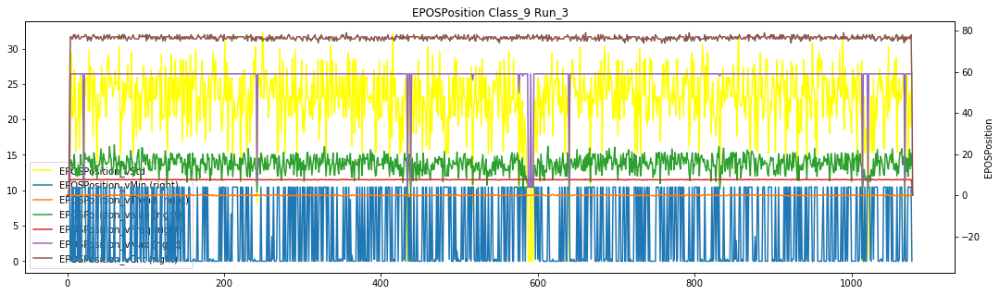

class_9_run_5
EPOSPosition_vMin      2
EPOSPosition_vTrend    2
EPOSPosition_vStd      2
EPOSPosition_value     2
EPOSPosition_vFreq     0
EPOSPosition_vMax      2
EPOSPosition_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

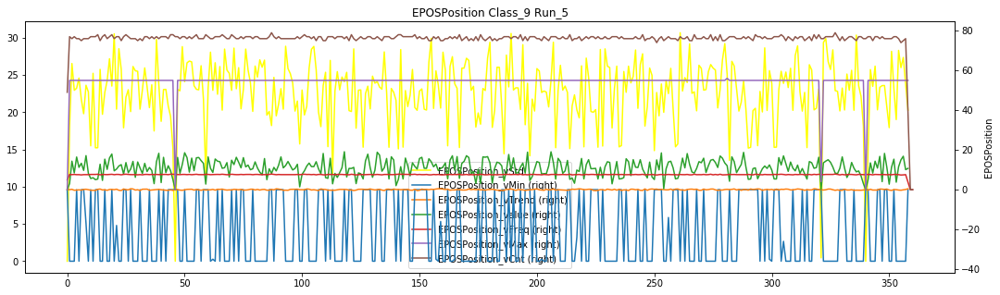

<Figure size 432x288 with 0 Axes>

In [33]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[7]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      5
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      5
EPOSCurrent_vMin      5
EPOSCurrent_vTrend    5
EPOSCurrent_value     5
dtype: int64


<Figure size 1296x360 with 0 Axes>

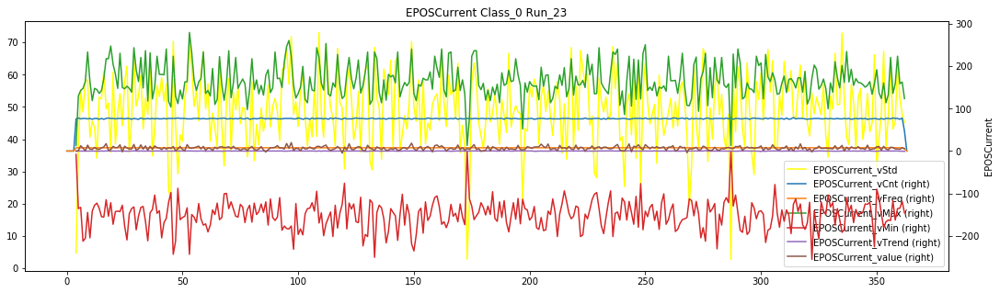

class_0_run_25
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

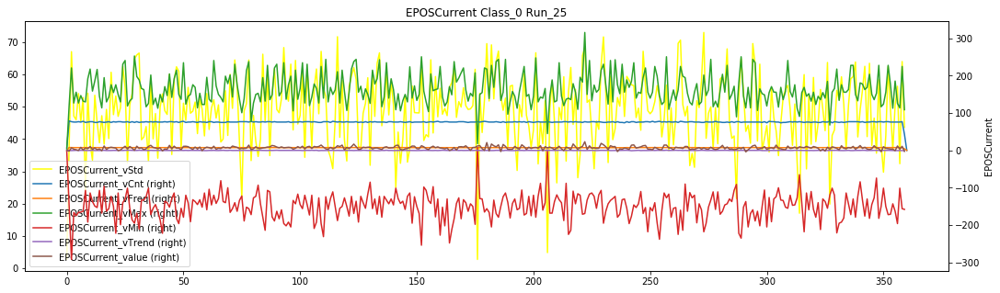

class_0_run_27
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

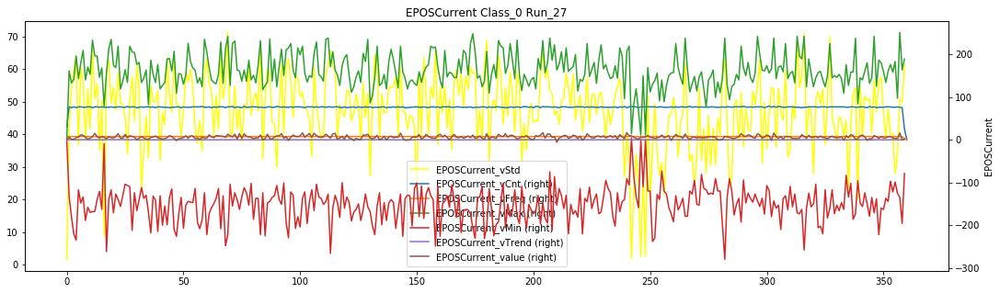

class_0_run_46
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      4
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      4
EPOSCurrent_vMin      4
EPOSCurrent_vTrend    4
EPOSCurrent_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

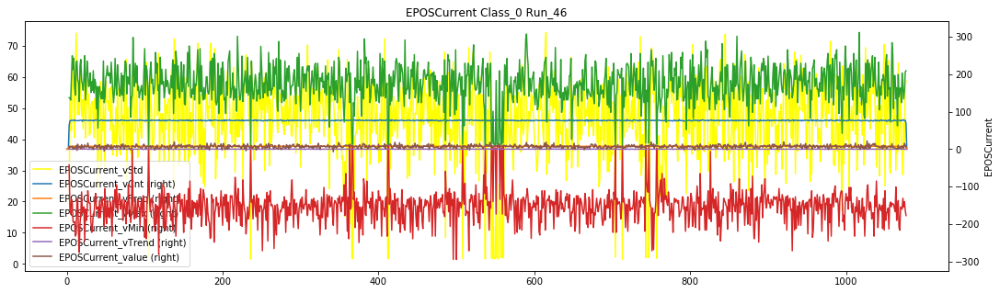

class_0_run_90
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

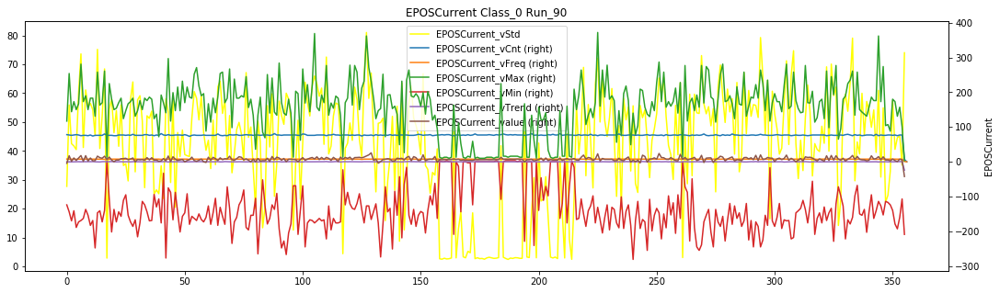

class_2_run_0
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

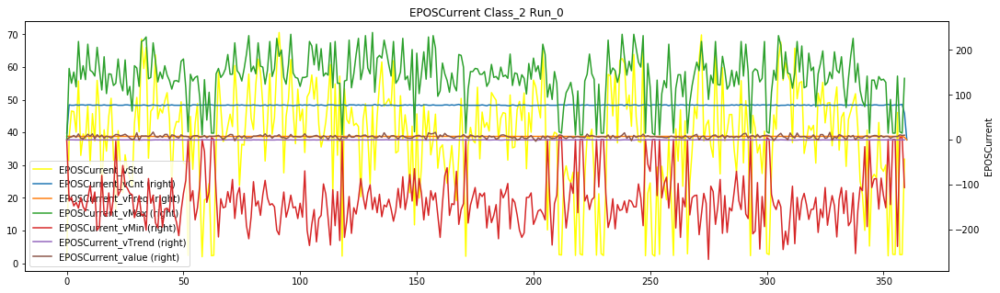

class_2_run_2
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      3
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      3
EPOSCurrent_vMin      3
EPOSCurrent_vTrend    3
EPOSCurrent_value     3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

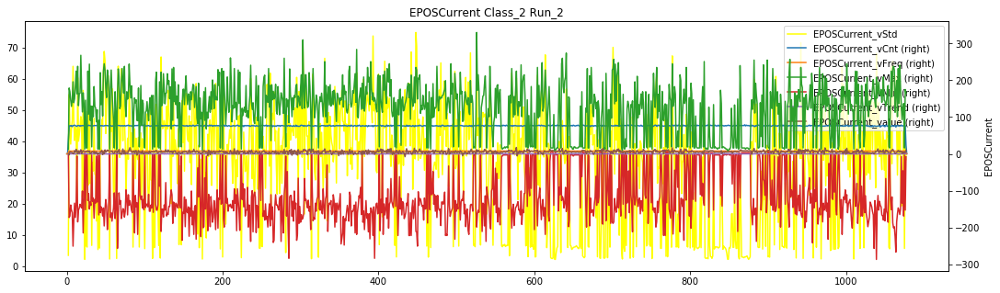

class_2_run_3
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      3
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      3
EPOSCurrent_vMin      3
EPOSCurrent_vTrend    3
EPOSCurrent_value     3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

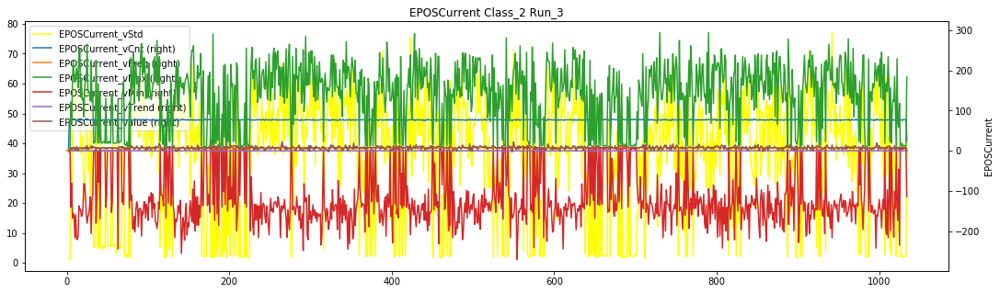

class_2_run_4
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

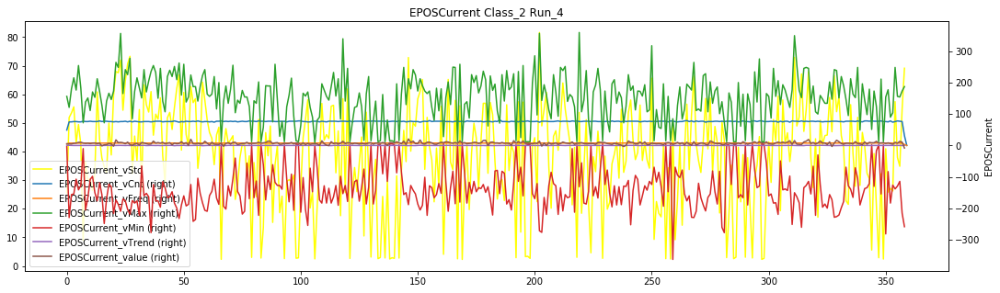

class_3_run_0
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      4
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      4
EPOSCurrent_vMin      4
EPOSCurrent_vTrend    4
EPOSCurrent_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

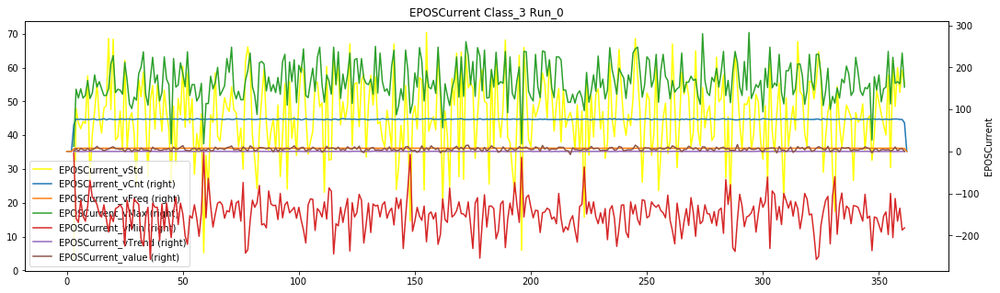

class_3_run_2
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      3
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      3
EPOSCurrent_vMin      3
EPOSCurrent_vTrend    3
EPOSCurrent_value     3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

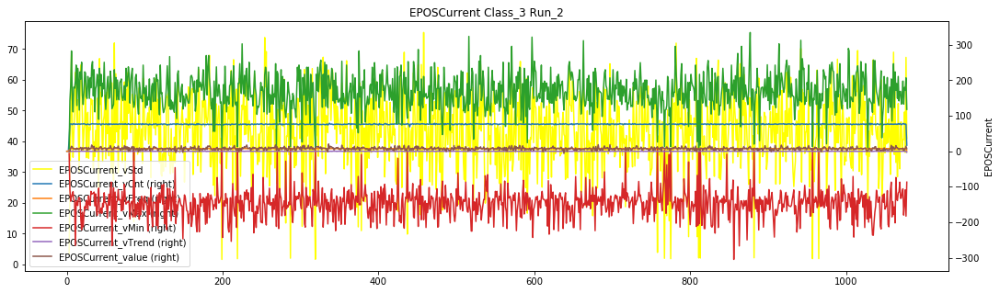

class_3_run_3
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      4
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      4
EPOSCurrent_vMin      4
EPOSCurrent_vTrend    4
EPOSCurrent_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

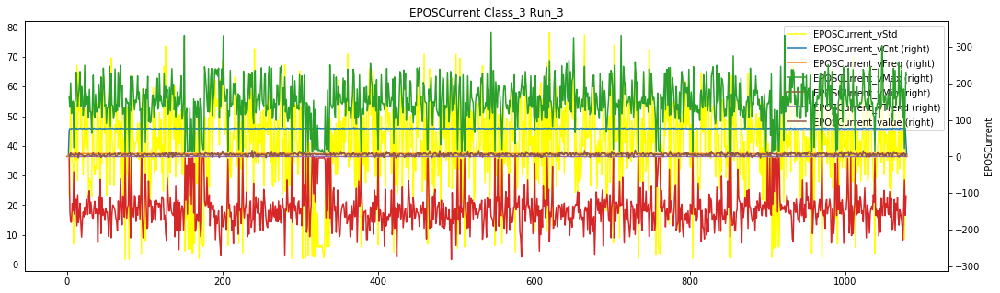

class_3_run_4
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

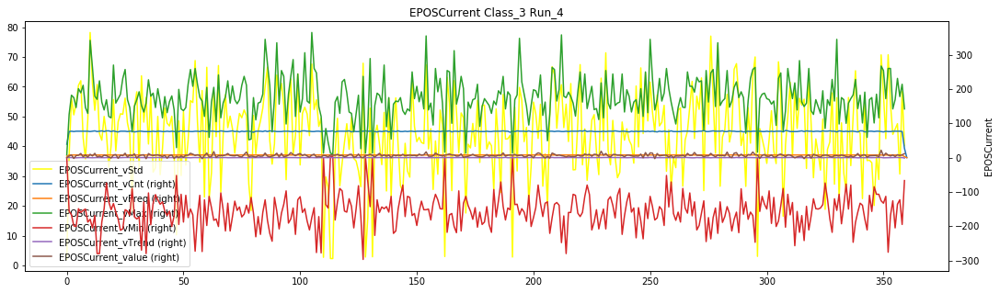

class_5_run_0
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      2
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      2
EPOSCurrent_vMin      2
EPOSCurrent_vTrend    2
EPOSCurrent_value     2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

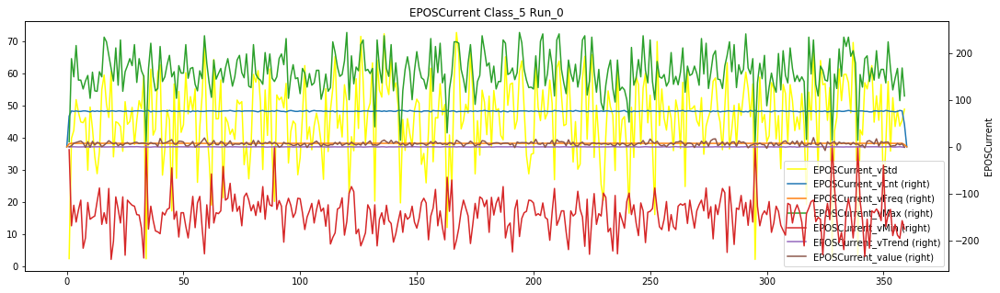

class_5_run_2
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      3
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      3
EPOSCurrent_vMin      3
EPOSCurrent_vTrend    3
EPOSCurrent_value     3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

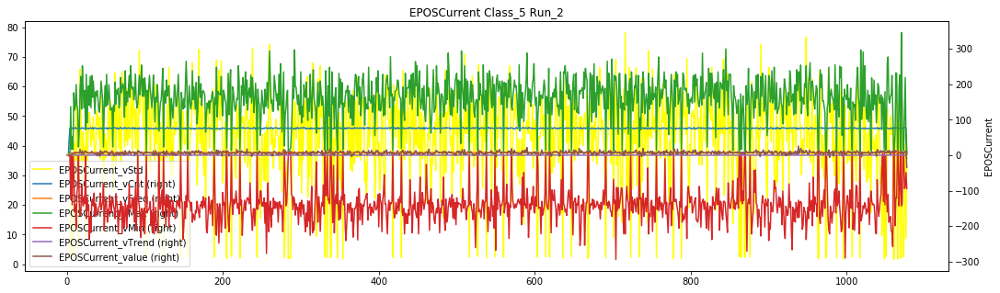

class_5_run_3
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      3
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      3
EPOSCurrent_vMin      3
EPOSCurrent_vTrend    3
EPOSCurrent_value     3
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

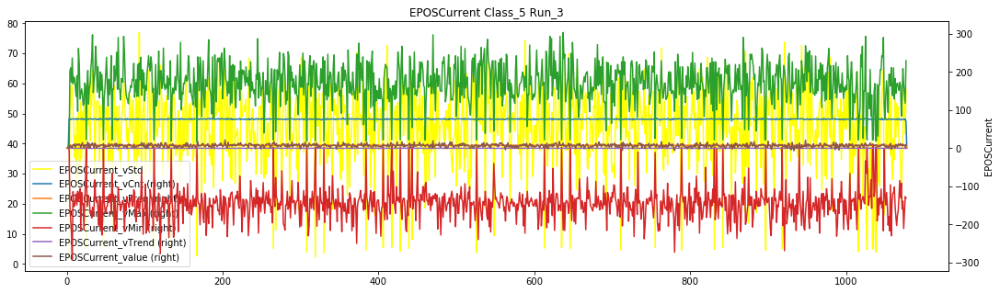

class_5_run_4
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      2
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      2
EPOSCurrent_vMin      2
EPOSCurrent_vTrend    2
EPOSCurrent_value     2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

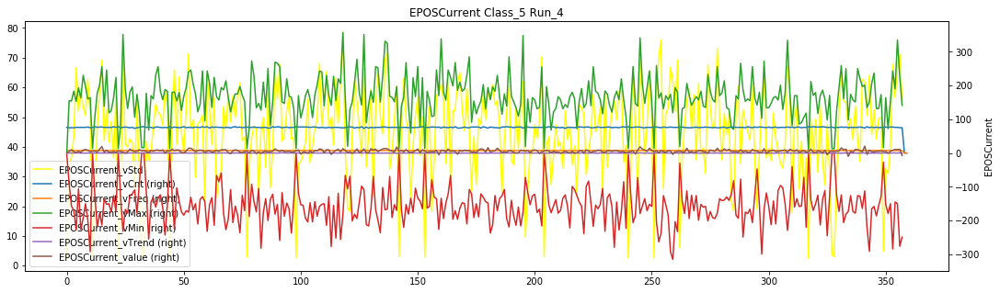

class_7_run_0
EPOSCurrent_vCnt       0
EPOSCurrent_vStd      10
EPOSCurrent_vFreq      0
EPOSCurrent_vMax      10
EPOSCurrent_vMin      10
EPOSCurrent_vTrend    10
EPOSCurrent_value     10
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

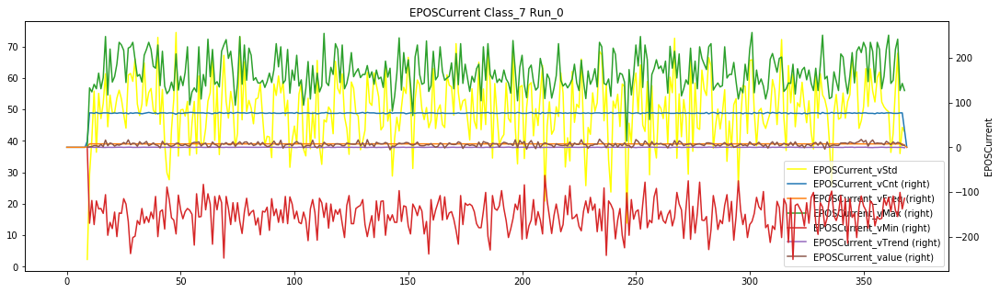

class_7_run_2
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      4
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      4
EPOSCurrent_vMin      4
EPOSCurrent_vTrend    4
EPOSCurrent_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

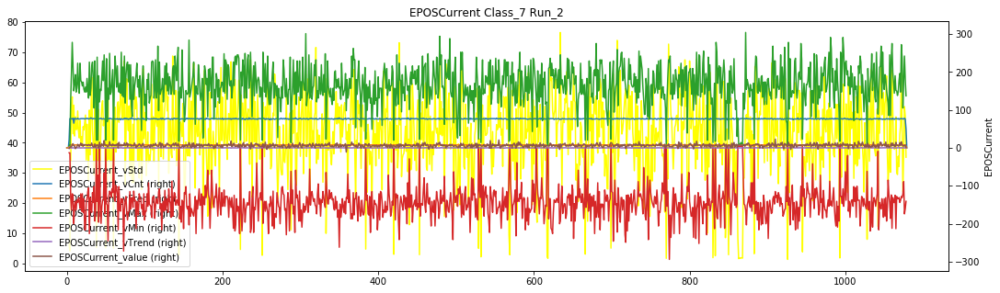

class_7_run_3
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      4
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      4
EPOSCurrent_vMin      4
EPOSCurrent_vTrend    4
EPOSCurrent_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

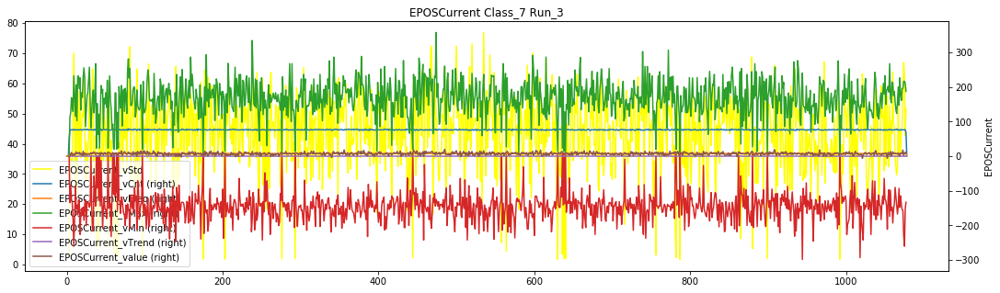

class_7_run_5
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      1
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      1
EPOSCurrent_vMin      1
EPOSCurrent_vTrend    1
EPOSCurrent_value     1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

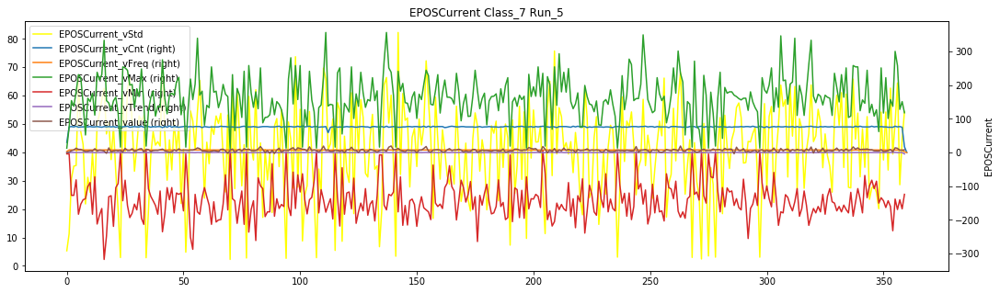

class_9_run_1
EPOSCurrent_vCnt       0
EPOSCurrent_vStd      10
EPOSCurrent_vFreq      0
EPOSCurrent_vMax      10
EPOSCurrent_vMin      10
EPOSCurrent_vTrend    10
EPOSCurrent_value     10
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

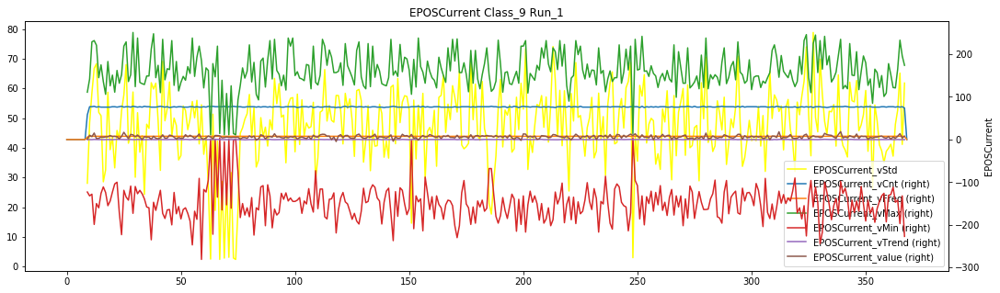

class_9_run_2
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      5
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      5
EPOSCurrent_vMin      5
EPOSCurrent_vTrend    5
EPOSCurrent_value     5
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

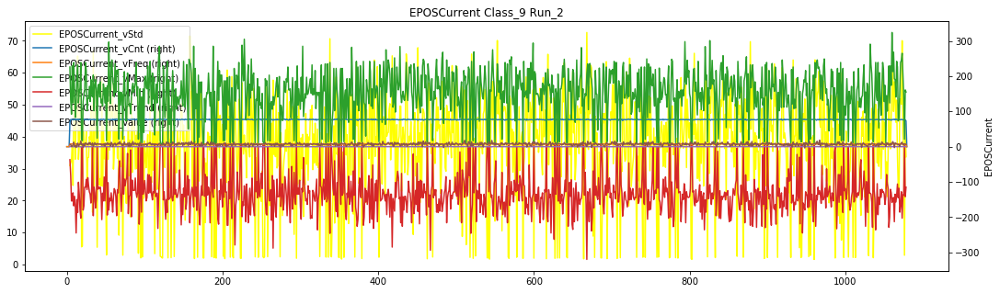

class_9_run_3
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      4
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      4
EPOSCurrent_vMin      4
EPOSCurrent_vTrend    4
EPOSCurrent_value     4
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

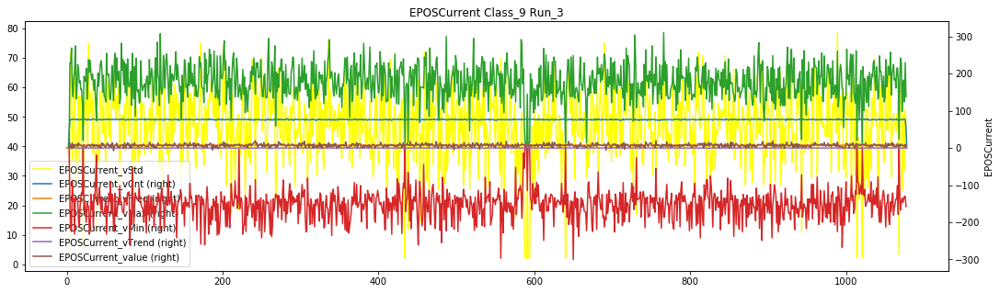

class_9_run_5
EPOSCurrent_vCnt      0
EPOSCurrent_vStd      2
EPOSCurrent_vFreq     0
EPOSCurrent_vMax      2
EPOSCurrent_vMin      2
EPOSCurrent_vTrend    2
EPOSCurrent_value     2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

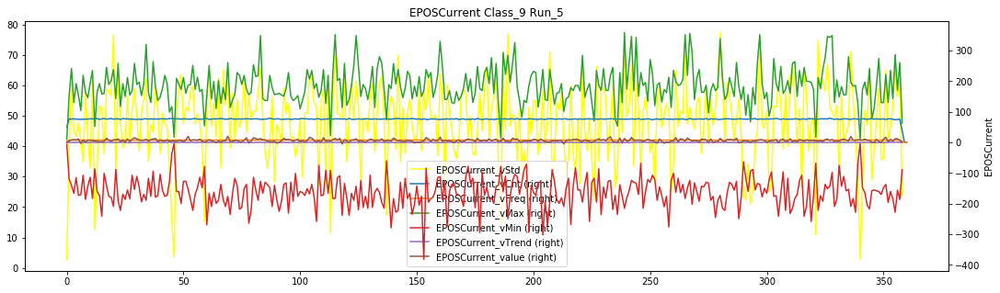

<Figure size 432x288 with 0 Axes>

In [34]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[8]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      5
DurationPickToPick_value     5
DurationPickToPick_vTrend    6
DurationPickToPick_vStd      5
DurationPickToPick_vMin      5
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 1296x360 with 0 Axes>

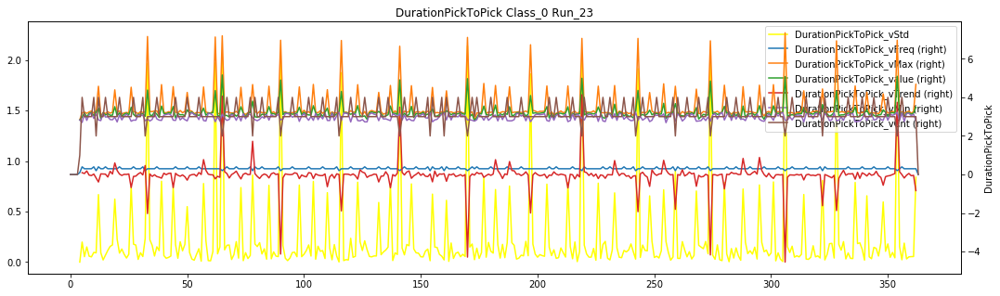

class_0_run_25
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      2
DurationPickToPick_value     2
DurationPickToPick_vTrend    2
DurationPickToPick_vStd      2
DurationPickToPick_vMin      2
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

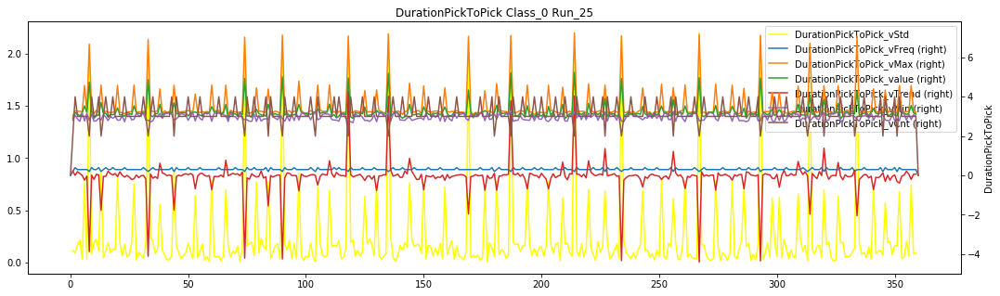

class_0_run_27
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      2
DurationPickToPick_value     2
DurationPickToPick_vTrend    2
DurationPickToPick_vStd      2
DurationPickToPick_vMin      2
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

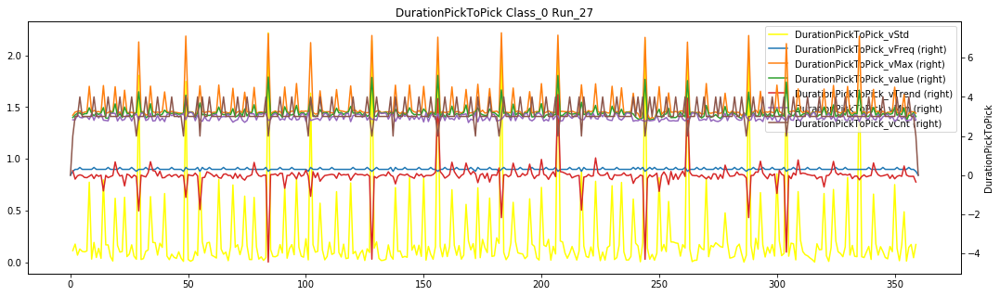

class_0_run_46
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      4
DurationPickToPick_value     4
DurationPickToPick_vTrend    6
DurationPickToPick_vStd      4
DurationPickToPick_vMin      4
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

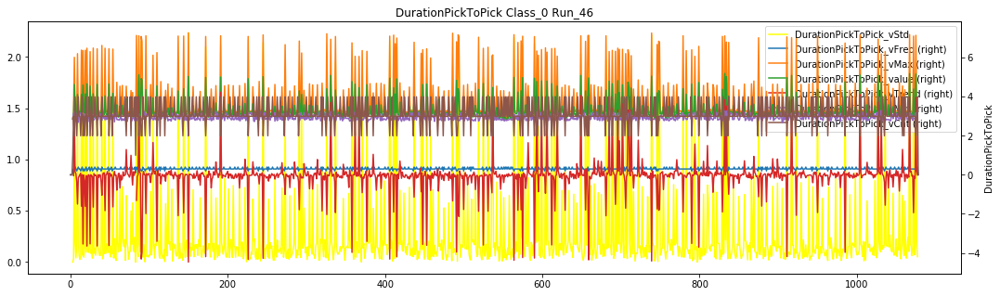

class_0_run_90
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      1
DurationPickToPick_value     1
DurationPickToPick_vTrend    5
DurationPickToPick_vStd      1
DurationPickToPick_vMin      1
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

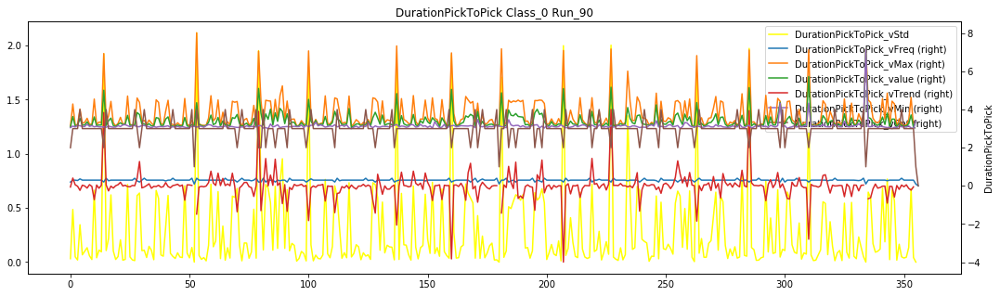

class_2_run_0
DurationPickToPick_vFreq      0
DurationPickToPick_vMax      13
DurationPickToPick_value     13
DurationPickToPick_vTrend    61
DurationPickToPick_vStd      13
DurationPickToPick_vMin      13
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

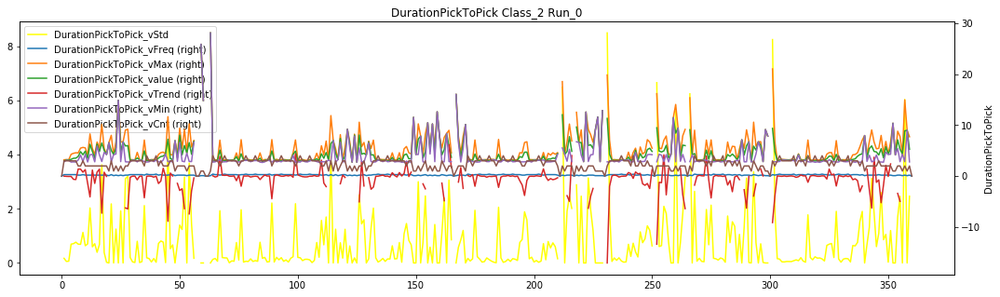

class_2_run_2
DurationPickToPick_vFreq       0
DurationPickToPick_vMax       49
DurationPickToPick_value      49
DurationPickToPick_vTrend    202
DurationPickToPick_vStd       49
DurationPickToPick_vMin       49
DurationPickToPick_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

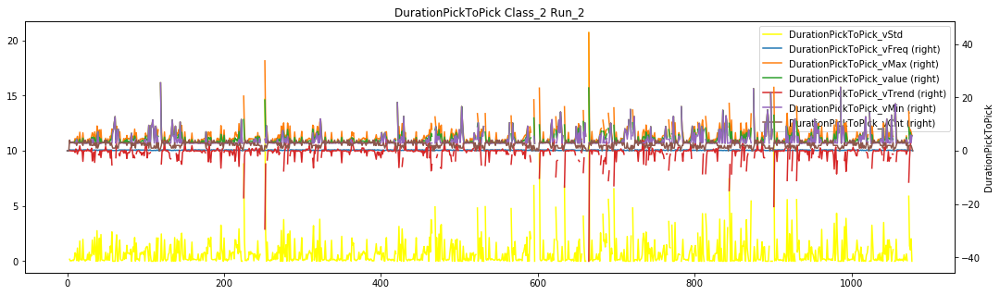

class_2_run_3
DurationPickToPick_vFreq       0
DurationPickToPick_vMax      145
DurationPickToPick_value     145
DurationPickToPick_vTrend    336
DurationPickToPick_vStd      145
DurationPickToPick_vMin      145
DurationPickToPick_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

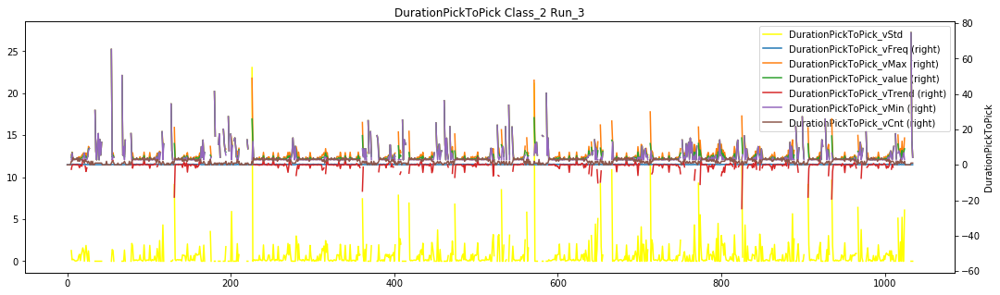

class_2_run_4
DurationPickToPick_vFreq       0
DurationPickToPick_vMax       25
DurationPickToPick_value      25
DurationPickToPick_vTrend    109
DurationPickToPick_vStd       25
DurationPickToPick_vMin       25
DurationPickToPick_vCnt        0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

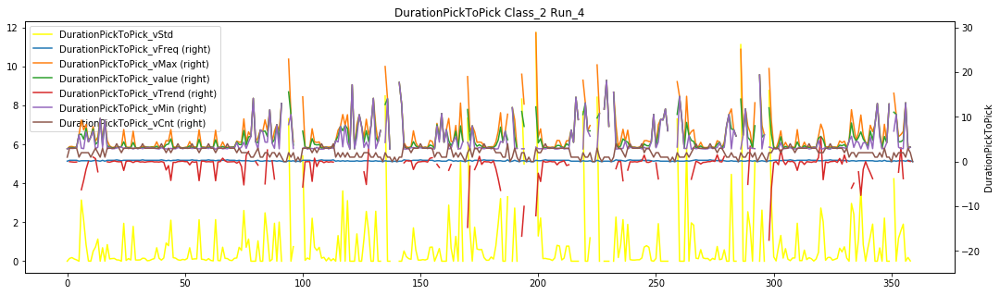

class_3_run_0
DurationPickToPick_vFreq      0
DurationPickToPick_vMax       4
DurationPickToPick_value      4
DurationPickToPick_vTrend    13
DurationPickToPick_vStd       4
DurationPickToPick_vMin       4
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

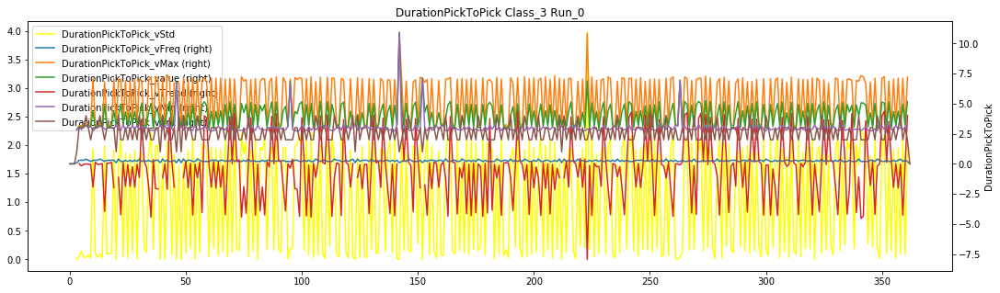

class_3_run_2
DurationPickToPick_vFreq      0
DurationPickToPick_vMax       4
DurationPickToPick_value      4
DurationPickToPick_vTrend    35
DurationPickToPick_vStd       4
DurationPickToPick_vMin       4
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

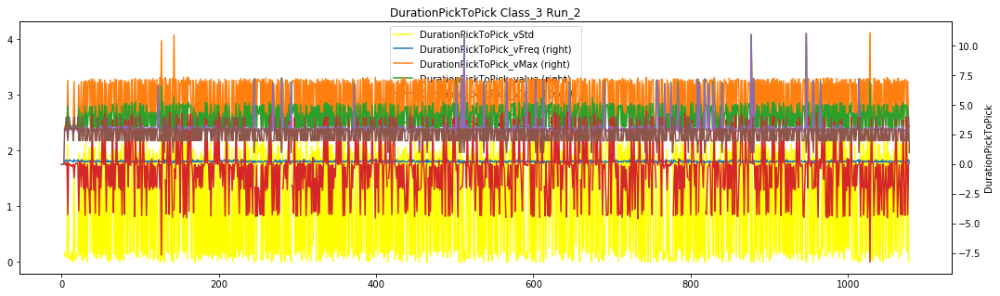

class_3_run_3
DurationPickToPick_vFreq      0
DurationPickToPick_vMax       5
DurationPickToPick_value      5
DurationPickToPick_vTrend    44
DurationPickToPick_vStd       5
DurationPickToPick_vMin       5
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

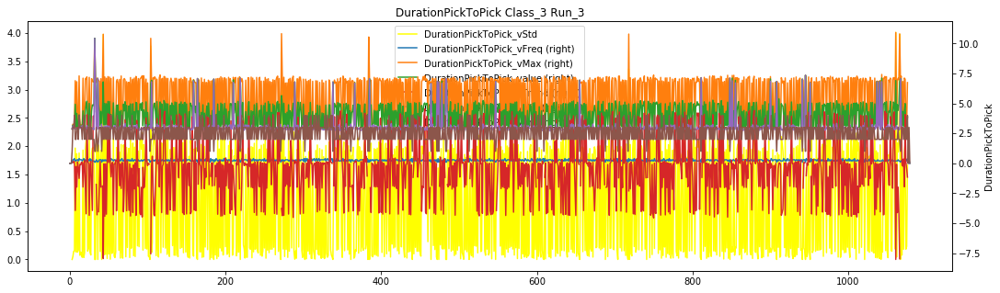

class_3_run_4
DurationPickToPick_vFreq      0
DurationPickToPick_vMax       2
DurationPickToPick_value      2
DurationPickToPick_vTrend    10
DurationPickToPick_vStd       2
DurationPickToPick_vMin       2
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

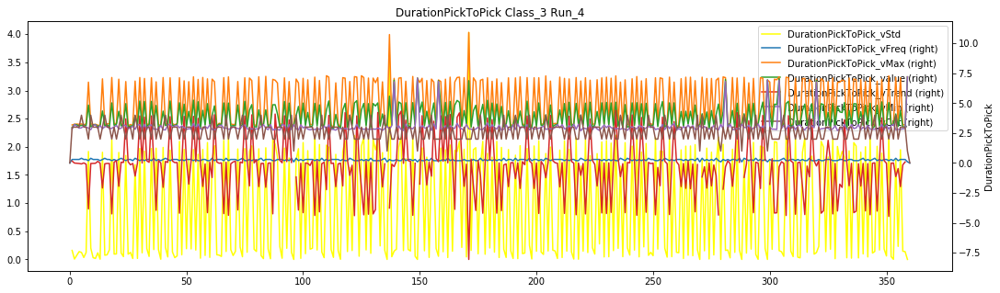

class_5_run_0
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      2
DurationPickToPick_value     2
DurationPickToPick_vTrend    3
DurationPickToPick_vStd      2
DurationPickToPick_vMin      2
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

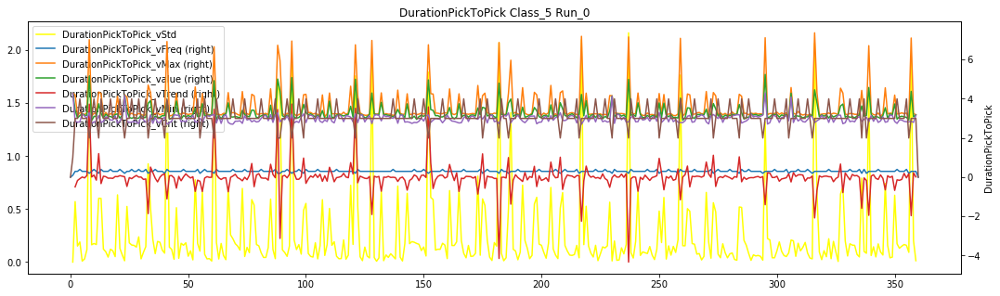

class_5_run_2
DurationPickToPick_vFreq      0
DurationPickToPick_vMax       4
DurationPickToPick_value      4
DurationPickToPick_vTrend    10
DurationPickToPick_vStd       4
DurationPickToPick_vMin       4
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

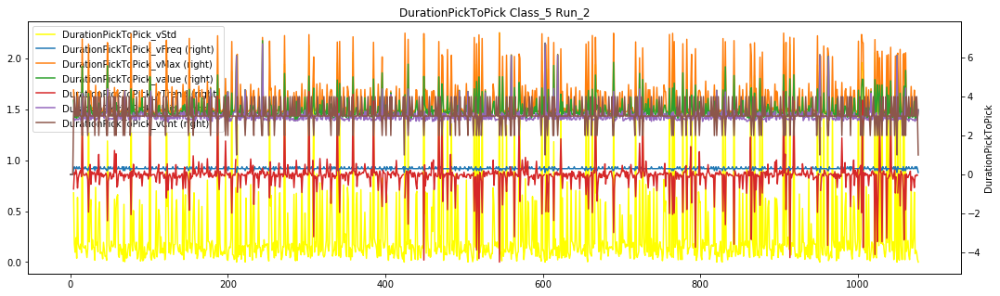

class_5_run_3
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      3
DurationPickToPick_value     3
DurationPickToPick_vTrend    6
DurationPickToPick_vStd      3
DurationPickToPick_vMin      3
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

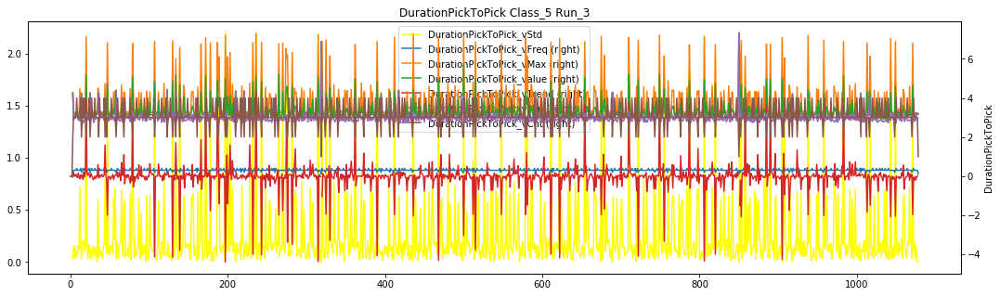

class_5_run_4
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      1
DurationPickToPick_value     1
DurationPickToPick_vTrend    4
DurationPickToPick_vStd      1
DurationPickToPick_vMin      1
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

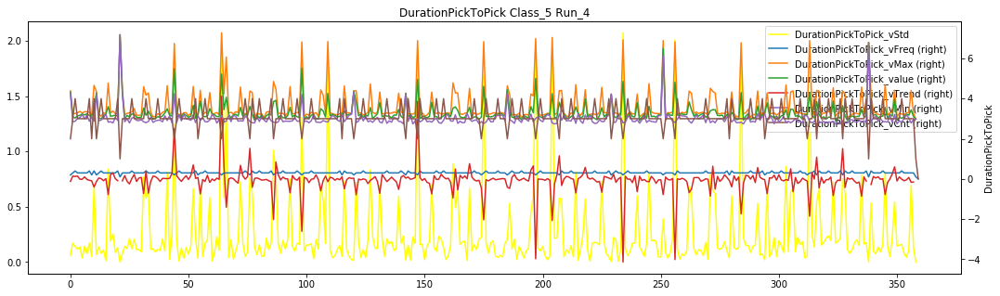

class_7_run_0
DurationPickToPick_vFreq      0
DurationPickToPick_vMax      11
DurationPickToPick_value     11
DurationPickToPick_vTrend    12
DurationPickToPick_vStd      11
DurationPickToPick_vMin      11
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

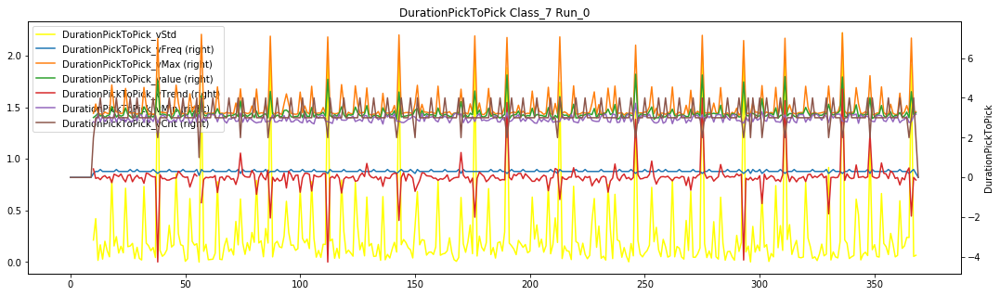

class_7_run_2
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      5
DurationPickToPick_value     5
DurationPickToPick_vTrend    9
DurationPickToPick_vStd      5
DurationPickToPick_vMin      5
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

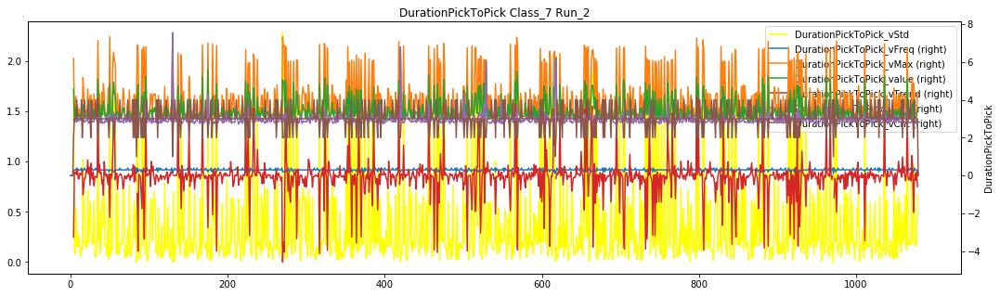

class_7_run_3
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      5
DurationPickToPick_value     5
DurationPickToPick_vTrend    8
DurationPickToPick_vStd      5
DurationPickToPick_vMin      5
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

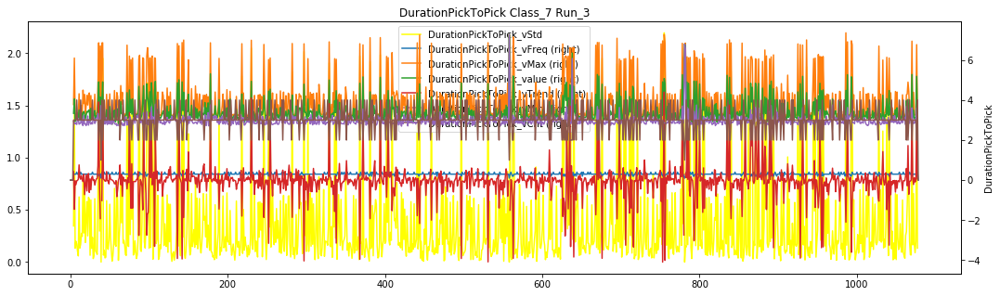

class_7_run_5
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      2
DurationPickToPick_value     2
DurationPickToPick_vTrend    6
DurationPickToPick_vStd      2
DurationPickToPick_vMin      2
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

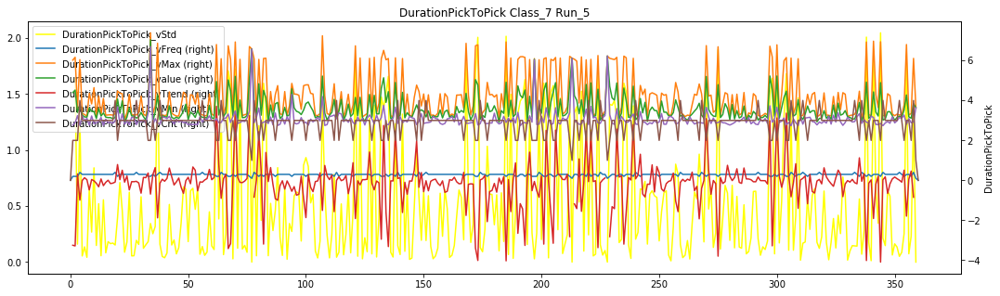

class_9_run_1
DurationPickToPick_vFreq      0
DurationPickToPick_vMax       9
DurationPickToPick_value      9
DurationPickToPick_vTrend    11
DurationPickToPick_vStd       9
DurationPickToPick_vMin       9
DurationPickToPick_vCnt       0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

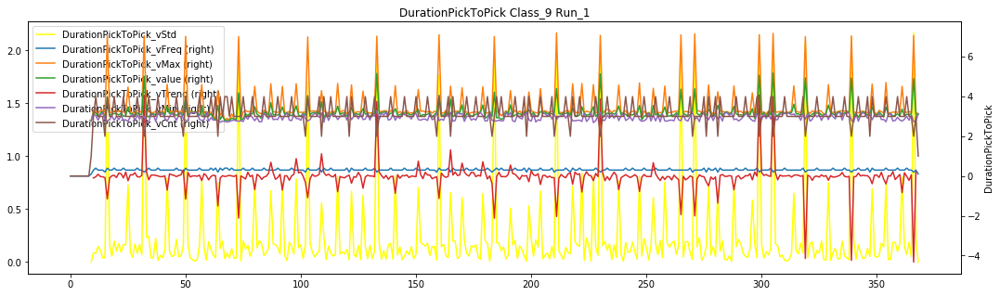

class_9_run_2
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      4
DurationPickToPick_value     4
DurationPickToPick_vTrend    6
DurationPickToPick_vStd      4
DurationPickToPick_vMin      4
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

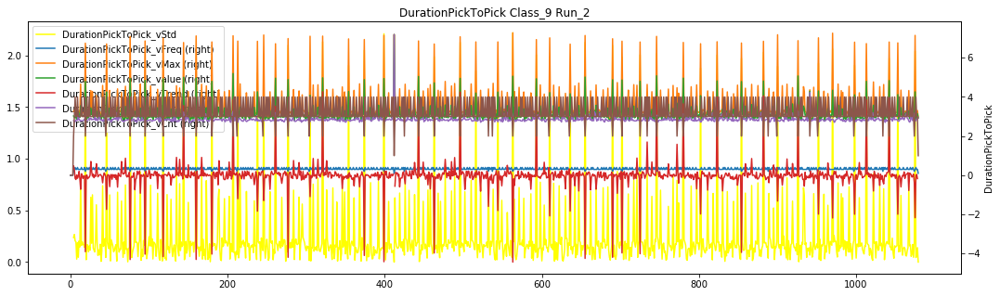

class_9_run_3
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      4
DurationPickToPick_value     4
DurationPickToPick_vTrend    7
DurationPickToPick_vStd      4
DurationPickToPick_vMin      4
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

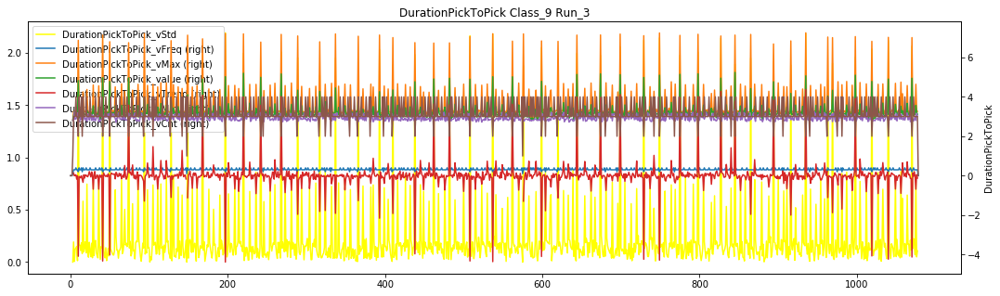

class_9_run_5
DurationPickToPick_vFreq     0
DurationPickToPick_vMax      3
DurationPickToPick_value     3
DurationPickToPick_vTrend    3
DurationPickToPick_vStd      3
DurationPickToPick_vMin      3
DurationPickToPick_vCnt      0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

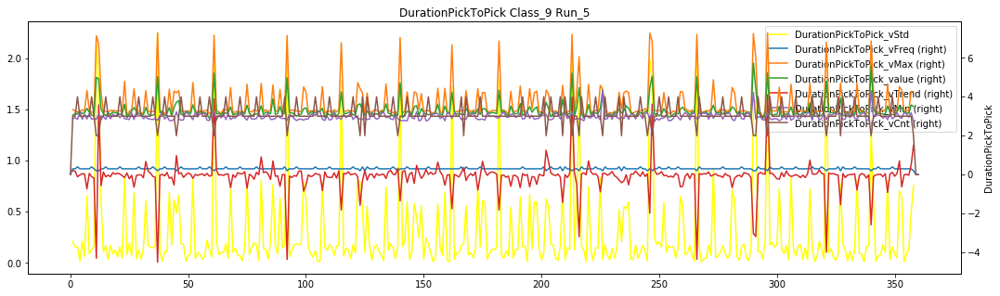

<Figure size 432x288 with 0 Axes>

In [35]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[9]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
DurationTestBenchClosed_vFreq     0
DurationTestBenchClosed_vMax      5
DurationTestBenchClosed_vMin      5
DurationTestBenchClosed_vCnt      0
DurationTestBenchClosed_value     5
DurationTestBenchClosed_vStd      5
DurationTestBenchClosed_vTrend    5
dtype: int64


<Figure size 1296x360 with 0 Axes>

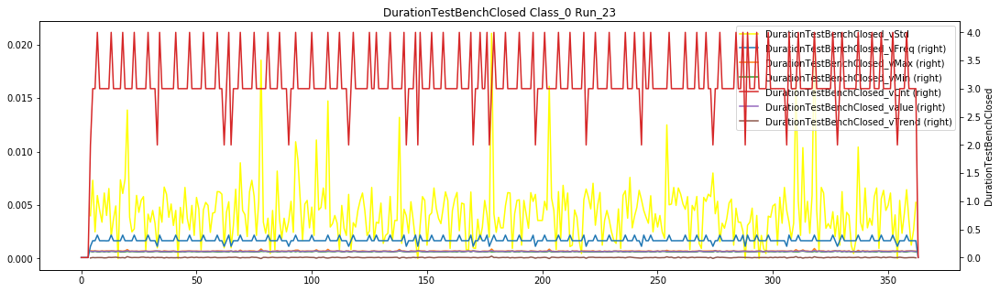

class_0_run_25
DurationTestBenchClosed_vFreq     0
DurationTestBenchClosed_vMax      2
DurationTestBenchClosed_vMin      2
DurationTestBenchClosed_vCnt      0
DurationTestBenchClosed_value     2
DurationTestBenchClosed_vStd      2
DurationTestBenchClosed_vTrend    2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

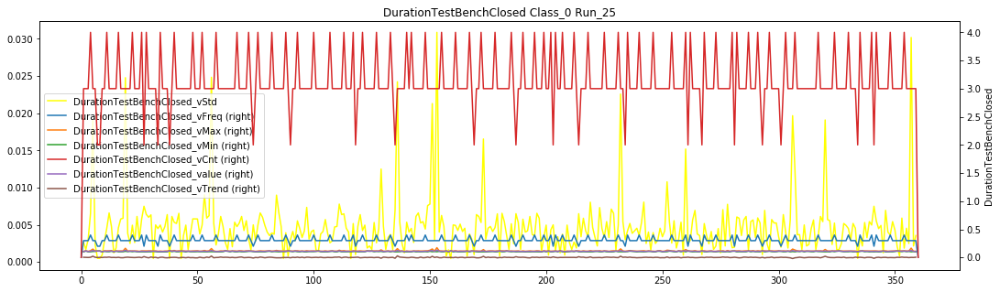

class_0_run_27
DurationTestBenchClosed_vFreq     0
DurationTestBenchClosed_vMax      2
DurationTestBenchClosed_vMin      2
DurationTestBenchClosed_vCnt      0
DurationTestBenchClosed_value     2
DurationTestBenchClosed_vStd      2
DurationTestBenchClosed_vTrend    2
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

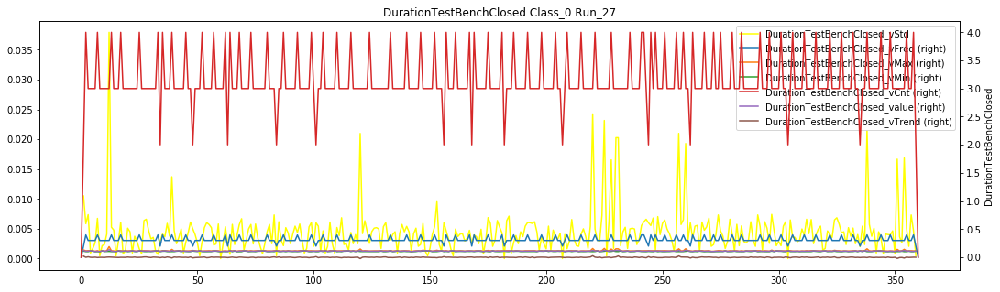

class_0_run_46
DurationTestBenchClosed_vFreq     0
DurationTestBenchClosed_vMax      3
DurationTestBenchClosed_vMin      3
DurationTestBenchClosed_vCnt      0
DurationTestBenchClosed_value     3
DurationTestBenchClosed_vStd      3
DurationTestBenchClosed_vTrend    7
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

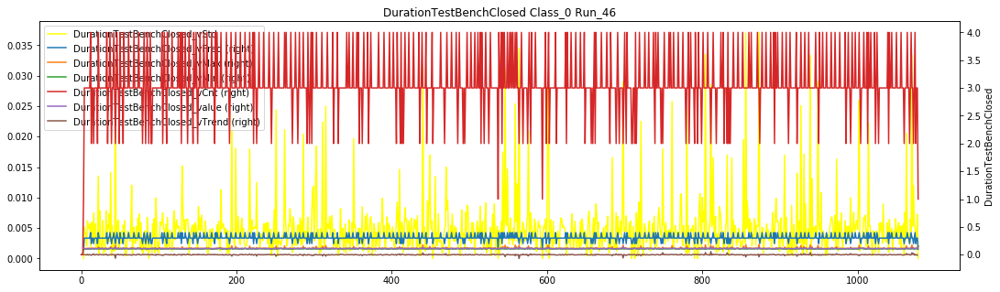

class_0_run_90
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       5
DurationTestBenchClosed_vMin       5
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      5
DurationTestBenchClosed_vStd       5
DurationTestBenchClosed_vTrend    18
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

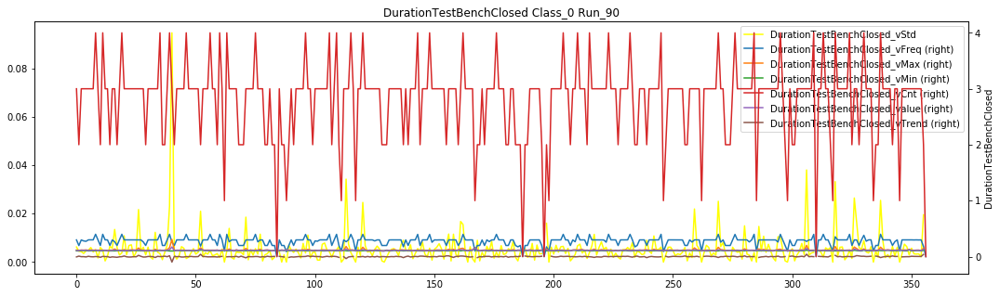

class_2_run_0
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      13
DurationTestBenchClosed_vMin      13
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     13
DurationTestBenchClosed_vStd      13
DurationTestBenchClosed_vTrend    59
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

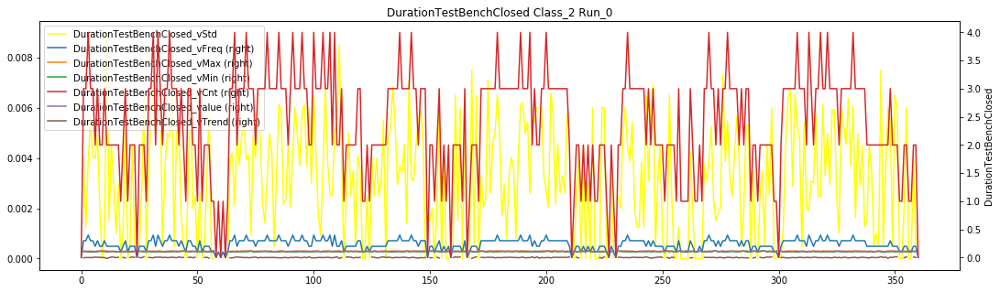

class_2_run_2
DurationTestBenchClosed_vFreq       0
DurationTestBenchClosed_vMax       40
DurationTestBenchClosed_vMin       40
DurationTestBenchClosed_vCnt        0
DurationTestBenchClosed_value      40
DurationTestBenchClosed_vStd       40
DurationTestBenchClosed_vTrend    201
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

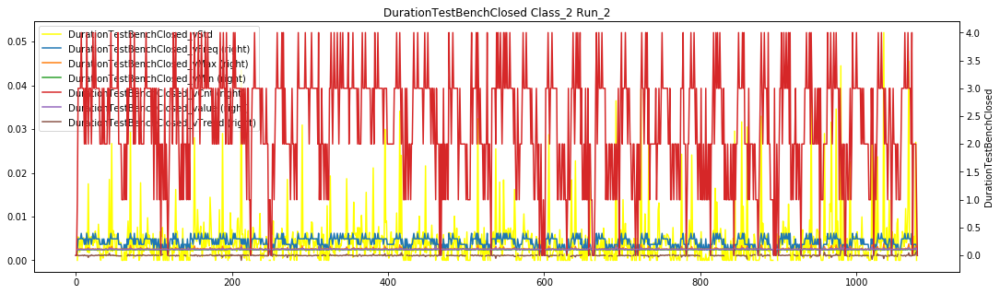

class_2_run_3
DurationTestBenchClosed_vFreq       0
DurationTestBenchClosed_vMax      144
DurationTestBenchClosed_vMin      144
DurationTestBenchClosed_vCnt        0
DurationTestBenchClosed_value     144
DurationTestBenchClosed_vStd      144
DurationTestBenchClosed_vTrend    336
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

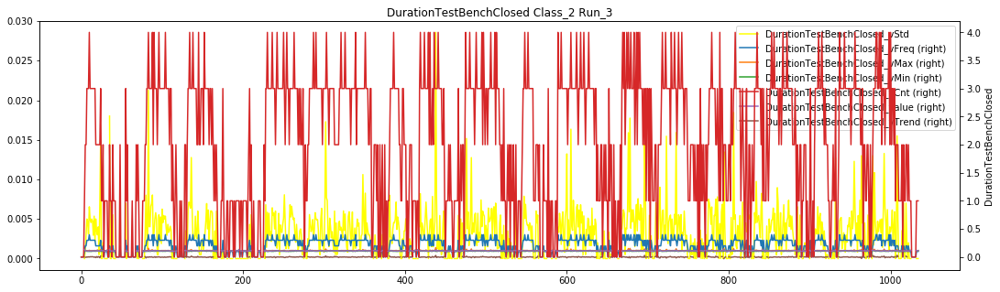

class_2_run_4
DurationTestBenchClosed_vFreq       0
DurationTestBenchClosed_vMax       33
DurationTestBenchClosed_vMin       33
DurationTestBenchClosed_vCnt        0
DurationTestBenchClosed_value      33
DurationTestBenchClosed_vStd       33
DurationTestBenchClosed_vTrend    110
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

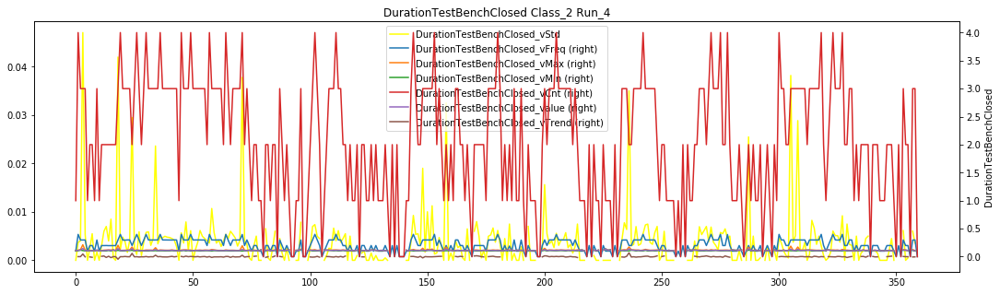

class_3_run_0
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       4
DurationTestBenchClosed_vMin       4
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      4
DurationTestBenchClosed_vStd       4
DurationTestBenchClosed_vTrend    10
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

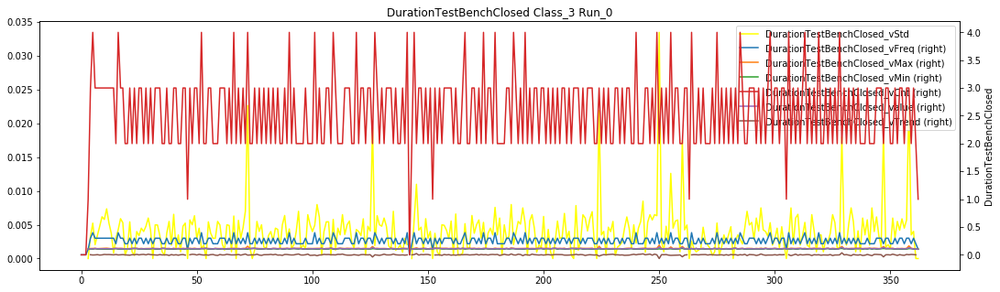

class_3_run_2
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      14
DurationTestBenchClosed_vMin      14
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     14
DurationTestBenchClosed_vStd      14
DurationTestBenchClosed_vTrend    51
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

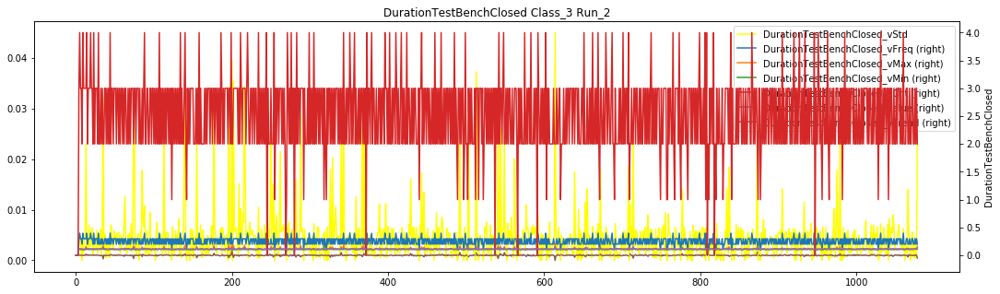

class_3_run_3
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       9
DurationTestBenchClosed_vMin       9
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      9
DurationTestBenchClosed_vStd       9
DurationTestBenchClosed_vTrend    47
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

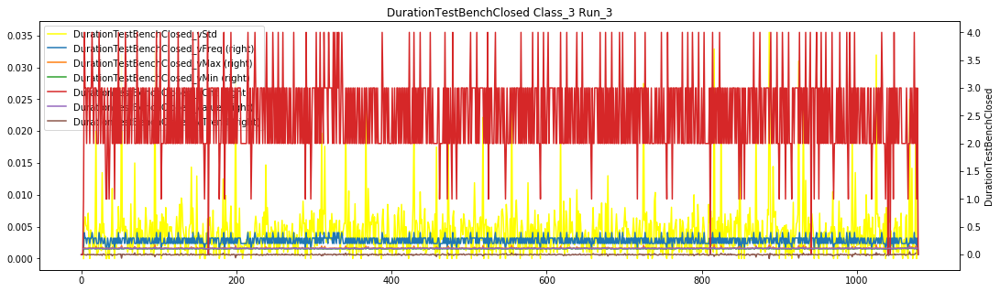

class_3_run_4
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       3
DurationTestBenchClosed_vMin       3
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      3
DurationTestBenchClosed_vStd       3
DurationTestBenchClosed_vTrend    15
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

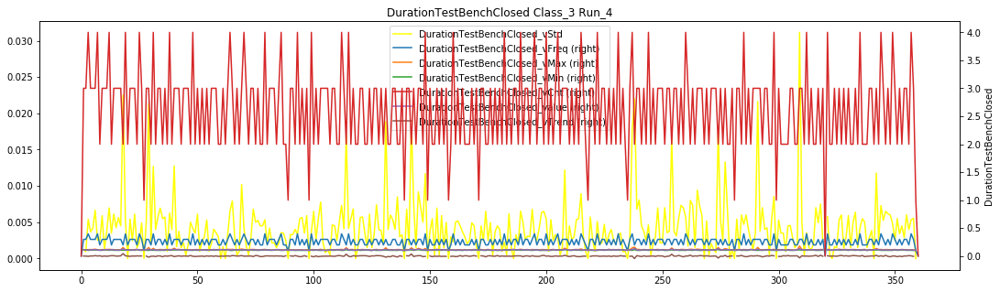

class_5_run_0
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      10
DurationTestBenchClosed_vMin      10
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     10
DurationTestBenchClosed_vStd      10
DurationTestBenchClosed_vTrend    30
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

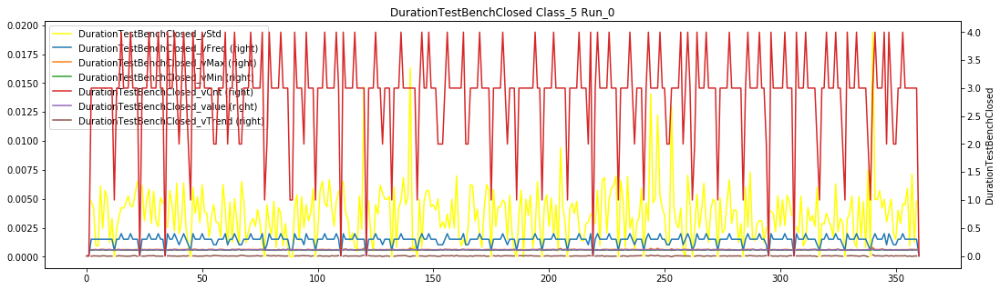

class_5_run_2
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      29
DurationTestBenchClosed_vMin      29
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     29
DurationTestBenchClosed_vStd      29
DurationTestBenchClosed_vTrend    98
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

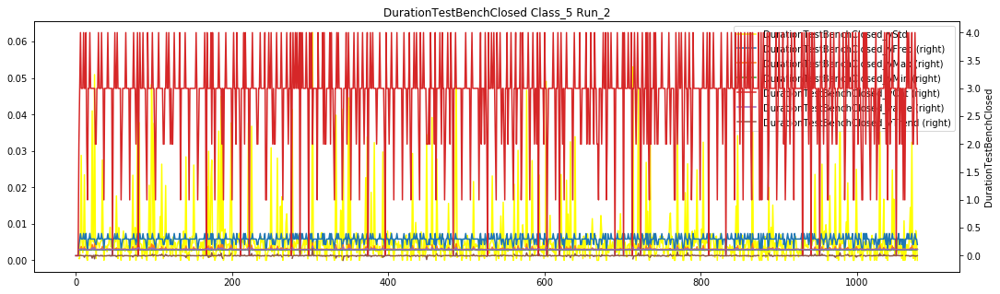

class_5_run_3
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      23
DurationTestBenchClosed_vMin      23
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     23
DurationTestBenchClosed_vStd      23
DurationTestBenchClosed_vTrend    92
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

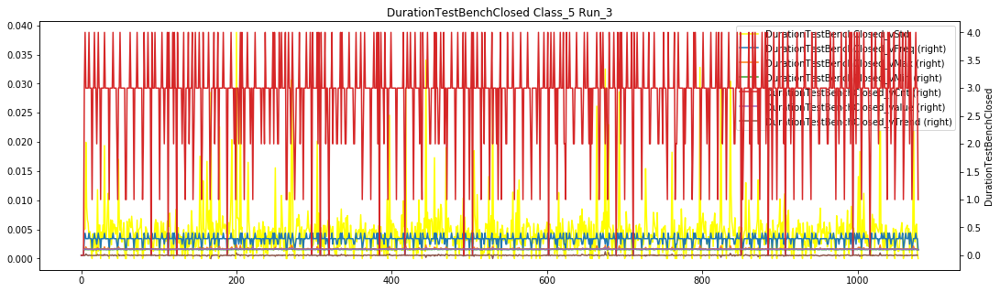

class_5_run_4
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      10
DurationTestBenchClosed_vMin      10
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     10
DurationTestBenchClosed_vStd      10
DurationTestBenchClosed_vTrend    30
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

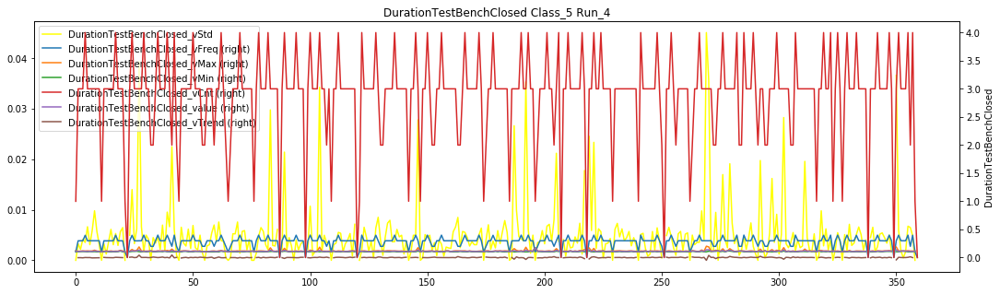

class_7_run_0
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      11
DurationTestBenchClosed_vMin      11
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     11
DurationTestBenchClosed_vStd      11
DurationTestBenchClosed_vTrend    11
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

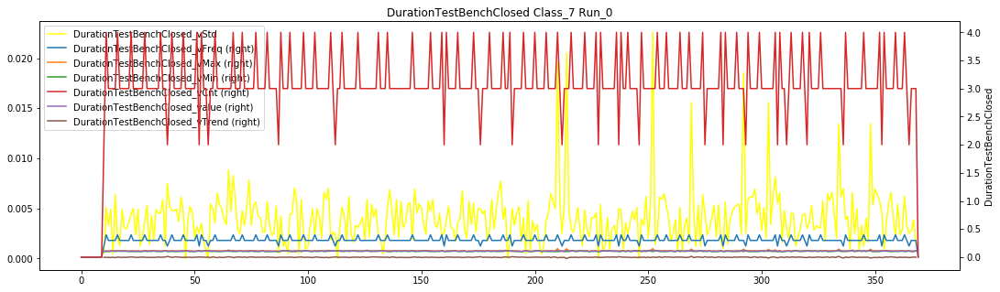

class_7_run_2
DurationTestBenchClosed_vFreq       0
DurationTestBenchClosed_vMax       12
DurationTestBenchClosed_vMin       12
DurationTestBenchClosed_vCnt        0
DurationTestBenchClosed_value      12
DurationTestBenchClosed_vStd       12
DurationTestBenchClosed_vTrend    108
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

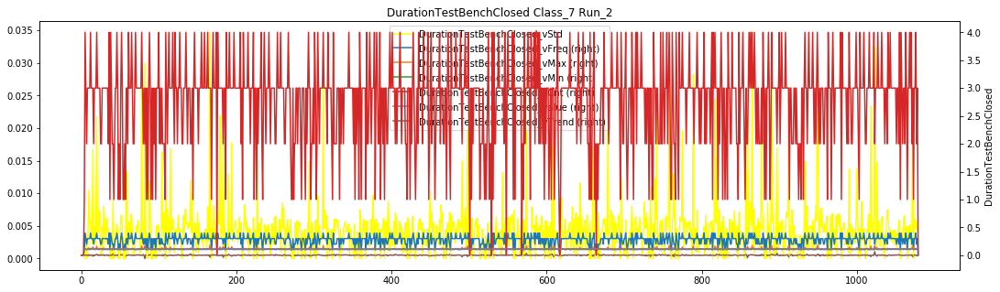

class_7_run_3
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       8
DurationTestBenchClosed_vMin       8
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      8
DurationTestBenchClosed_vStd       8
DurationTestBenchClosed_vTrend    97
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

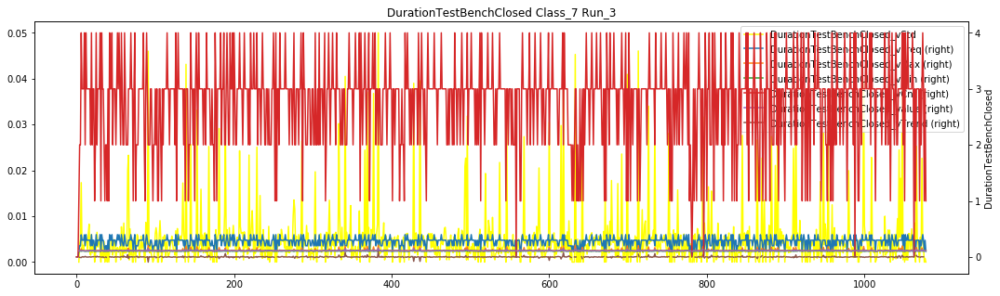

class_7_run_5
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax      13
DurationTestBenchClosed_vMin      13
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value     13
DurationTestBenchClosed_vStd      13
DurationTestBenchClosed_vTrend    72
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

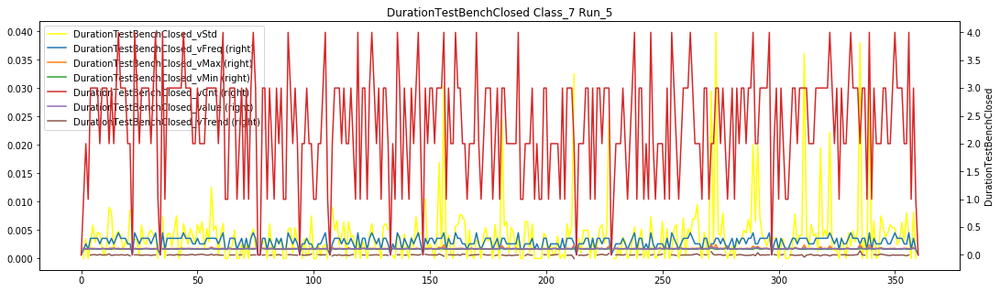

class_9_run_1
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       9
DurationTestBenchClosed_vMin       9
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      9
DurationTestBenchClosed_vStd       9
DurationTestBenchClosed_vTrend    10
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

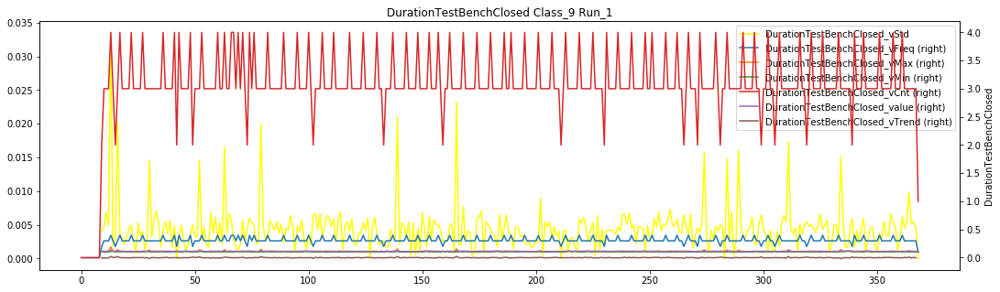

class_9_run_2
DurationTestBenchClosed_vFreq     0
DurationTestBenchClosed_vMax      4
DurationTestBenchClosed_vMin      4
DurationTestBenchClosed_vCnt      0
DurationTestBenchClosed_value     4
DurationTestBenchClosed_vStd      4
DurationTestBenchClosed_vTrend    6
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

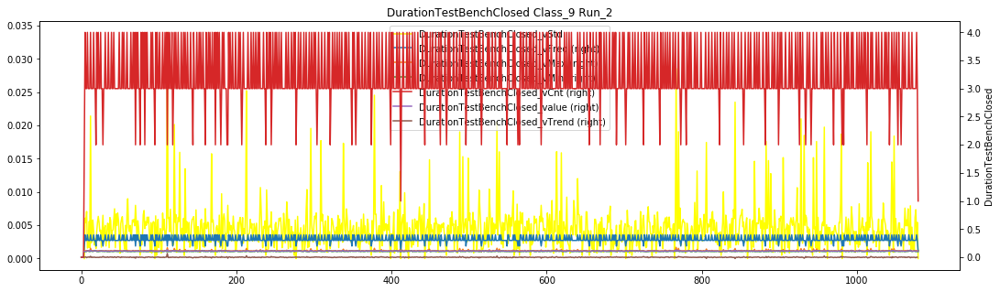

class_9_run_3
DurationTestBenchClosed_vFreq     0
DurationTestBenchClosed_vMax      4
DurationTestBenchClosed_vMin      4
DurationTestBenchClosed_vCnt      0
DurationTestBenchClosed_value     4
DurationTestBenchClosed_vStd      4
DurationTestBenchClosed_vTrend    6
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

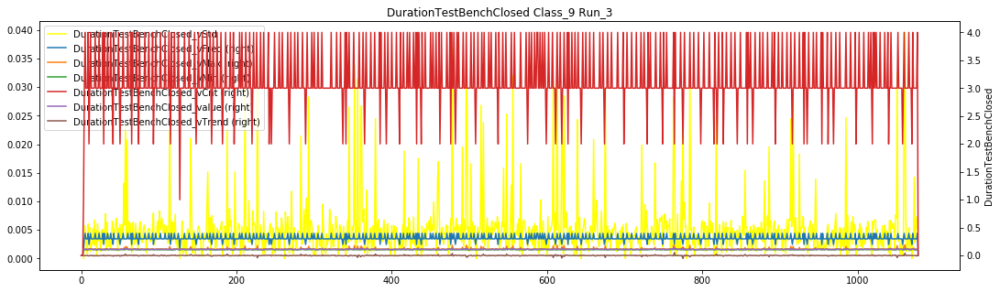

class_9_run_5
DurationTestBenchClosed_vFreq      0
DurationTestBenchClosed_vMax       4
DurationTestBenchClosed_vMin       4
DurationTestBenchClosed_vCnt       0
DurationTestBenchClosed_value      4
DurationTestBenchClosed_vStd       4
DurationTestBenchClosed_vTrend    12
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

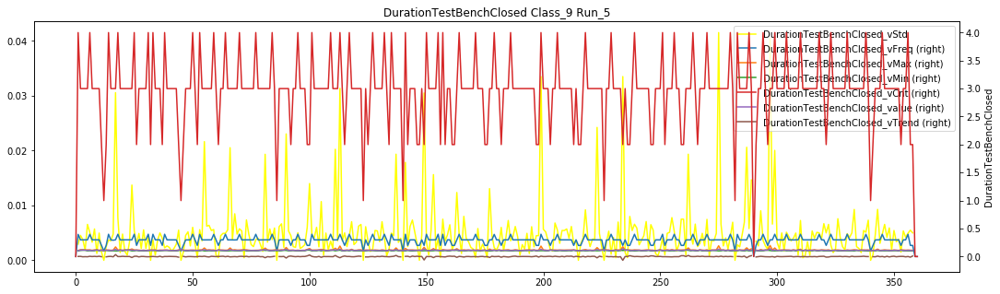

<Figure size 432x288 with 0 Axes>

In [36]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[10]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_18
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 1296x360 with 0 Axes>

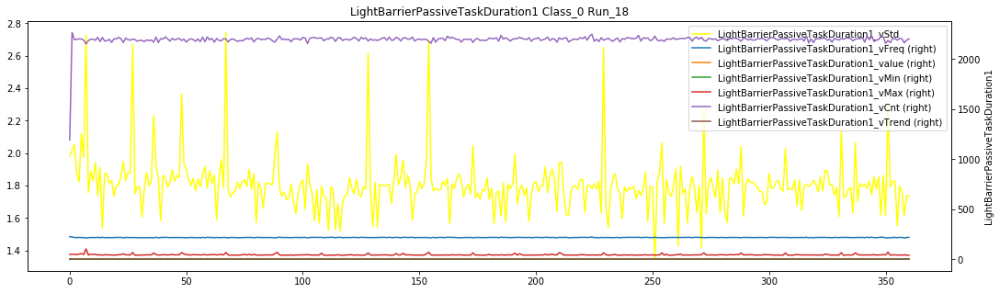

class_0_run_29
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

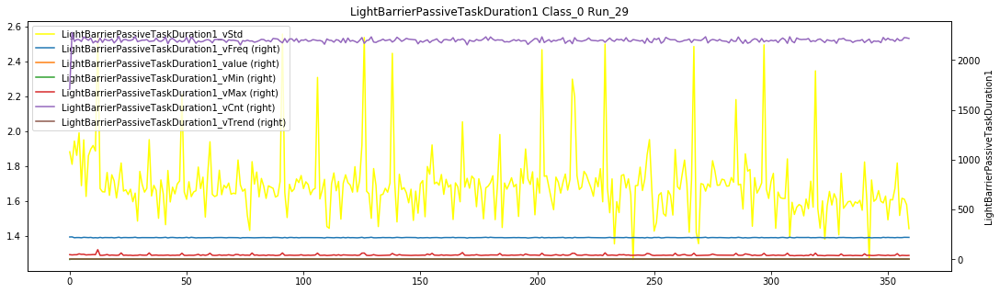

class_0_run_32
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

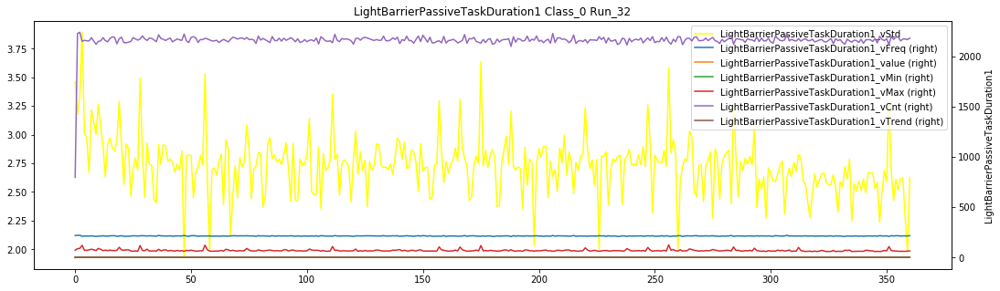

class_0_run_36
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

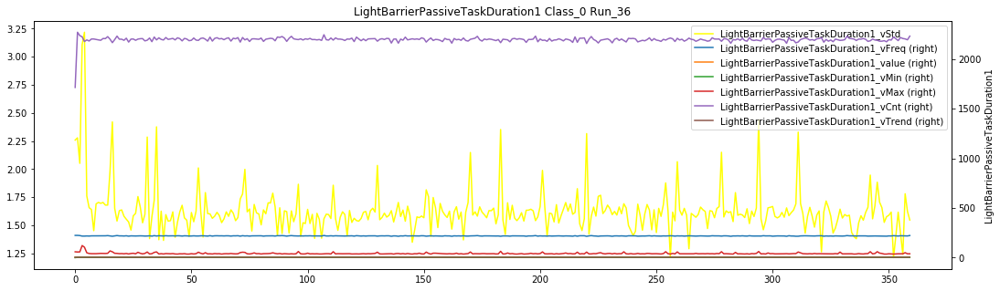

class_0_run_96
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

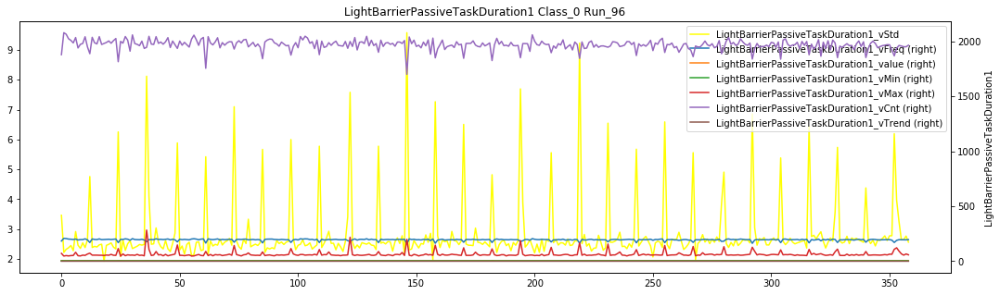

class_2_run_0
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

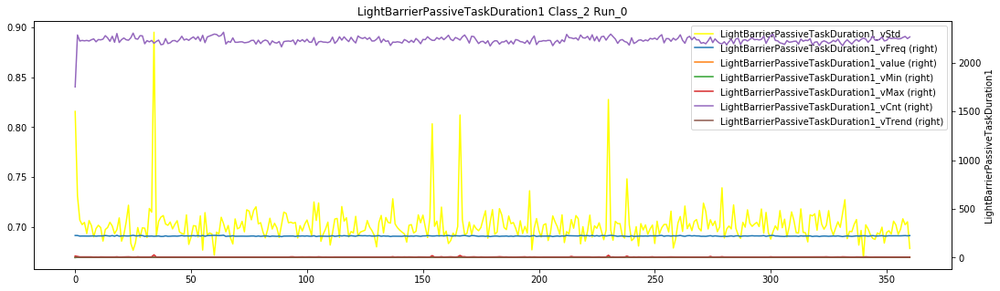

class_2_run_2
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     1
LightBarrierPassiveTaskDuration1_vMin      1
LightBarrierPassiveTaskDuration1_vMax      1
LightBarrierPassiveTaskDuration1_vStd      1
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

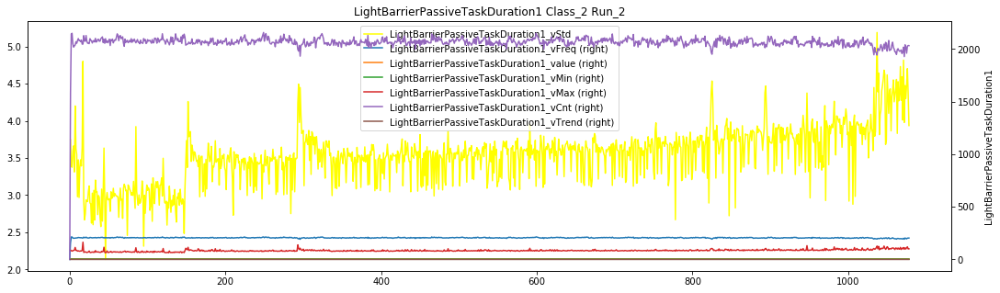

class_2_run_3
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

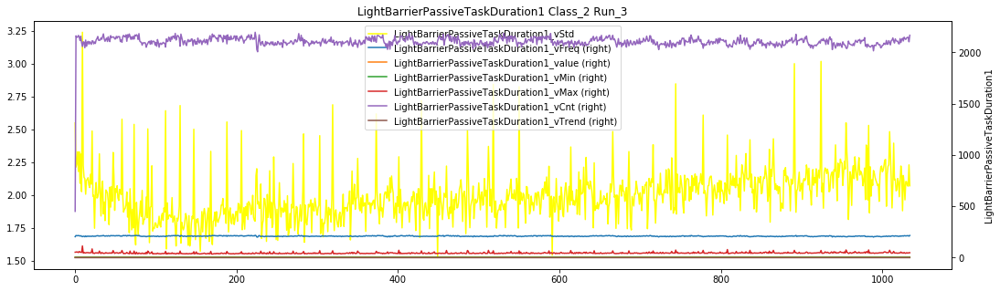

class_2_run_4
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

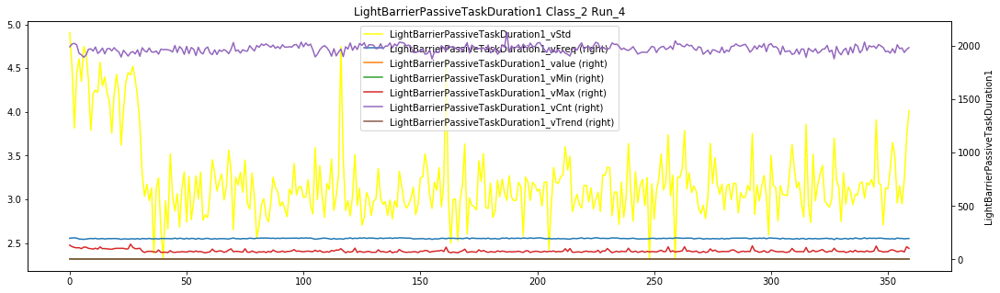

class_3_run_0
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

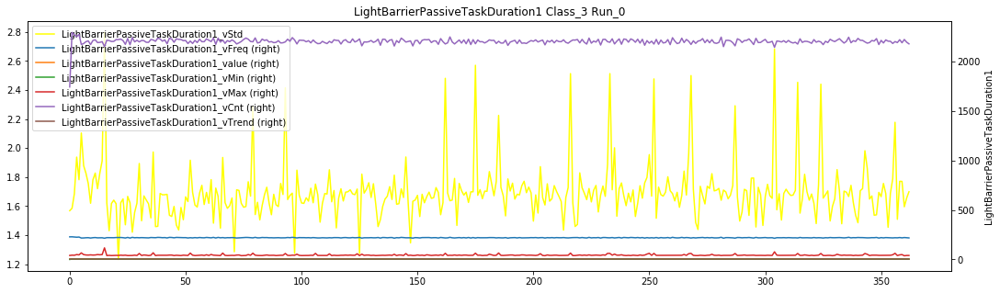

class_3_run_2
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

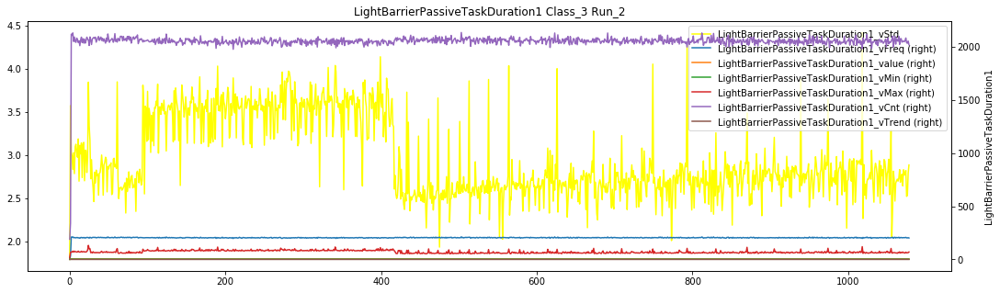

class_3_run_3
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

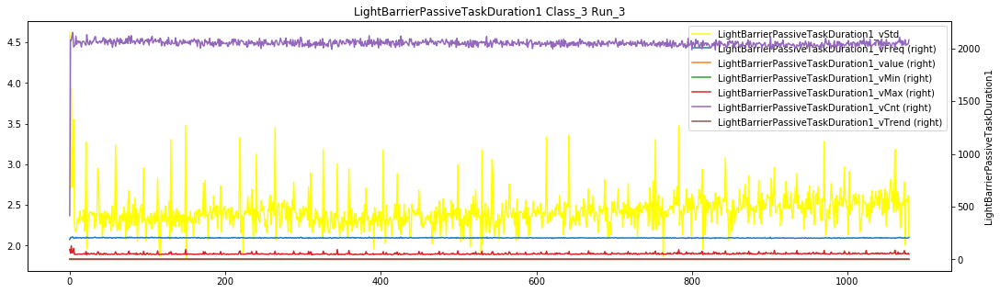

class_3_run_4
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

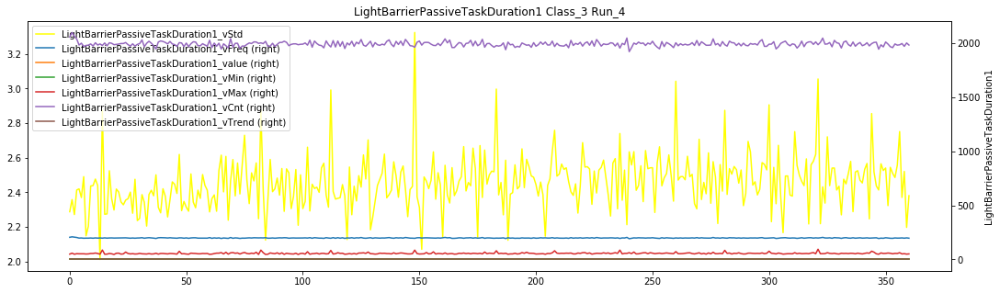

class_5_run_0
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

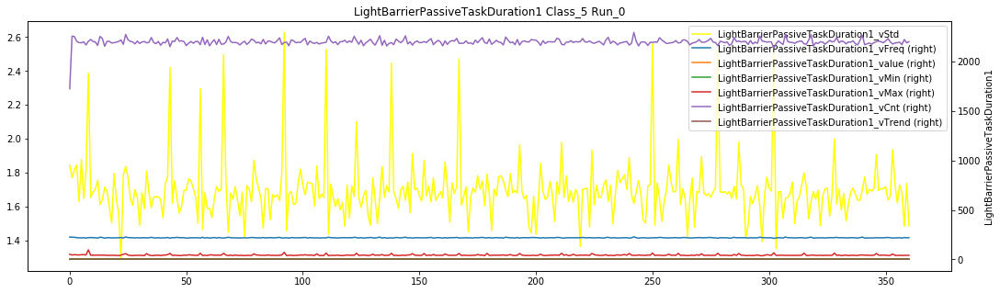

class_5_run_2
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

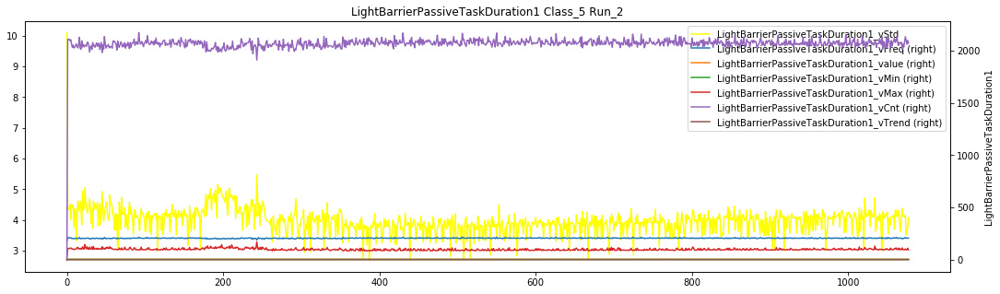

class_5_run_3
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

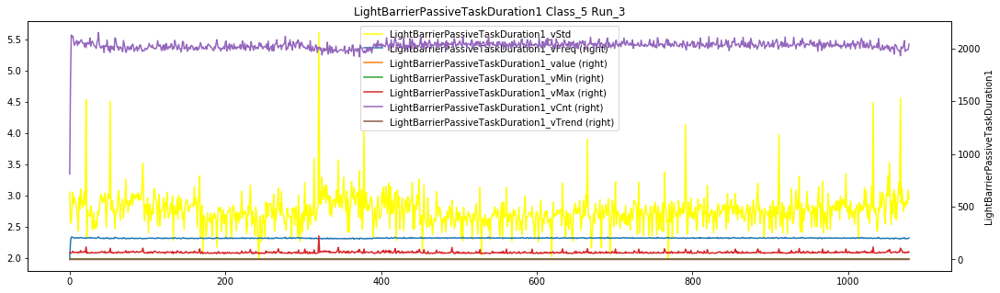

class_5_run_4
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

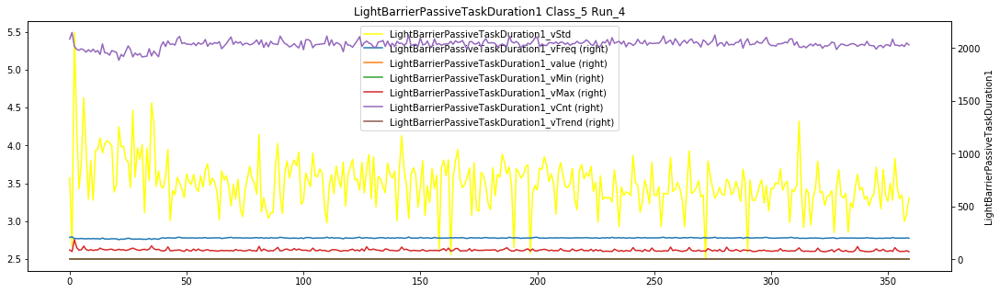

class_7_run_0
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

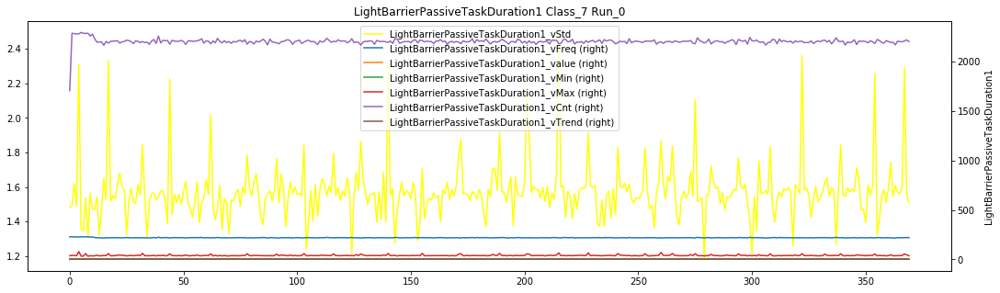

class_7_run_2
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     1
LightBarrierPassiveTaskDuration1_vMin      1
LightBarrierPassiveTaskDuration1_vMax      1
LightBarrierPassiveTaskDuration1_vStd      1
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

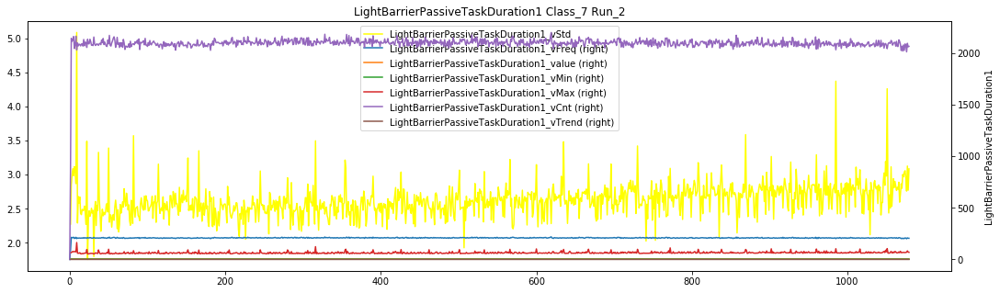

class_7_run_3
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     1
LightBarrierPassiveTaskDuration1_vMin      1
LightBarrierPassiveTaskDuration1_vMax      1
LightBarrierPassiveTaskDuration1_vStd      1
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

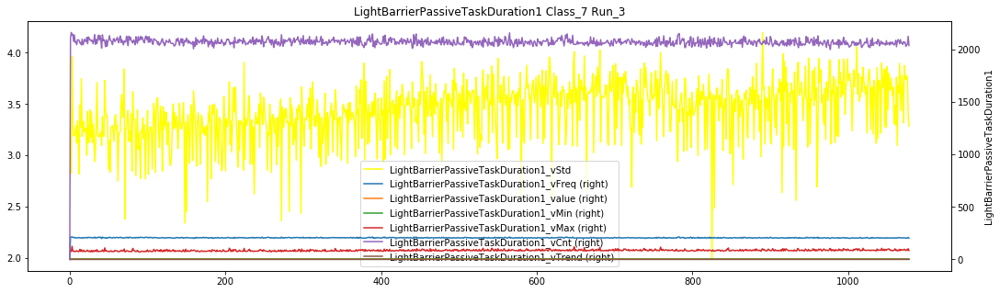

class_7_run_5
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

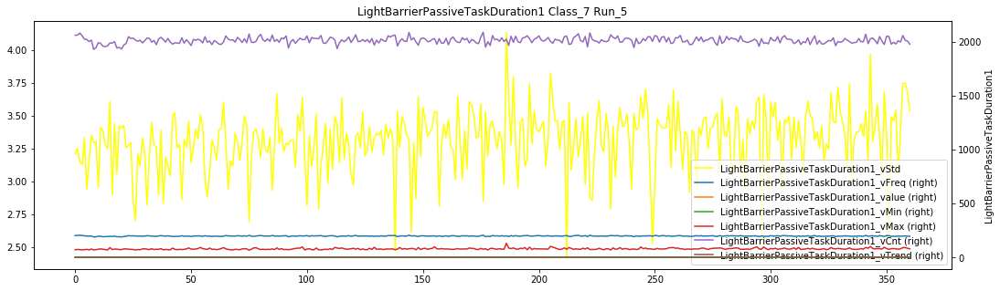

class_9_run_1
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

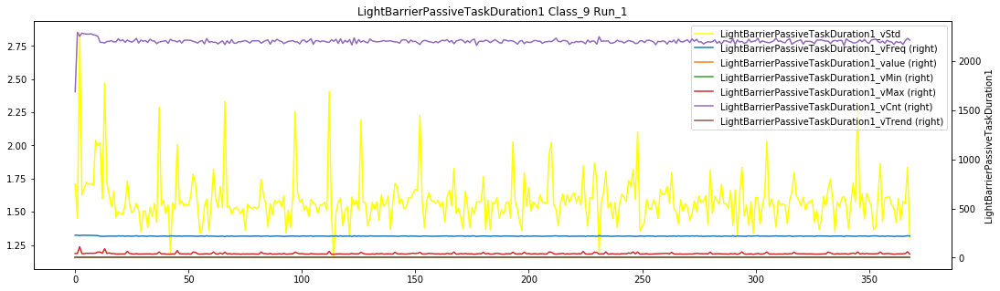

class_9_run_2
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

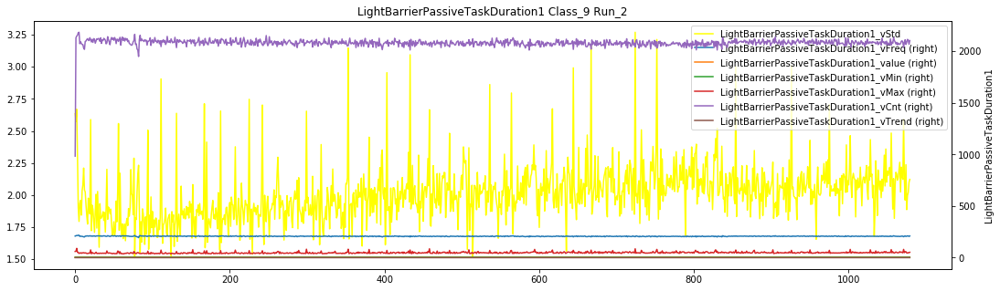

class_9_run_3
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     1
LightBarrierPassiveTaskDuration1_vMin      1
LightBarrierPassiveTaskDuration1_vMax      1
LightBarrierPassiveTaskDuration1_vStd      1
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    1
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

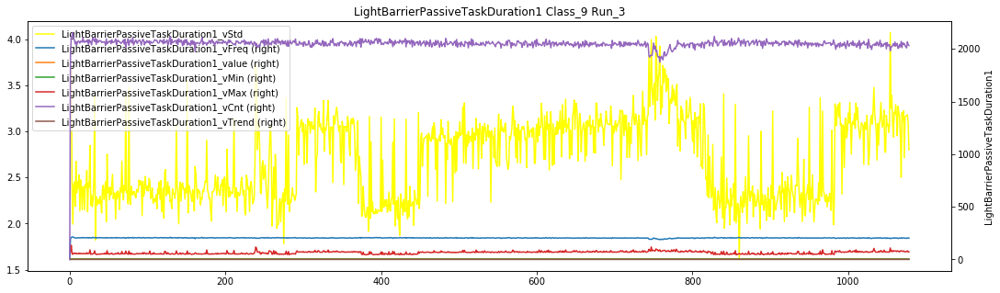

class_9_run_5
LightBarrierPassiveTaskDuration1_vFreq     0
LightBarrierPassiveTaskDuration1_value     0
LightBarrierPassiveTaskDuration1_vMin      0
LightBarrierPassiveTaskDuration1_vMax      0
LightBarrierPassiveTaskDuration1_vStd      0
LightBarrierPassiveTaskDuration1_vCnt      0
LightBarrierPassiveTaskDuration1_vTrend    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

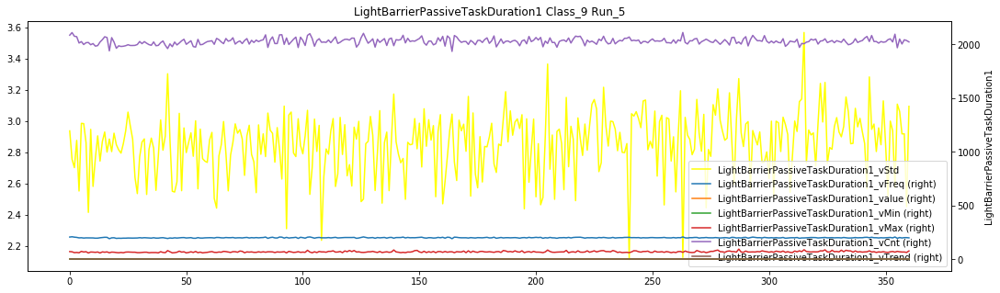

<Figure size 432x288 with 0 Axes>

In [36]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[11]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

class_0_run_23
FeederAction4_vCnt    0
dtype: int64


<Figure size 1296x360 with 0 Axes>

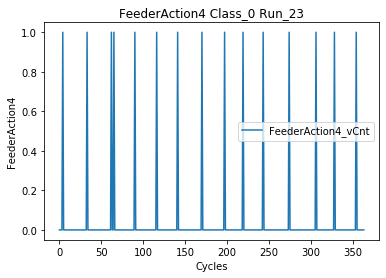

class_0_run_25
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

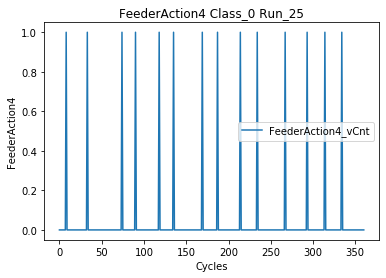

class_0_run_27
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

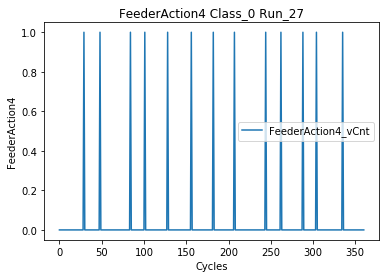

class_0_run_46
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

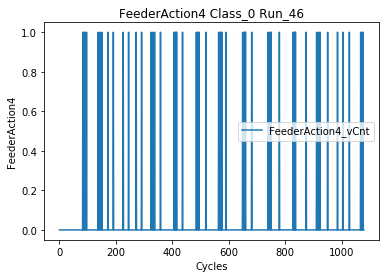

class_0_run_90
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

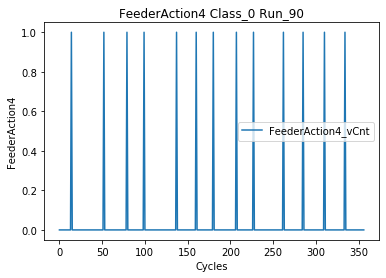

class_2_run_0
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

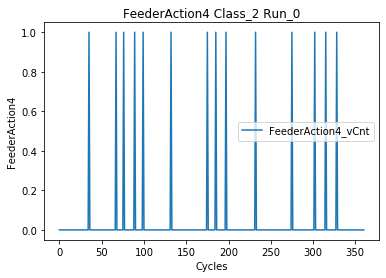

class_2_run_2
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

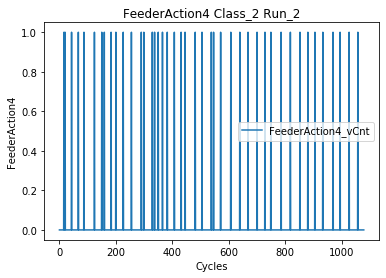

class_2_run_3
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

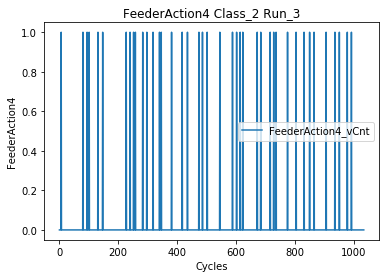

class_2_run_4
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

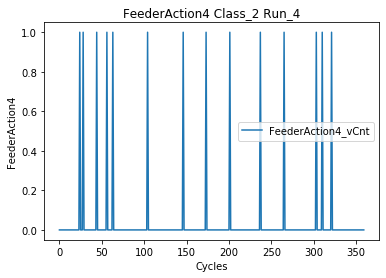

class_3_run_0
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

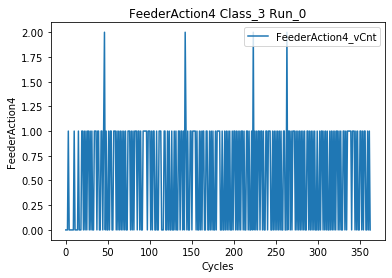

class_3_run_2
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

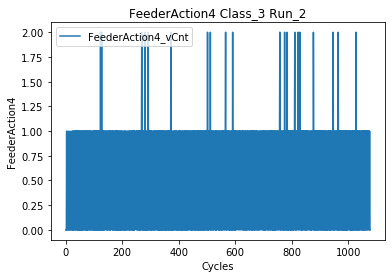

class_3_run_3
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

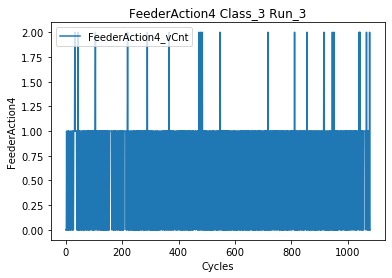

class_3_run_4
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

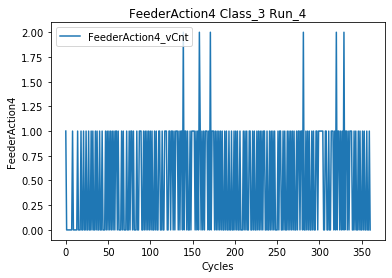

class_5_run_0
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

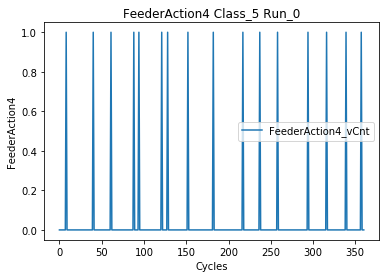

class_5_run_2
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

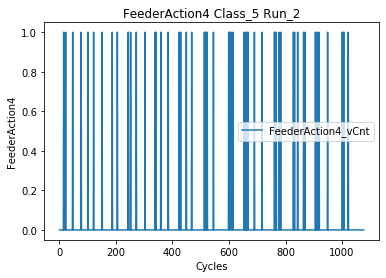

class_5_run_3
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

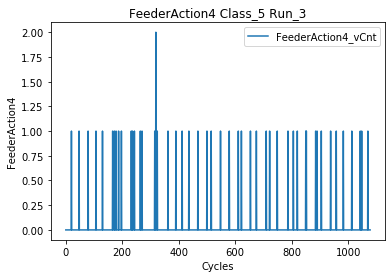

class_5_run_4
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

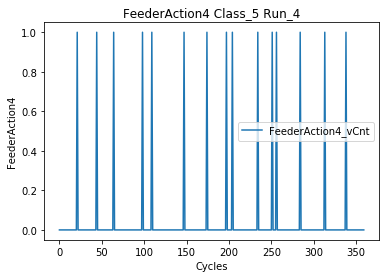

class_7_run_0
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

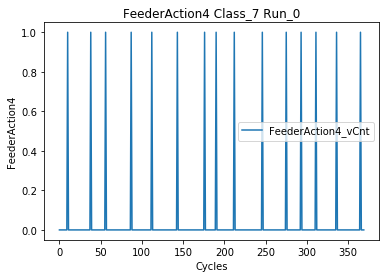

class_7_run_2
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

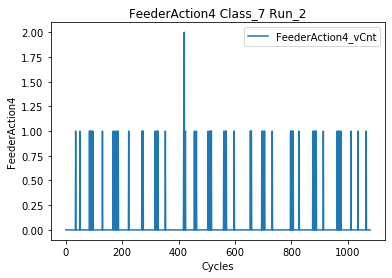

class_7_run_3
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

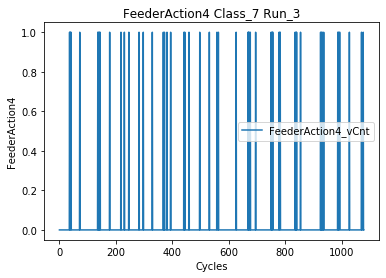

class_7_run_5
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

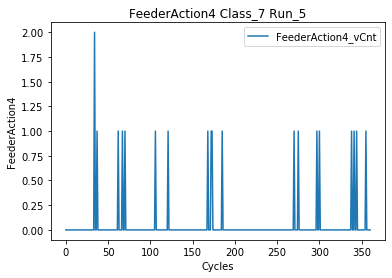

class_9_run_1
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

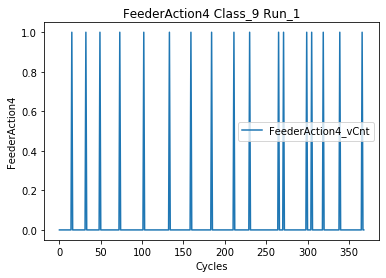

class_9_run_2
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

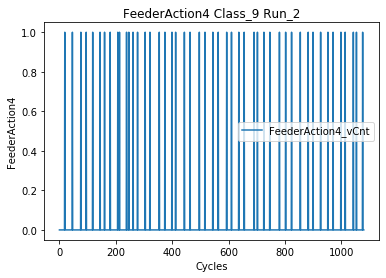

class_9_run_3
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

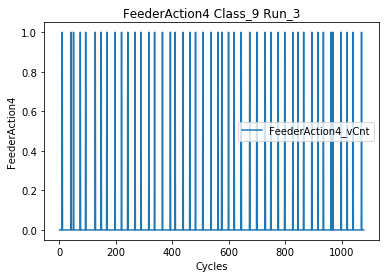

class_9_run_5
FeederAction4_vCnt    0
dtype: int64


<Figure size 432x288 with 0 Axes>

<Figure size 1296x360 with 0 Axes>

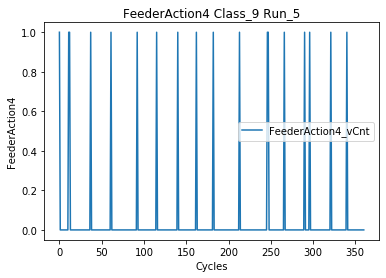

<Figure size 432x288 with 0 Axes>

In [37]:
for f in fields_dict:
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1[12]:
        continue
    
    fields = list(set(fields).intersection(set(remain_features_set1)))
    df.groupby(["class", "run"]).apply(data_visualization, name, fields)

In [39]:
def fill_nan_values(data, name, fields):

    field_df = data[fields]

    if field_df.isnull().values.any():
        data[fields] = field_df.interpolate(method='linear', limit_direction='both')

    return data[fields]

In [40]:
for f in fields_dict:
    
    name = fields_dict[f]['name']
    fields = fields_dict[f]['fields']
    
    if name not in remain_base_features_set1:
        continue
        
    fields = list(set(fields).intersection(set(remain_features_set1)))        
    print("\nname:", name, "fields:", fields)
    df_ = df.groupby(["class", "run"]).apply(fill_nan_values, name, fields)
    df_.reset_index(drop=True, inplace=True)
    df[fields] = df_[fields]


name: CpuTemperature fields: ['CpuTemperature_vStd', 'CpuTemperature_vMin', 'CpuTemperature_value', 'CpuTemperature_vMax']

name: DurationPickToPick fields: ['DurationPickToPick_vFreq', 'DurationPickToPick_vMax', 'DurationPickToPick_value', 'DurationPickToPick_vTrend', 'DurationPickToPick_vStd', 'DurationPickToPick_vMin', 'DurationPickToPick_vCnt']

name: DurationRobotFromFeederToTestBench fields: ['DurationRobotFromFeederToTestBench_vFreq', 'DurationRobotFromFeederToTestBench_vStd', 'DurationRobotFromFeederToTestBench_vTrend', 'DurationRobotFromFeederToTestBench_vMax', 'DurationRobotFromFeederToTestBench_vCnt', 'DurationRobotFromFeederToTestBench_vMin', 'DurationRobotFromFeederToTestBench_value']

name: DurationRobotFromTestBenchToFeeder fields: ['DurationRobotFromTestBenchToFeeder_vMax', 'DurationRobotFromTestBenchToFeeder_value', 'DurationRobotFromTestBenchToFeeder_vTrend', 'DurationRobotFromTestBenchToFeeder_vStd', 'DurationRobotFromTestBenchToFeeder_vFreq', 'DurationRobotFromTest

In [41]:
df.isnull().sum().any()

False

In [42]:
df

,class,run,CpuTemperature_vMax,CpuTemperature_vMin,CpuTemperature_vStd,CpuTemperature_value,DurationPickToPick_vCnt,DurationPickToPick_vFreq,DurationPickToPick_vMax,DurationPickToPick_vMin,...,EPOSVelocity_vMin,EPOSVelocity_vStd,EPOSVelocity_vTrend,EPOSVelocity_value,ErrorFrame_vCnt,ErrorFrame_vFreq,FeederAction1_vCnt,FeederAction2_vCnt,FeederAction3_vCnt,FeederAction4_vCnt
0,0,0,56.75,44.75,3.523729,47.833333,0,0.000000,3.192,2.807,...,-1193.0,249.585923,1.578674,24.157895,0.0,0.0,0,0,0,0
1,0,0,63.25,54.25,2.895686,59.050000,1,0.099719,3.215,3.215,...,0.0,0.000000,0.000000,0.000000,0.0,0.0,0,0,1,0
2,0,0,48.75,42.25,2.395308,45.000000,2,0.198207,3.192,2.807,...,-1193.0,249.585923,1.578674,24.157895,0.0,0.0,0,1,0,0
3,0,0,63.75,54.50,3.155254,58.775000,3,0.298631,3.250,3.110,...,-1101.0,351.940498,-1.264484,-3.934211,0.0,0.0,0,0,0,0
4,0,0,47.50,42.00,2.085815,43.825000,3,0.296778,3.230,3.106,...,-1185.0,391.256574,2.089132,-15.368421,0.0,0.0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17971,9,5,62.75,54.25,2.447065,56.825000,2,0.199220,3.122,3.089,...,-1572.0,347.023168,-0.587465,1.545455,0.0,0.0,0,0,0,1
17972,9,5,54.75,49.00,1.977372,51.950000,2,0.199214,4.696,2.722,...,-1147.0,318.269569,-0.680246,19.184211,0.0,0.0,0,0,1,0
17973,9,5,62.25,55.00,2.173850,57.675000,4,0.398242,6.854,2.816,...,-829.0,199.005814,-0.165887,5.896104,0.0,0.0,0,0,0,0
17974,9,5,58.25,50.00,2.260531,51.800000,4,0.397878,3.283,2.805,...,-1029.0,319.659994,-1.022269,12.460526,0.0,0.0,0,0,0,0


In [43]:
for column in df.columns:
    if column not in ["class", "run"]:
        if (len(df[column].unique()) == 1) or (df[column].isnull().all()):
            df.drop(column, inplace=True, axis=1)
            print(column, "droped-unique")

        else:
            zero_rows = df.loc[df[column] == float(0)]
            if zero_rows.shape[0] >= df.shape[0] * 50:
                df.drop(column, inplace=True, axis=1)
                print(column, "droped-zero")

ErrorFrame_vCnt droped-unique
ErrorFrame_vFreq droped-unique


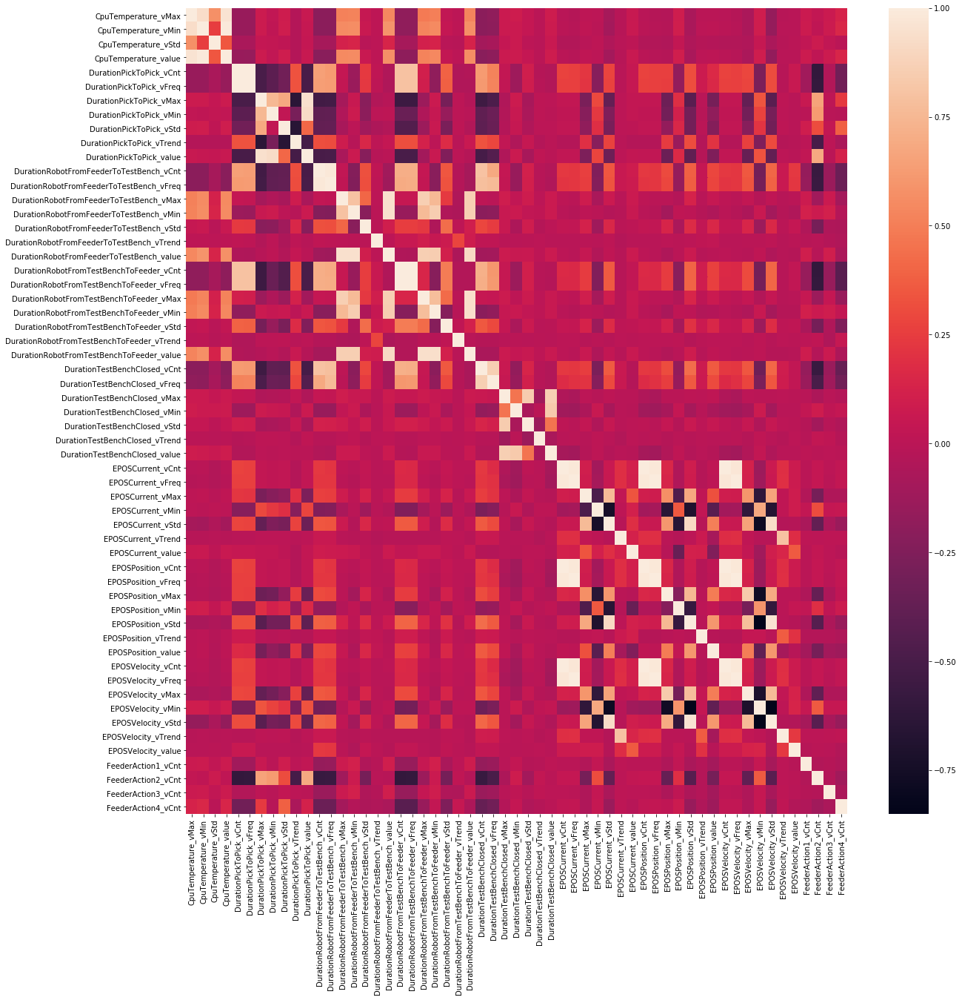

In [44]:
corr = df.drop(["class", "run"], axis=1).corr()
plt.figure (figsize=(20, 20))
sns.heatmap(corr, annot=False)

In [45]:
corr.style.background_gradient(cmap='Blues')

,CpuTemperature_vMax,CpuTemperature_vMin,CpuTemperature_vStd,CpuTemperature_value,DurationPickToPick_vCnt,DurationPickToPick_vFreq,DurationPickToPick_vMax,DurationPickToPick_vMin,DurationPickToPick_vStd,DurationPickToPick_vTrend,DurationPickToPick_value,DurationRobotFromFeederToTestBench_vCnt,DurationRobotFromFeederToTestBench_vFreq,DurationRobotFromFeederToTestBench_vMax,DurationRobotFromFeederToTestBench_vMin,DurationRobotFromFeederToTestBench_vStd,DurationRobotFromFeederToTestBench_vTrend,DurationRobotFromFeederToTestBench_value,DurationRobotFromTestBenchToFeeder_vCnt,DurationRobotFromTestBenchToFeeder_vFreq,DurationRobotFromTestBenchToFeeder_vMax,DurationRobotFromTestBenchToFeeder_vMin,DurationRobotFromTestBenchToFeeder_vStd,DurationRobotFromTestBenchToFeeder_vTrend,DurationRobotFromTestBenchToFeeder_value,DurationTestBenchClosed_vCnt,DurationTestBenchClosed_vFreq,DurationTestBenchClosed_vMax,DurationTestBenchClosed_vMin,DurationTestBenchClosed_vStd,DurationTestBenchClosed_vTrend,DurationTestBenchClosed_value,EPOSCurrent_vCnt,EPOSCurrent_vFreq,EPOSCurrent_vMax,EPOSCurrent_vMin,EPOSCurrent_vStd,EPOSCurrent_vTrend,EPOSCurrent_value,EPOSPosition_vCnt,EPOSPosition_vFreq,EPOSPosition_vMax,EPOSPosition_vMin,EPOSPosition_vStd,EPOSPosition_vTrend,EPOSPosition_value,EPOSVelocity_vCnt,EPOSVelocity_vFreq,EPOSVelocity_vMax,EPOSVelocity_vMin,EPOSVelocity_vStd,EPOSVelocity_vTrend,EPOSVelocity_value,FeederAction1_vCnt,FeederAction2_vCnt,FeederAction3_vCnt,FeederAction4_vCnt
CpuTemperature_vMax,1.000000,0.929373,0.574932,0.956706,-0.143882,-0.146875,0.077744,0.030170,0.084686,-0.032690,0.055966,-0.201119,-0.201425,0.508796,0.519100,0.052013,0.012168,0.540520,-0.181546,-0.183487,0.483291,0.507358,0.028732,0.003793,0.524142,-0.203567,-0.180722,0.072396,0.082911,0.038754,-0.003066,0.086611,-0.010777,-0.021930,0.016864,0.003104,-0.090550,-0.013332,0.058290,-0.010719,-0.021879,-0.030697,0.094036,-0.072733,-0.002030,0.000398,-0.010699,-0.021870,-0.068006,0.089648,-0.157552,-0.012143,-0.007254,0.072749,0.038081,0.072584,0.126879
CpuTemperature_vMin,0.929373,1.000000,0.252565,0.990055,-0.143675,-0.147131,0.077941,0.024255,0.091453,-0.029389,0.052655,-0.205563,-0.206720,0.557471,0.563497,0.065725,0.013192,0.589477,-0.182949,-0.185166,0.530169,0.551109,0.039429,0.011610,0.572417,-0.206835,-0.185406,0.070992,0.070561,0.045075,-0.000022,0.078241,0.001159,-0.011935,0.021967,0.001776,-0.091755,-0.013015,0.065022,0.001228,-0.011879,-0.021619,0.100002,-0.069970,0.005445,0.012511,0.001190,-0.011910,-0.065707,0.089713,-0.163116,-0.009956,-0.005968,0.076902,0.020063,0.075471,0.148040
CpuTemperature_vStd,0.574932,0.252565,1.000000,0.347851,-0.071277,-0.071301,0.040022,0.035391,0.021905,-0.027148,0.040178,-0.087469,-0.085289,0.118799,0.135187,-0.010911,0.007057,0.133908,-0.086188,-0.086274,0.111237,0.129421,-0.011770,-0.013818,0.126749,-0.092416,-0.077463,0.039018,0.070852,0.003490,-0.007285,0.062670,-0.035392,-0.035185,-0.010663,0.014705,-0.047933,-0.009763,0.011510,-0.035448,-0.035227,-0.042257,0.035759,-0.050942,-0.020308,-0.027740,-0.035080,-0.034905,-0.047416,0.050171,-0.069066,-0.013300,-0.004274,0.026905,0.075366,0.025772,-0.002339
CpuTemperature_value,0.956706,0.990055,0.347851,1.000000,-0.146026,-0.149293,0.078159,0.025179,0.090745,-0.030103,0.053301,-0.207162,-0.207858,0.548178,0.554962,0.063291,0.012352,0.580131,-0.185808,-0.187917,0.521173,0.542679,0.037617,0.009425,0.563140,-0.208758,-0.186150,0.073284,0.076283,0.044266,-0.000796,0.082941,-0.003221,-0.015608,0.021203,0.003664,-0.094204,-0.013120,0.066431,-0.003219,-0.015617,-0.024209,0.101753,-0.073549,0.003727,0.012888,-0.003255,-0.015652,-0.069020,0.092136,-0.165214,-0.010748,-0.004970,0.077998,0.024252,0.075670,0.145066
DurationPickToPick_vCnt,-0.143882,-0.143675,-0.071277,-0.146026,1.000000,0.993817,-0.492793,-0.408400,-0.311533,0.329695,-0.497363,0.638796,0.621572,0.040637,-0.133532,0.235343,0.017619,-0.047693,0.804179,0.801432,0.104924,-0.179360,0.388252,-0.046105,-0.037504,0.619343,0.52275

In [46]:
df

,class,run,CpuTemperature_vMax,CpuTemperature_vMin,CpuTemperature_vStd,CpuTemperature_value,DurationPickToPick_vCnt,DurationPickToPick_vFreq,DurationPickToPick_vMax,DurationPickToPick_vMin,...,EPOSVelocity_vFreq,EPOSVelocity_vMax,EPOSVelocity_vMin,EPOSVelocity_vStd,EPOSVelocity_vTrend,EPOSVelocity_value,FeederAction1_vCnt,FeederAction2_vCnt,FeederAction3_vCnt,FeederAction4_vCnt
0,0,0,56.75,44.75,3.523729,47.833333,0,0.000000,3.192,2.807,...,0.000000,1109.0,-1193.0,249.585923,1.578674,24.157895,0,0,0,0
1,0,0,63.25,54.25,2.895686,59.050000,1,0.099719,3.215,3.215,...,4.786499,0.0,0.0,0.000000,0.000000,0.000000,0,0,1,0
2,0,0,48.75,42.25,2.395308,45.000000,2,0.198207,3.192,2.807,...,7.531853,1109.0,-1193.0,249.585923,1.578674,24.157895,0,1,0,0
3,0,0,63.75,54.50,3.155254,58.775000,3,0.298631,3.250,3.110,...,7.565325,1046.0,-1101.0,351.940498,-1.264484,-3.934211,0,0,0,0
4,0,0,47.50,42.00,2.085815,43.825000,3,0.296778,3.230,3.106,...,7.518368,1139.0,-1185.0,391.256574,2.089132,-15.368421,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17971,9,5,62.75,54.25,2.447065,56.825000,2,0.199220,3.122,3.089,...,7.669971,1269.0,-1572.0,347.023168,-0.587465,1.545455,0,0,0,1
17972,9,5,54.75,49.00,1.977372,51.950000,2,0.199214,4.696,2.722,...,7.570141,1134.0,-1147.0,318.269569,-0.680246,19.184211,0,0,1,0
17973,9,5,62.25,55.00,2.173850,57.675000,4,0.398242,6.854,2.816,...,7.666163,1055.0,-829.0,199.005814,-0.165887,5.896104,0,0,0,0
17974,9,5,58.25,50.00,2.260531,51.800000,4,0.397878,3.283,2.805,...,7.559691,1416.0,-1029.0,319.659994,-1.022269,12.460526,0,0,0,0


In [47]:
df_cleaned_set1 = df.copy(deep=True)

In [48]:
df = df_cleaned_set1.copy()

In [49]:
df_cleaned_set1.to_csv("df_cleaned_set1.csv", index=False)

In [51]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA

from sklearn.model_selection import KFold
from lofo import LOFOImportance, Dataset, plot_importance

from lightgbm import LGBMClassifier

In [52]:
scaler_cols = list(set(df.columns).difference(["class", "run"]))
len(scaler_cols)

57

In [53]:
scaler = StandardScaler()
scaler_data = scaler.fit_transform(df[scaler_cols])
scaler_data = pd.DataFrame(scaler_data, index=df.index, columns=scaler_cols)
scaler_data

,FeederAction3_vCnt,CpuTemperature_value,EPOSCurrent_vStd,DurationRobotFromFeederToTestBench_vStd,EPOSPosition_vStd,DurationRobotFromTestBenchToFeeder_vTrend,EPOSVelocity_vCnt,EPOSCurrent_vMin,DurationRobotFromTestBenchToFeeder_vFreq,DurationTestBenchClosed_value,...,EPOSCurrent_vCnt,FeederAction2_vCnt,EPOSPosition_vMin,DurationRobotFromFeederToTestBench_vFreq,EPOSCurrent_vFreq,DurationRobotFromFeederToTestBench_vMin,EPOSPosition_vMax,CpuTemperature_vMax,DurationTestBenchClosed_vStd,DurationRobotFromTestBenchToFeeder_vMin
0,-0.190523,-0.430729,-0.991783,-0.349021,-0.680034,-1.272673,-13.345378,1.874410,-2.437965,0.384902,...,-13.346572,-0.313606,1.011239,-3.486681,-13.444500,-0.824640,0.096132,0.332762,-0.510323,-0.743401
1,5.150446,1.437786,-2.897813,-1.651488,-3.406216,1.278923,-4.920281,2.792439,-1.480191,0.479701,...,-4.920721,-0.313606,1.011239,-2.250255,-4.939127,3.050548,-4.524971,1.344262,-0.648764,2.201675
2,-0.190523,-0.902716,-0.991783,-0.349021,-0.680034,-1.272673,-0.005641,1.874410,-0.534238,0.384902,...,-0.005641,0.454052,1.011239,0.199707,-0.060770,-0.824640,0.096132,-0.912160,-0.510323,-0.743401
3,-0.190523,1.391975,-0.024373,-0.602889,0.373842,1.278923,-0.005641,0.617110,0.430314,0.132106,...,-0.005641,-0.313606,1.011239,0.216088,-0.001296,2.179204,0.096132,1.422069,0.364369,2.402475
4,-0.190523,-1.098452,0.098347,0.719018,0.329212,0.794678,-0.005641,-1.019376,0.412513,0.029408,...,-0.005641,-0.313606,1.011239,0.193107,-0.084736,-0.870500,0.096132,-1.106679,-0.401597,-0.810334
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17971,-0.190523,1.067137,-0.017828,-1.651488,0.184997,2.340535,0.169882,-0.480533,-0.524504,0.384902,...,0.169897,-0.313606,-0.984322,-2.251603,0.184654,0.482376,0.096132,1.266454,-0.648764,0.349847
17972,5.150446,0.255041,-0.336958,-0.384485,-0.242274,-0.075099,-0.005641,0.437495,-1.481263,0.100507,...,-0.005641,-0.313606,1.232967,0.218446,0.007266,-1.191522,0.432212,0.021532,-0.019404,-1.301180
17973,-0.190523,1.208733,-1.791371,1.891006,-1.016538,-0.844303,0.169882,1.096081,0.430800,-0.405085,...,0.169897,-0.313606,1.011239,0.216714,0.177892,-0.870500,0.096132,1.188646,0.069114,0.171357
17974,-0.190523,0.230054,-0.145775,-0.632267,-0.309879,0.135361,-0.005641,-0.959505,1.383558,-0.120690,...,-0.005641,-0.313606,1.232967,0.213330,-0.011301,-0.755850,0.432212,0.566185,0.103870,-0.921890


In [54]:
pca = PCA(n_components=0.95)

principalComponents = pca.fit_transform(scaler_data)
pc_columns = []
for i in range(1, pca.n_components_ + 1, 1):
    pc_columns.append('PC' + str(i))

pca_data = pd.DataFrame(data=principalComponents, columns=pc_columns, index=scaler_data.index)
pca_data

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,...,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25
0,13.418787,-0.292594,30.472828,-0.592471,-1.715528,-6.696365,-3.607960,1.569285,-0.585346,-0.180314,...,-0.500360,0.397951,-0.221951,1.458211,-2.208855,1.246445,0.002764,-0.728506,0.963883,1.722910
1,12.837320,4.672481,9.376960,6.009070,-1.546444,-0.995027,-1.410672,-3.307893,0.315248,-1.608877,...,1.706687,1.398959,-2.462093,0.022850,1.585597,0.036682,-0.857245,1.084493,-0.186322,-1.335102
2,1.640808,-2.822265,-0.038535,0.428648,0.591201,-1.564083,-1.622714,-0.933869,-0.081165,-0.819257,...,-0.679465,-0.019054,0.128909,-0.868568,-1.201441,0.574217,0.534221,-0.244207,0.673143,0.895228
3,-0.368979,6.106225,-0.134976,1.375663,-0.620105,1.345064,1.019452,0.523113,-1.643882,-0.505982,...,-0.127719,-0.000874,-1.089588,0.224829,-1.000056,-0.064128,-0.706831,1.715753,0.125249,0.430146
4,-2.130687,-1.826380,0.766645,0.646107,-0.111024,0.634804,0.510993,0.415546,-2.591585,-0.207617,...,0.112629,0.283435,-0.169172,-0.661576,0.295757,0.218242,-0.276847,0.673622,0.090990,0.109715
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17971,2.520841,1.990469,-0.243251,-2.902338,0.314381,1.237015,-1.831080,-0.558164,1.295530,-1.375525,...,-0.208089,-1.718932,0.325797,0.741001,-1.258829,-0.468225,-0.509011,1.222168,1.331405,-1.166999
17972,1.415686,-2.921517,0.116636,-1.096093,0.593273,0.981109,-2.289777,0.093004,-0.147769,-0.479876,...,0.608257,2.923604,-1.820818,-0.068503,2.436223,-0.851012,0.236901,0.369547,0.255939,0.072343
17973,0.871717,0.467326,-1.362974,3.497846,-0.501186,0.313203,-0.992438,2.098273,0.523447,1.220312,...,-0.561114,-0.007053,-0.008511,0.260192,0.330776,1.085838,0.952399,-2.369867,-0.373793,0.442412
17974,-1.675014,-1.877406,0.248389,1.067747,-0.149369,1.489052,-0.871831,1.336130,-0.112952,-0.908178,...,-0.648920,0.037355,0.391107,1.900277,-0.697970,-0.234002,-0.444838,-1.069733,-0.501474,-0.614687


In [55]:
train_df = pd.concat([scaler_data, df["class"]], axis=1)
train_df.shape

(39611, 58)

In [57]:
# extract a sample of the data
sample_df = train_df.sample(frac=0.25, random_state=0)

# define the validation scheme
cv = KFold(n_splits=5, shuffle=False, random_state=0)

In [58]:
# dataset = Dataset(df=sample_df, target="class", features=[col for col in train_df.columns if col != 'class'])
dataset = Dataset(df=train_df, target="class", features=[col for col in train_df.columns if col != 'class'])

In [59]:
model = LGBMClassifier()
lofo_imp = LOFOImportance(dataset, cv=cv, model=model, scoring="f1_micro")

In [60]:
# get the mean and standard deviation of the importances in pandas format
importance_df = lofo_imp.get_importance()

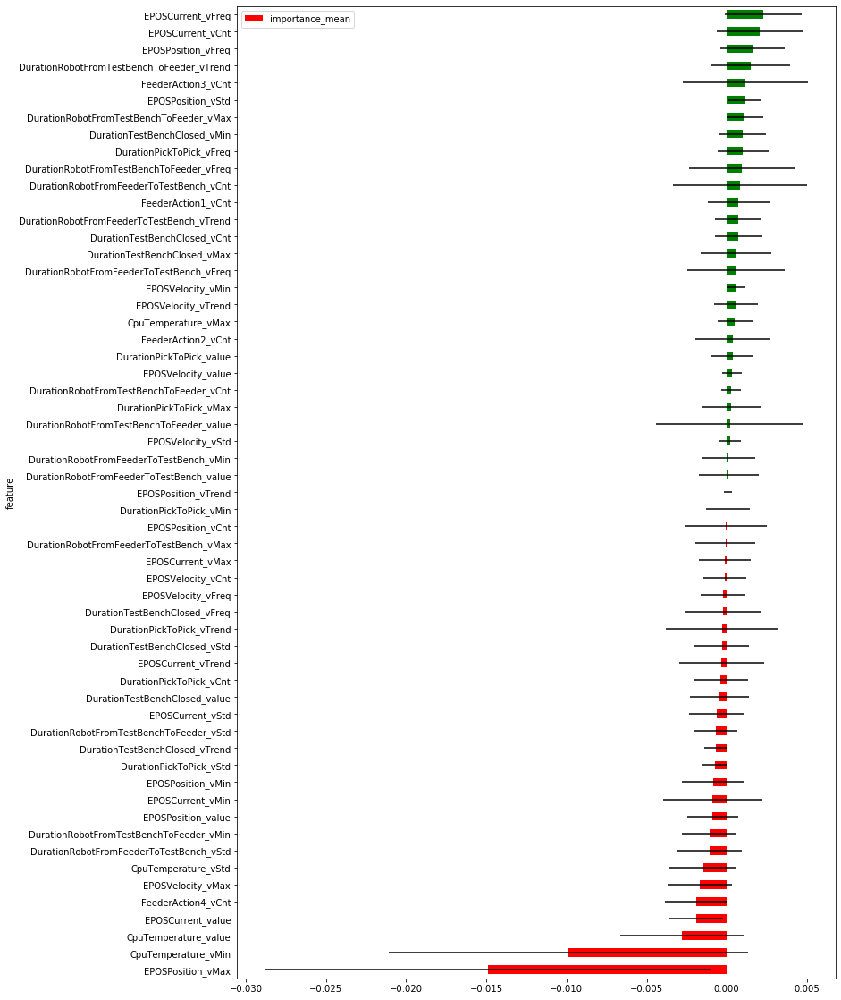

In [61]:
plot_importance(importance_df, figsize=(12, 20))